<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_9_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(9):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 52.6004 - IoU: 0.0263
Epoch 1: val_IoU improved from -inf to 0.00124, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 68ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


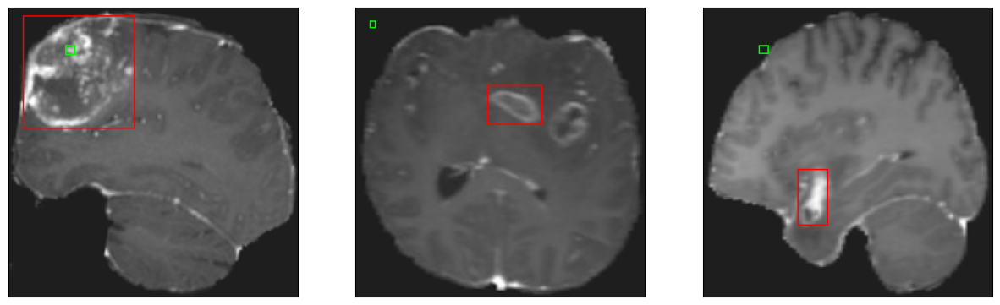

26/26 [==============================] - 33s 527ms/step - loss: 52.6004 - IoU: 0.0263 - val_loss: 52.2321 - val_IoU: 0.0012
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 27.3473 - IoU: 0.0673
Epoch 2: val_IoU improved from 0.00124 to 0.00602, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 13ms/step
4


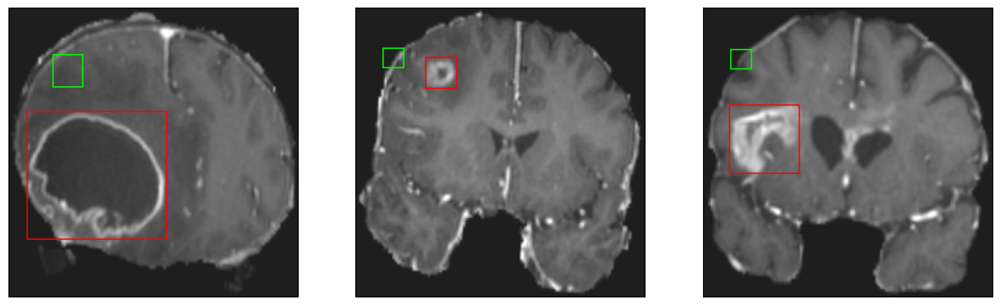

26/26 [==============================] - 11s 420ms/step - loss: 27.3473 - IoU: 0.0673 - val_loss: 46.8625 - val_IoU: 0.0060
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 24.1321 - IoU: 0.0953
Epoch 3: val_IoU improved from 0.00602 to 0.04408, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 19ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4


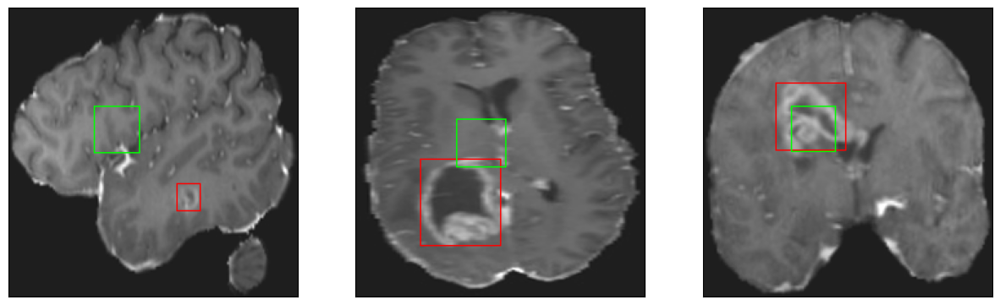

26/26 [==============================] - 5s 194ms/step - loss: 24.1321 - IoU: 0.0953 - val_loss: 32.5021 - val_IoU: 0.0441
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 21.3083 - IoU: 0.1447
Epoch 4: val_IoU did not improve from 0.04408
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


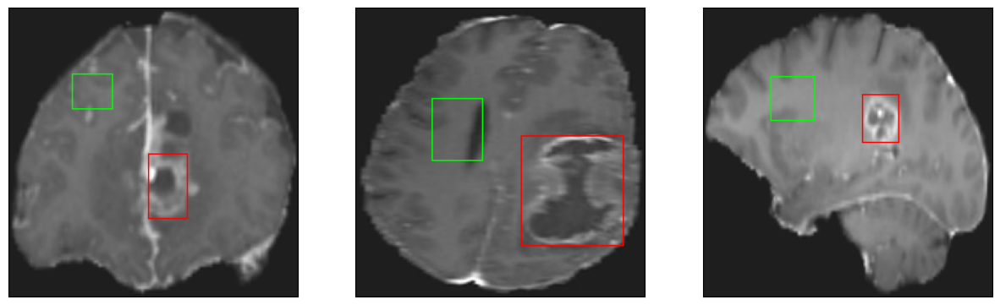

26/26 [==============================] - 3s 108ms/step - loss: 21.3083 - IoU: 0.1447 - val_loss: 35.9950 - val_IoU: 0.0307
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 20.6497 - IoU: 0.1597
Epoch 5: val_IoU improved from 0.04408 to 0.15285, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


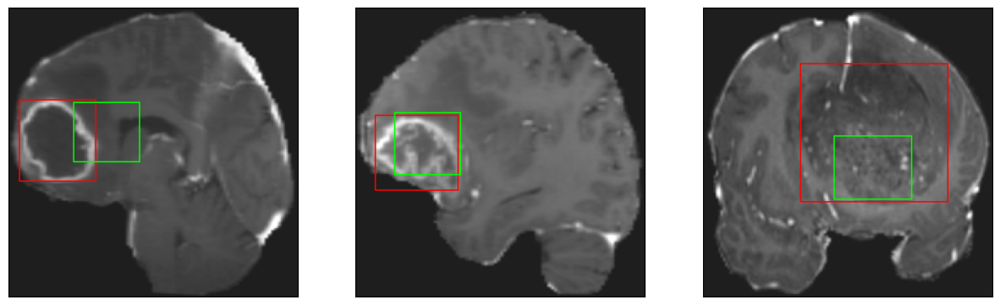

26/26 [==============================] - 4s 164ms/step - loss: 20.6497 - IoU: 0.1597 - val_loss: 23.7781 - val_IoU: 0.1528
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 18.8708 - IoU: 0.2066
Epoch 6: val_IoU improved from 0.15285 to 0.16617, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 19ms/step
4
8/8 [==============================] - 0s 20ms/step
4
8/8 [==============================] - 0s 15ms/step
4


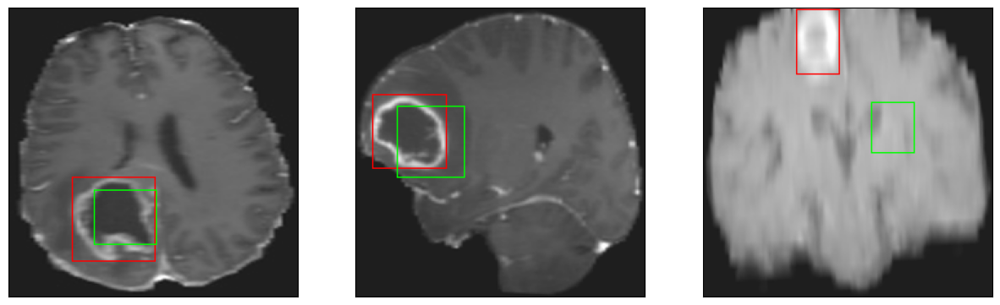

26/26 [==============================] - 5s 192ms/step - loss: 18.8708 - IoU: 0.2066 - val_loss: 20.3459 - val_IoU: 0.1662
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 17.5977 - IoU: 0.2175
Epoch 7: val_IoU did not improve from 0.16617
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


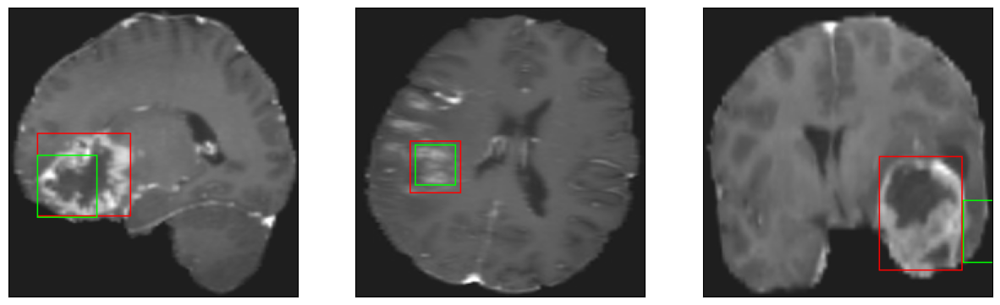

26/26 [==============================] - 3s 120ms/step - loss: 17.5977 - IoU: 0.2175 - val_loss: 19.9637 - val_IoU: 0.1406
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 16.9279 - IoU: 0.2394
Epoch 8: val_IoU did not improve from 0.16617
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


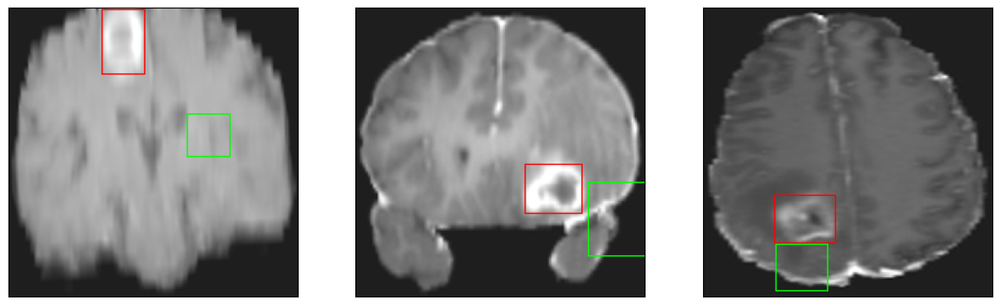

26/26 [==============================] - 3s 116ms/step - loss: 16.9279 - IoU: 0.2394 - val_loss: 22.2615 - val_IoU: 0.0955
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 15.2251 - IoU: 0.2676
Epoch 9: val_IoU did not improve from 0.16617
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4


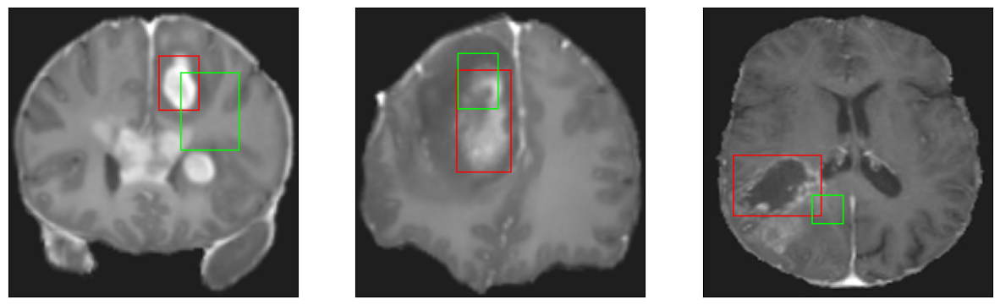

26/26 [==============================] - 3s 127ms/step - loss: 15.2251 - IoU: 0.2676 - val_loss: 19.7068 - val_IoU: 0.1536
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 14.7998 - IoU: 0.2808
Epoch 10: val_IoU improved from 0.16617 to 0.16741, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


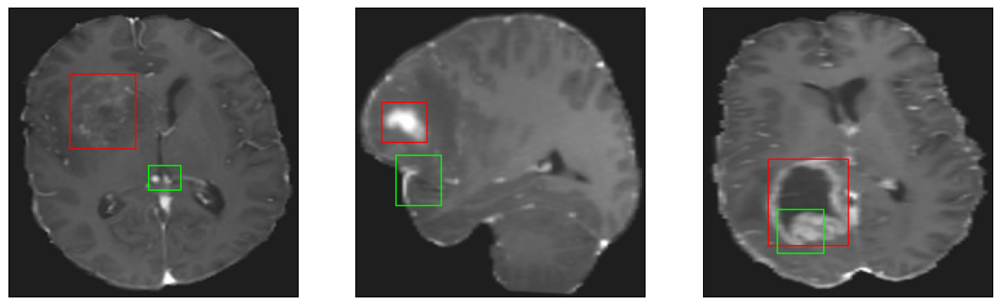

26/26 [==============================] - 9s 366ms/step - loss: 14.7998 - IoU: 0.2808 - val_loss: 18.7949 - val_IoU: 0.1674
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 14.4019 - IoU: 0.2946
Epoch 11: val_IoU improved from 0.16741 to 0.22892, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4


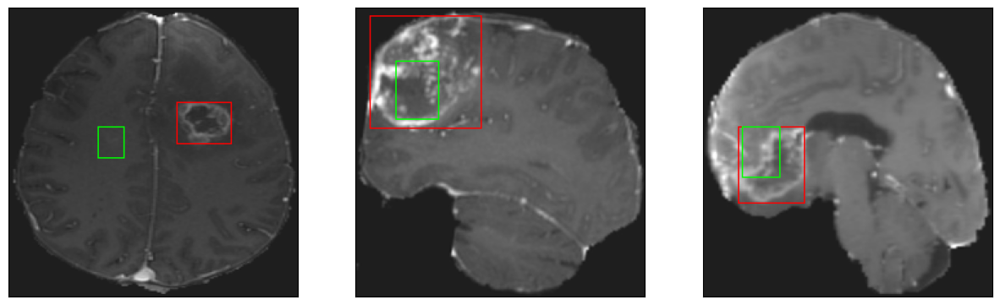

26/26 [==============================] - 5s 200ms/step - loss: 14.4019 - IoU: 0.2946 - val_loss: 16.0751 - val_IoU: 0.2289
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 15.0596 - IoU: 0.2792
Epoch 12: val_IoU did not improve from 0.22892
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


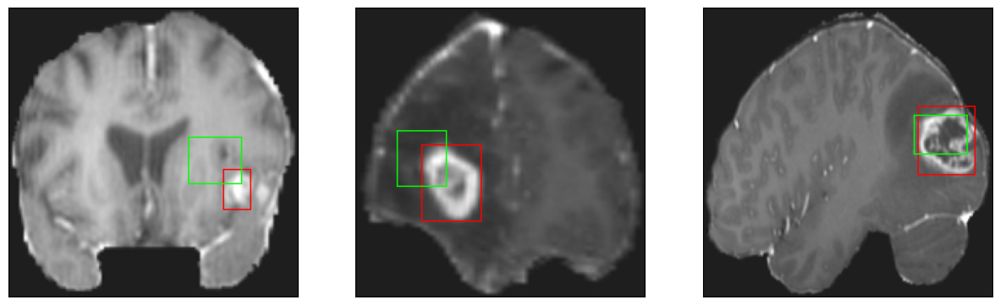

26/26 [==============================] - 3s 128ms/step - loss: 15.0596 - IoU: 0.2792 - val_loss: 19.9979 - val_IoU: 0.1594
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 13.2820 - IoU: 0.3171
Epoch 13: val_IoU improved from 0.22892 to 0.29405, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4


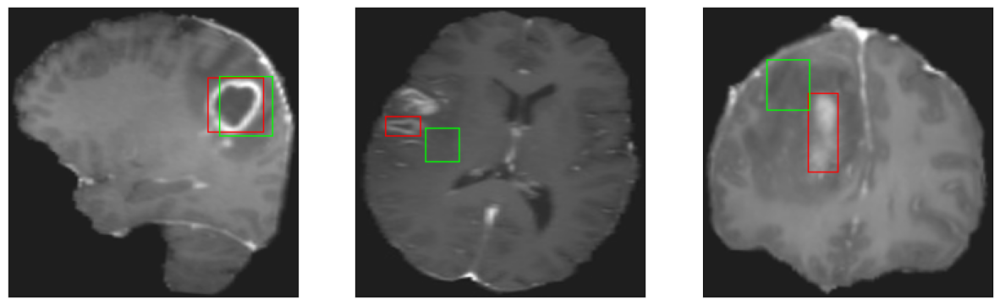

26/26 [==============================] - 8s 310ms/step - loss: 13.2820 - IoU: 0.3171 - val_loss: 14.6420 - val_IoU: 0.2940
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 15.7225 - IoU: 0.2784
Epoch 14: val_IoU improved from 0.29405 to 0.30020, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 14ms/step
4


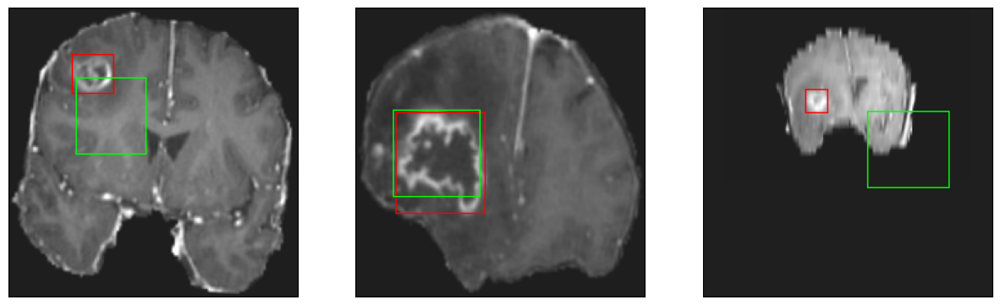

26/26 [==============================] - 5s 187ms/step - loss: 15.7225 - IoU: 0.2784 - val_loss: 16.5551 - val_IoU: 0.3002
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 13.7139 - IoU: 0.3090
Epoch 15: val_IoU improved from 0.30020 to 0.30321, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 17ms/step
4


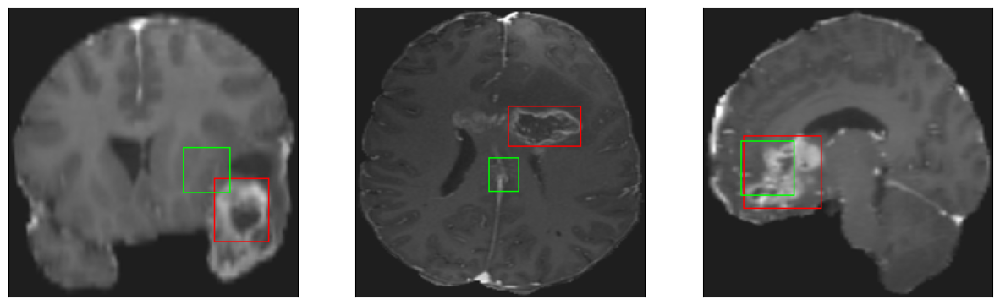

26/26 [==============================] - 7s 289ms/step - loss: 13.7139 - IoU: 0.3090 - val_loss: 14.4752 - val_IoU: 0.3032
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 13.6176 - IoU: 0.3178
Epoch 16: val_IoU improved from 0.30321 to 0.37265, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 22ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4


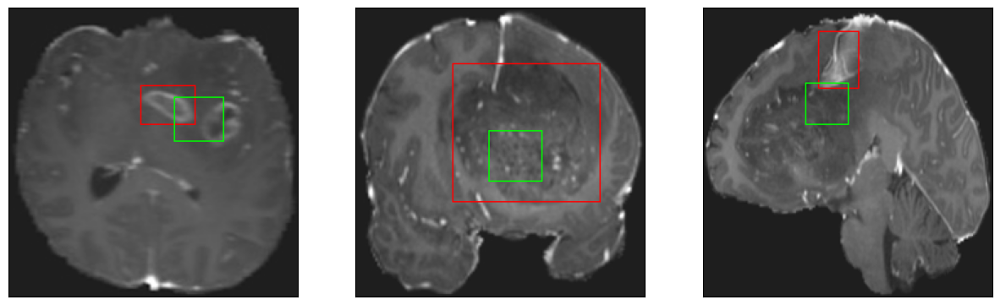

26/26 [==============================] - 9s 341ms/step - loss: 13.6176 - IoU: 0.3178 - val_loss: 12.2763 - val_IoU: 0.3727
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 13.1136 - IoU: 0.3309
Epoch 17: val_IoU did not improve from 0.37265
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


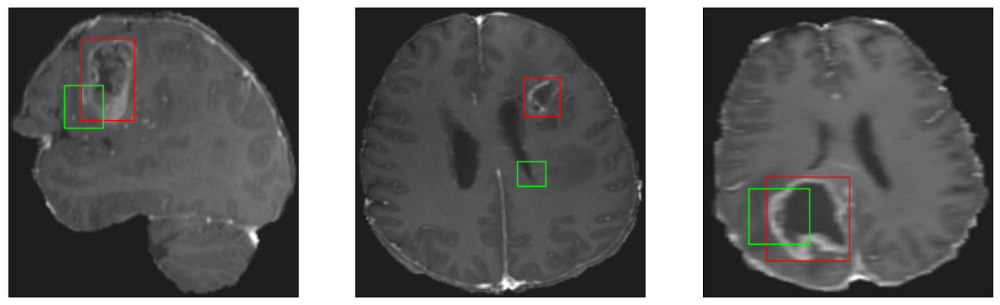

26/26 [==============================] - 3s 125ms/step - loss: 13.1136 - IoU: 0.3309 - val_loss: 15.0136 - val_IoU: 0.3248
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 11.5500 - IoU: 0.3687
Epoch 18: val_IoU did not improve from 0.37265
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4


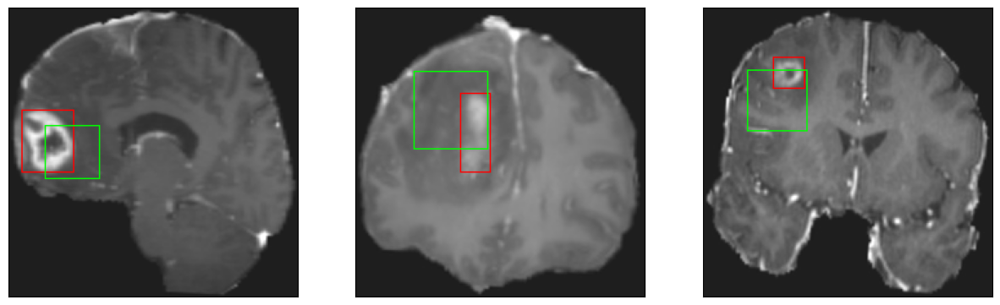

26/26 [==============================] - 4s 140ms/step - loss: 11.5500 - IoU: 0.3687 - val_loss: 12.8642 - val_IoU: 0.3647
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 12.0097 - IoU: 0.3510
Epoch 19: val_IoU improved from 0.37265 to 0.37474, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 19ms/step
4
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 17ms/step
4


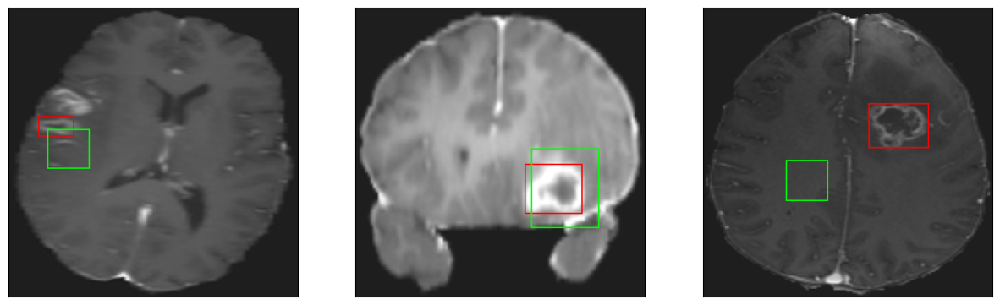

26/26 [==============================] - 5s 202ms/step - loss: 12.0097 - IoU: 0.3510 - val_loss: 12.4965 - val_IoU: 0.3747
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 11.7968 - IoU: 0.3600
Epoch 20: val_IoU did not improve from 0.37474
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


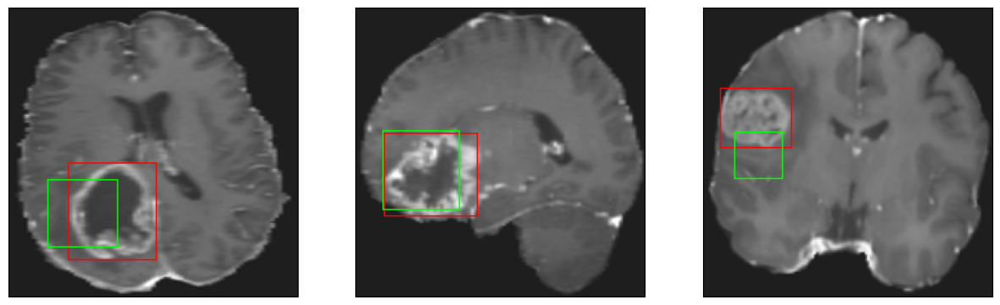

26/26 [==============================] - 3s 118ms/step - loss: 11.7968 - IoU: 0.3600 - val_loss: 16.7508 - val_IoU: 0.2110
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 13.0634 - IoU: 0.3325
Epoch 21: val_IoU did not improve from 0.37474
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


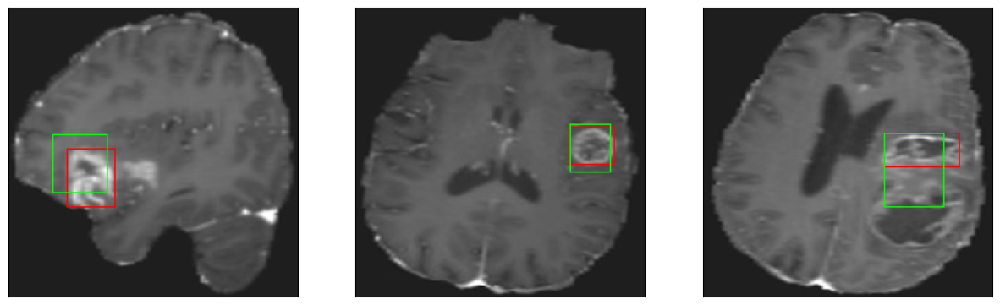

26/26 [==============================] - 3s 117ms/step - loss: 13.0634 - IoU: 0.3325 - val_loss: 15.6231 - val_IoU: 0.2855
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 13.5111 - IoU: 0.3071
Epoch 22: val_IoU improved from 0.37474 to 0.37658, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 15ms/step
4


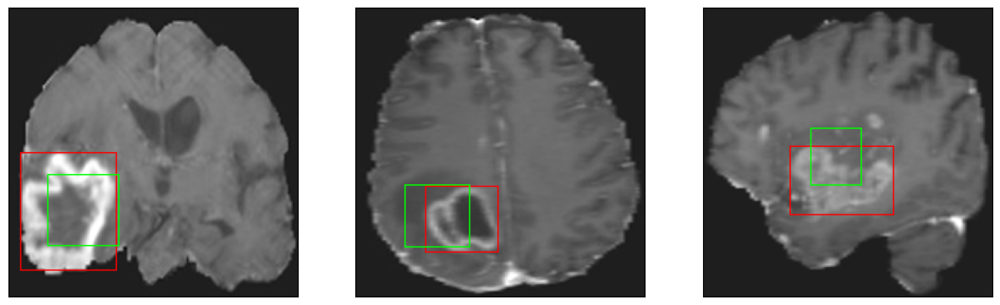

26/26 [==============================] - 7s 295ms/step - loss: 13.5111 - IoU: 0.3071 - val_loss: 13.2337 - val_IoU: 0.3766
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 12.4745 - IoU: 0.3399
Epoch 23: val_IoU did not improve from 0.37658
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


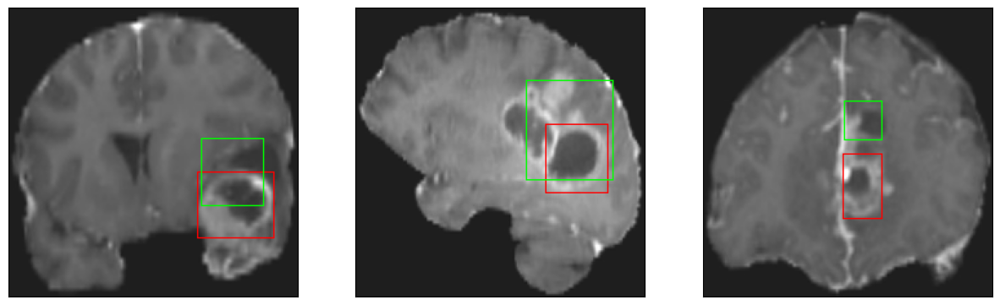

26/26 [==============================] - 3s 116ms/step - loss: 12.4745 - IoU: 0.3399 - val_loss: 15.1184 - val_IoU: 0.3141
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 11.8356 - IoU: 0.3563
Epoch 24: val_IoU improved from 0.37658 to 0.38070, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 20ms/step
4
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 16ms/step
4


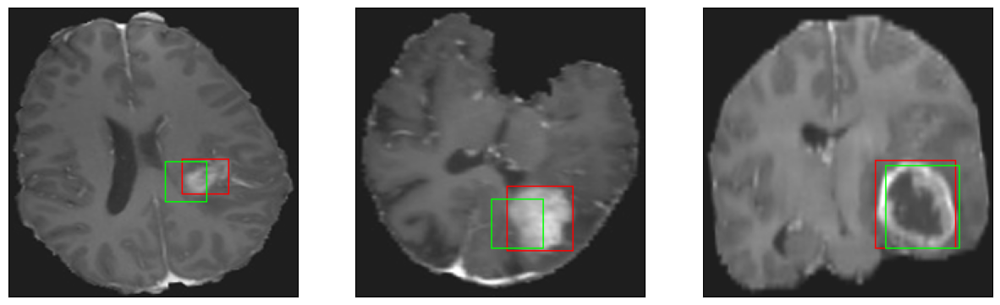

26/26 [==============================] - 5s 203ms/step - loss: 11.8356 - IoU: 0.3563 - val_loss: 12.2559 - val_IoU: 0.3807
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 11.2306 - IoU: 0.3644
Epoch 25: val_IoU did not improve from 0.38070
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4


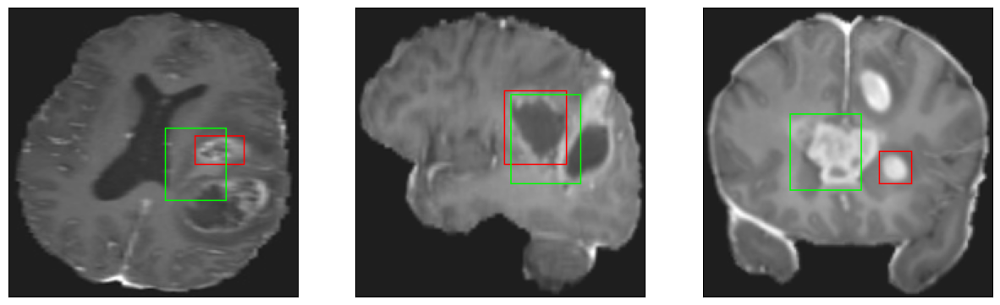

26/26 [==============================] - 4s 144ms/step - loss: 11.2306 - IoU: 0.3644 - val_loss: 11.9300 - val_IoU: 0.3438
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 11.3327 - IoU: 0.3669
Epoch 26: val_IoU did not improve from 0.38070
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 15ms/step
4


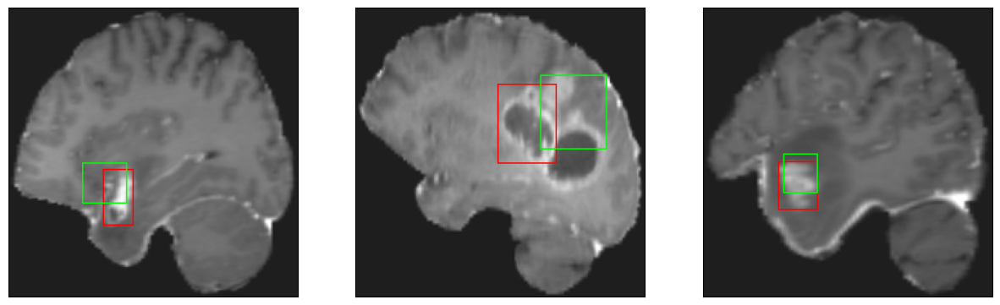

26/26 [==============================] - 3s 130ms/step - loss: 11.3327 - IoU: 0.3669 - val_loss: 13.4969 - val_IoU: 0.3230
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 11.0607 - IoU: 0.3688
Epoch 27: val_IoU improved from 0.38070 to 0.42854, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


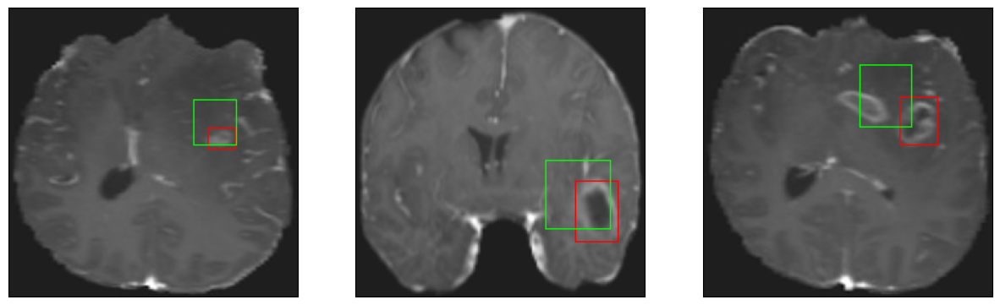

26/26 [==============================] - 5s 185ms/step - loss: 11.0607 - IoU: 0.3688 - val_loss: 10.8721 - val_IoU: 0.4285
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 11.0198 - IoU: 0.3760
Epoch 28: val_IoU did not improve from 0.42854
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


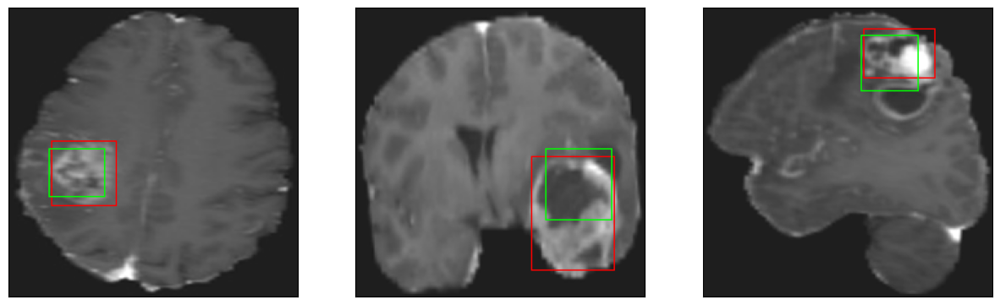

26/26 [==============================] - 4s 138ms/step - loss: 11.0198 - IoU: 0.3760 - val_loss: 11.6998 - val_IoU: 0.3916
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 10.6212 - IoU: 0.3889
Epoch 29: val_IoU improved from 0.42854 to 0.44186, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 16ms/step
4


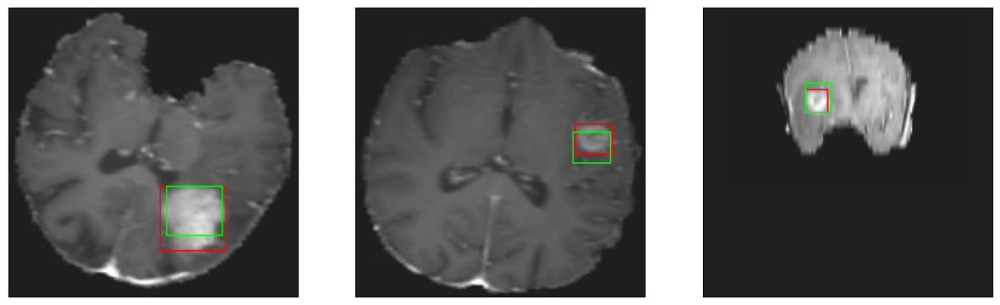

26/26 [==============================] - 7s 272ms/step - loss: 10.6212 - IoU: 0.3889 - val_loss: 10.3170 - val_IoU: 0.4419
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 10.1817 - IoU: 0.3956
Epoch 30: val_IoU did not improve from 0.44186
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


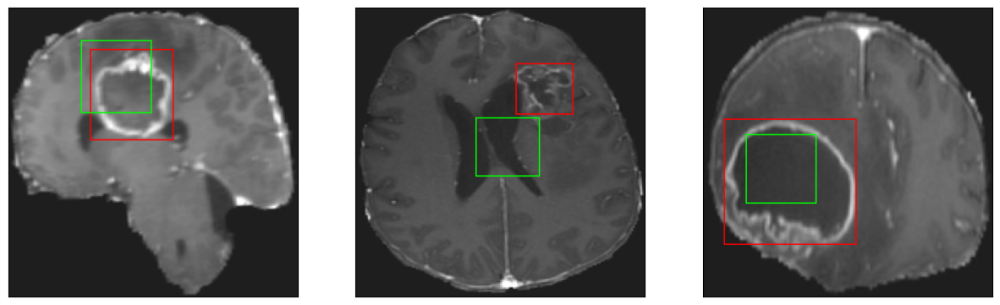

26/26 [==============================] - 4s 136ms/step - loss: 10.1817 - IoU: 0.3956 - val_loss: 12.6862 - val_IoU: 0.3478
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 10.4622 - IoU: 0.3919
Epoch 31: val_IoU did not improve from 0.44186
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


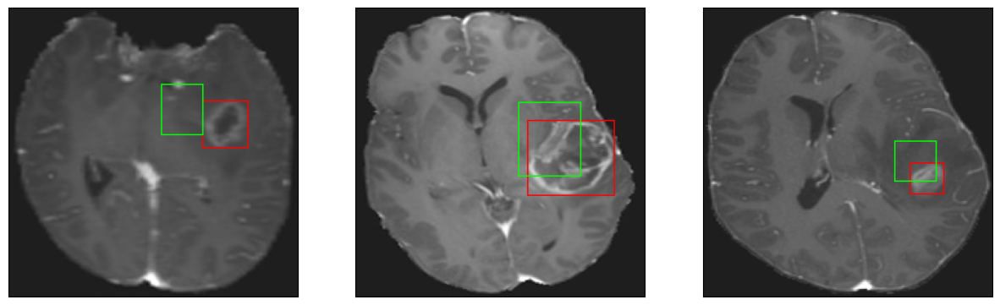

26/26 [==============================] - 4s 154ms/step - loss: 10.4622 - IoU: 0.3919 - val_loss: 15.0614 - val_IoU: 0.2408
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 9.5682 - IoU: 0.4167
Epoch 32: val_IoU did not improve from 0.44186
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


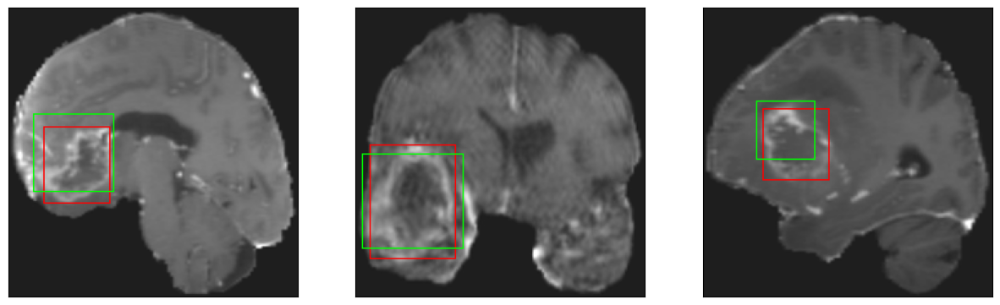

26/26 [==============================] - 3s 123ms/step - loss: 9.5682 - IoU: 0.4167 - val_loss: 10.8757 - val_IoU: 0.4166
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 9.9065 - IoU: 0.4070
Epoch 33: val_IoU did not improve from 0.44186
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


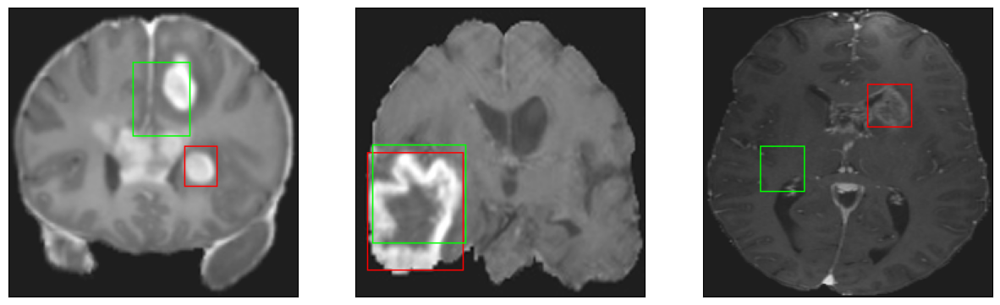

26/26 [==============================] - 4s 139ms/step - loss: 9.9065 - IoU: 0.4070 - val_loss: 10.7863 - val_IoU: 0.4329
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 10.0576 - IoU: 0.4011
Epoch 34: val_IoU did not improve from 0.44186
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


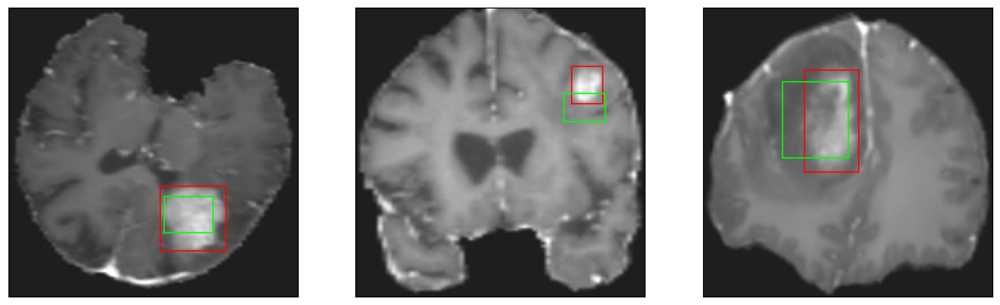

26/26 [==============================] - 3s 130ms/step - loss: 10.0576 - IoU: 0.4011 - val_loss: 11.4967 - val_IoU: 0.3838
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 10.0606 - IoU: 0.3969
Epoch 35: val_IoU did not improve from 0.44186
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


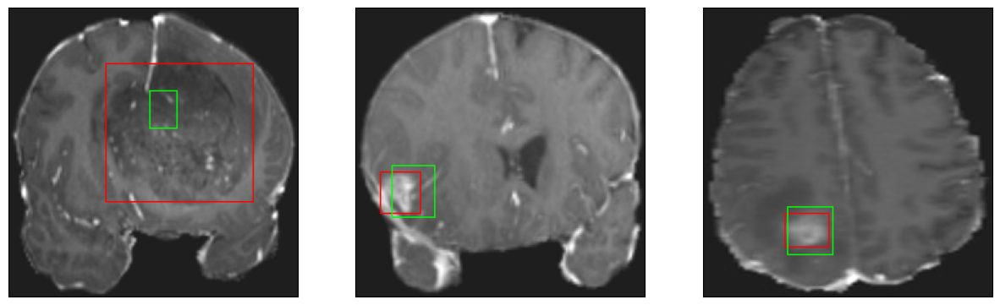

26/26 [==============================] - 3s 128ms/step - loss: 10.0606 - IoU: 0.3969 - val_loss: 14.8725 - val_IoU: 0.2632
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 9.1026 - IoU: 0.4455
Epoch 36: val_IoU did not improve from 0.44186
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4


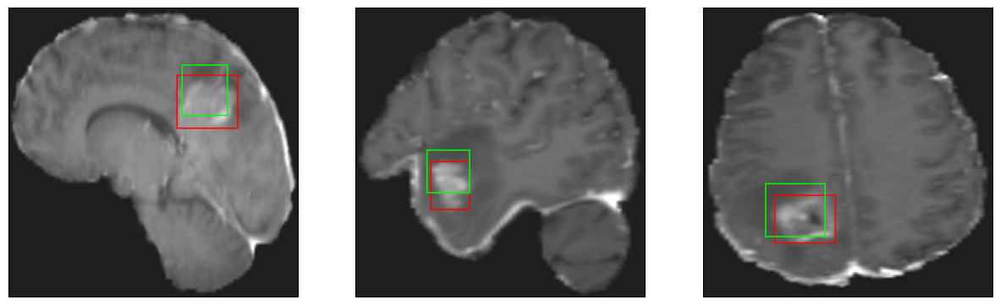

26/26 [==============================] - 4s 148ms/step - loss: 9.1026 - IoU: 0.4455 - val_loss: 11.8214 - val_IoU: 0.3482
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 9.7036 - IoU: 0.4307
Epoch 37: val_IoU did not improve from 0.44186
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


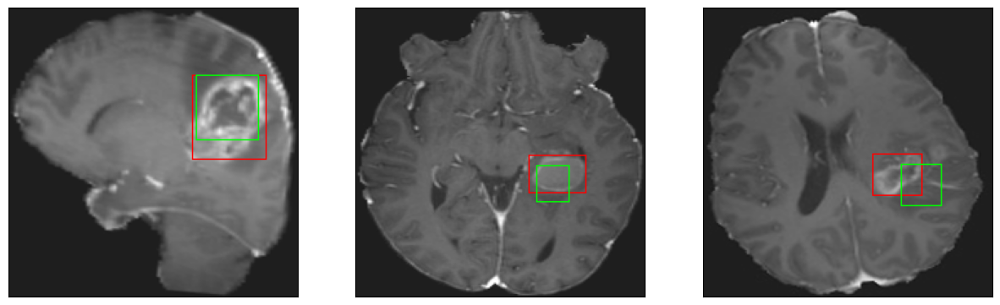

26/26 [==============================] - 3s 131ms/step - loss: 9.7036 - IoU: 0.4307 - val_loss: 10.6162 - val_IoU: 0.4312
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 9.6093 - IoU: 0.4305
Epoch 38: val_IoU did not improve from 0.44186
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


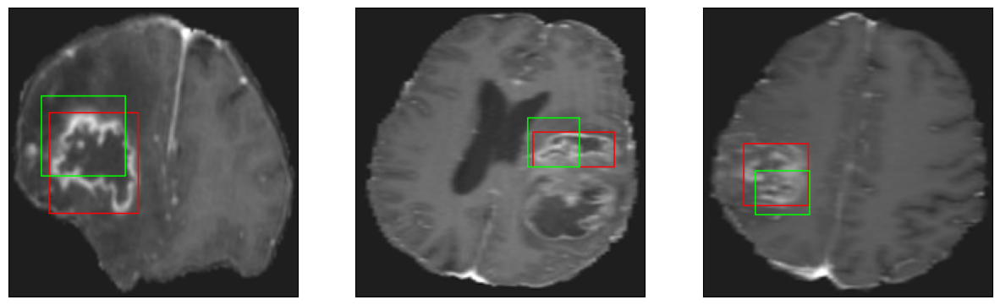

26/26 [==============================] - 3s 124ms/step - loss: 9.6093 - IoU: 0.4305 - val_loss: 12.8198 - val_IoU: 0.3489
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 9.2079 - IoU: 0.4362
Epoch 39: val_IoU improved from 0.44186 to 0.47174, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 21ms/step
4
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 17ms/step
4


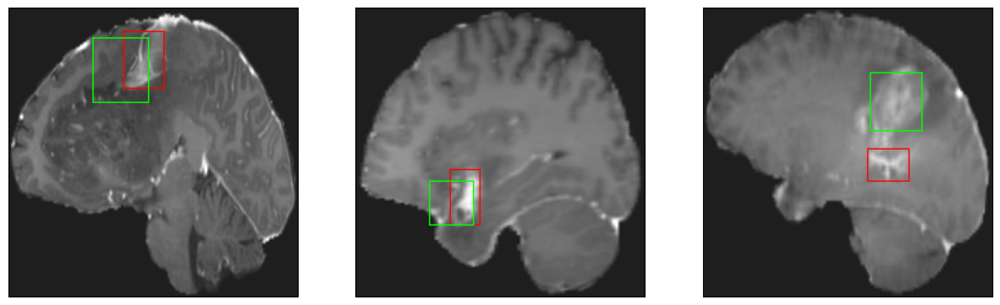

26/26 [==============================] - 14s 561ms/step - loss: 9.2079 - IoU: 0.4362 - val_loss: 10.1686 - val_IoU: 0.4717
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 9.1421 - IoU: 0.4384
Epoch 40: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


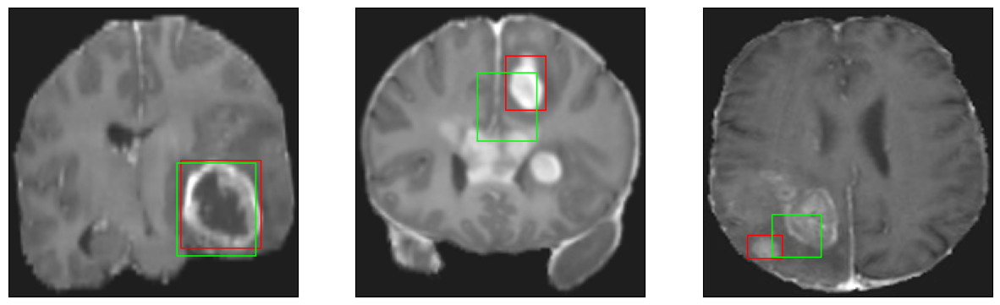

26/26 [==============================] - 3s 131ms/step - loss: 9.1421 - IoU: 0.4384 - val_loss: 10.2082 - val_IoU: 0.4666
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 8.8703 - IoU: 0.4546
Epoch 41: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 11ms/step
4


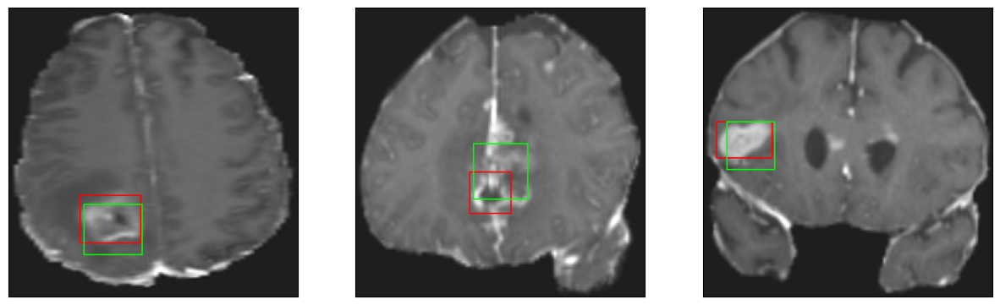

26/26 [==============================] - 3s 132ms/step - loss: 8.8703 - IoU: 0.4546 - val_loss: 10.3721 - val_IoU: 0.4462
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 9.1048 - IoU: 0.4365
Epoch 42: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


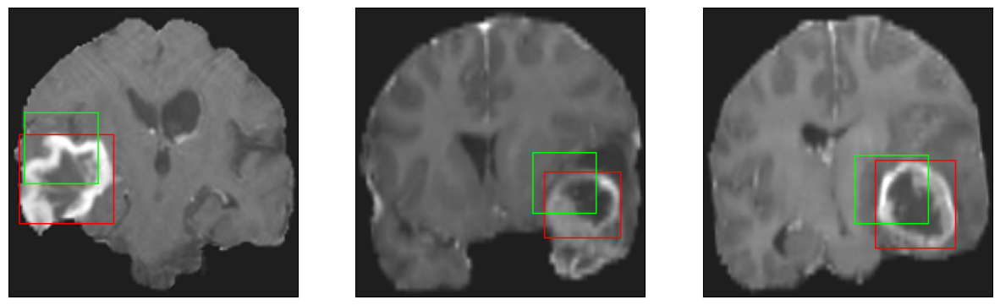

26/26 [==============================] - 4s 140ms/step - loss: 9.1048 - IoU: 0.4365 - val_loss: 14.7109 - val_IoU: 0.2455
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 9.2733 - IoU: 0.4255
Epoch 43: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


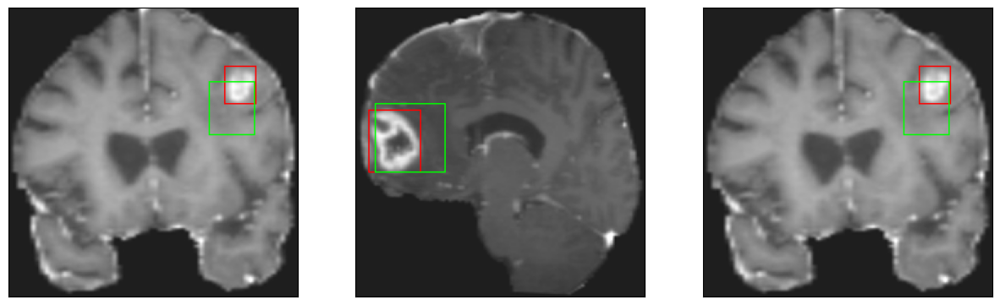

26/26 [==============================] - 3s 128ms/step - loss: 9.2733 - IoU: 0.4255 - val_loss: 9.8982 - val_IoU: 0.4602
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 8.7945 - IoU: 0.4587
Epoch 44: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


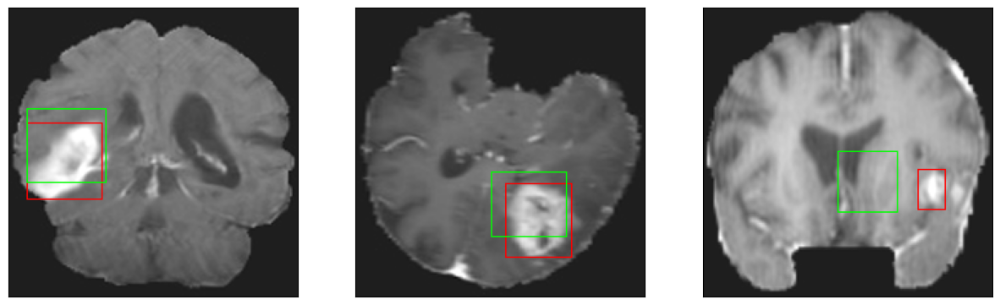

26/26 [==============================] - 3s 123ms/step - loss: 8.7945 - IoU: 0.4587 - val_loss: 10.6358 - val_IoU: 0.4559
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 8.9956 - IoU: 0.4359
Epoch 45: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


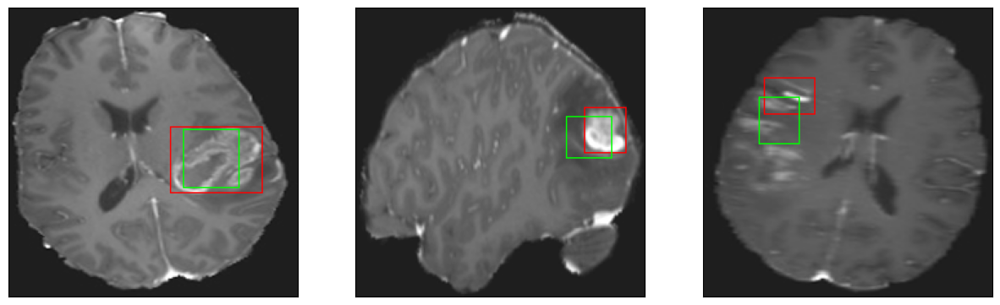

26/26 [==============================] - 3s 125ms/step - loss: 8.9956 - IoU: 0.4359 - val_loss: 12.1717 - val_IoU: 0.3551
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 9.1869 - IoU: 0.4345
Epoch 46: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


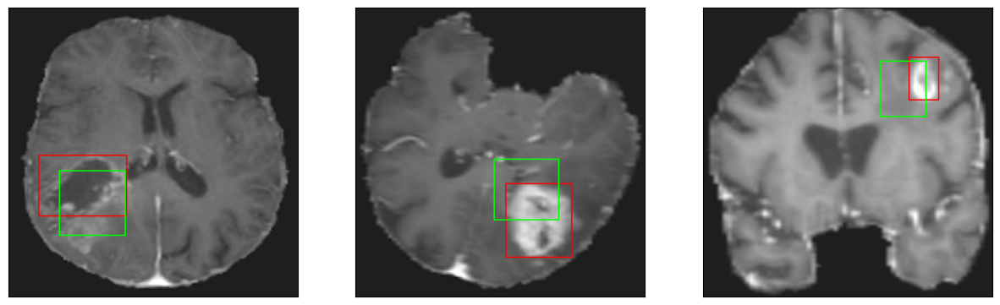

26/26 [==============================] - 3s 134ms/step - loss: 9.1869 - IoU: 0.4345 - val_loss: 11.6636 - val_IoU: 0.3867
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 9.7064 - IoU: 0.3987
Epoch 47: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


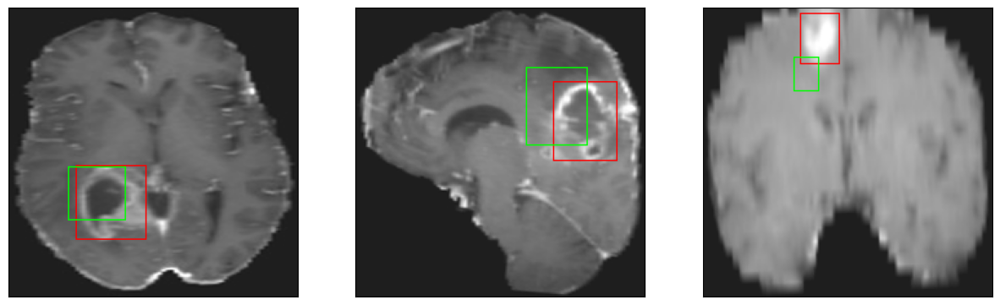

26/26 [==============================] - 3s 122ms/step - loss: 9.7064 - IoU: 0.3987 - val_loss: 14.6084 - val_IoU: 0.2794
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 9.4564 - IoU: 0.4382
Epoch 48: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


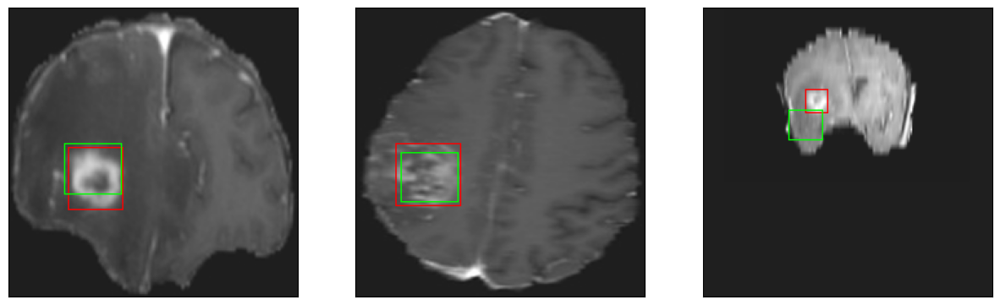

26/26 [==============================] - 3s 123ms/step - loss: 9.4564 - IoU: 0.4382 - val_loss: 11.9336 - val_IoU: 0.3667
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 8.8504 - IoU: 0.4419
Epoch 49: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 18ms/step
4


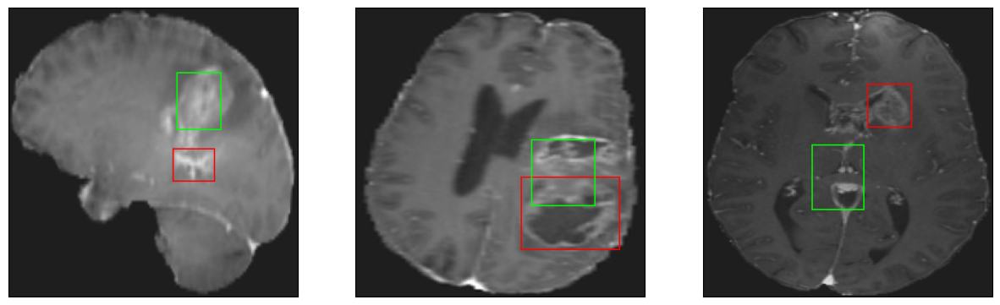

26/26 [==============================] - 4s 140ms/step - loss: 8.8504 - IoU: 0.4419 - val_loss: 10.4304 - val_IoU: 0.4312
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 8.8462 - IoU: 0.4431
Epoch 50: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


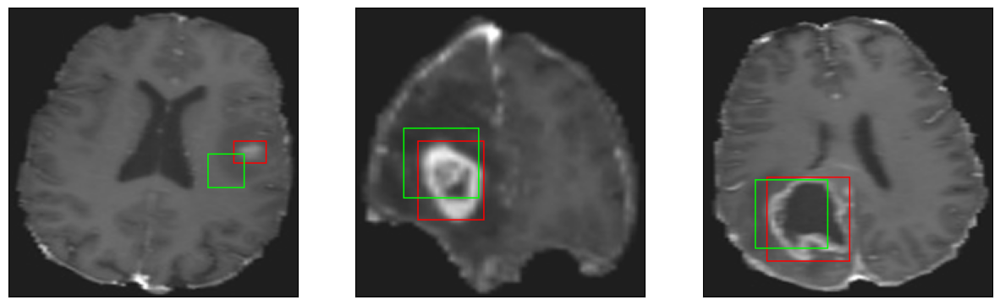

26/26 [==============================] - 3s 121ms/step - loss: 8.8462 - IoU: 0.4431 - val_loss: 10.3271 - val_IoU: 0.4607
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 8.7393 - IoU: 0.4509
Epoch 51: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


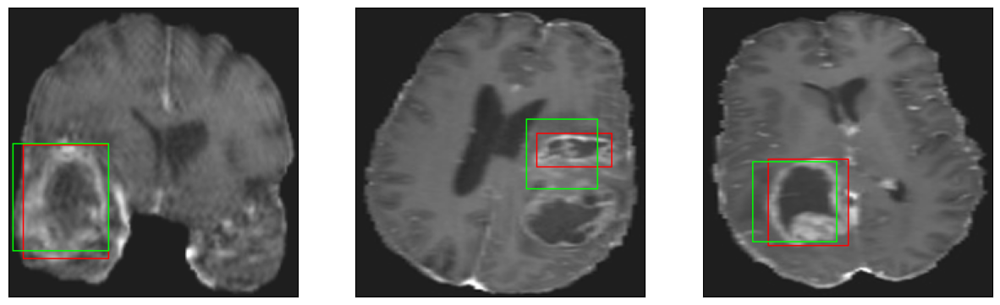

26/26 [==============================] - 3s 123ms/step - loss: 8.7393 - IoU: 0.4509 - val_loss: 10.2110 - val_IoU: 0.4462
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 8.8388 - IoU: 0.4386
Epoch 52: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 17ms/step
4


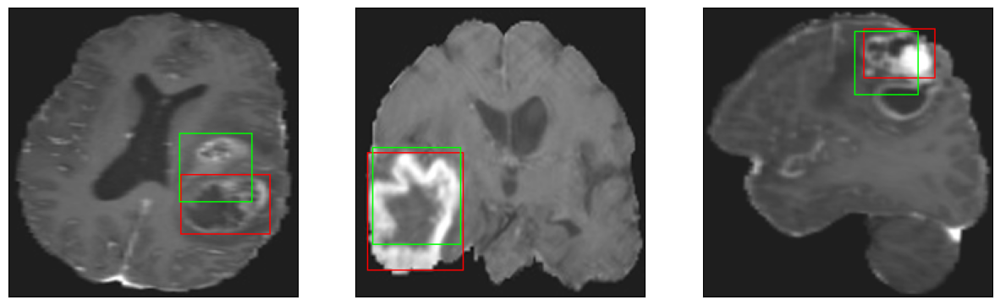

26/26 [==============================] - 3s 135ms/step - loss: 8.8388 - IoU: 0.4386 - val_loss: 10.1706 - val_IoU: 0.4665
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 9.0175 - IoU: 0.4276
Epoch 53: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 15ms/step
4


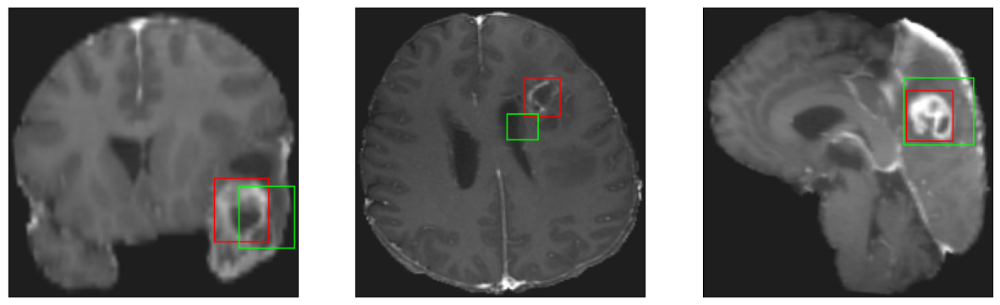

26/26 [==============================] - 4s 139ms/step - loss: 9.0175 - IoU: 0.4276 - val_loss: 10.9742 - val_IoU: 0.4170
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 8.8633 - IoU: 0.4447
Epoch 54: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


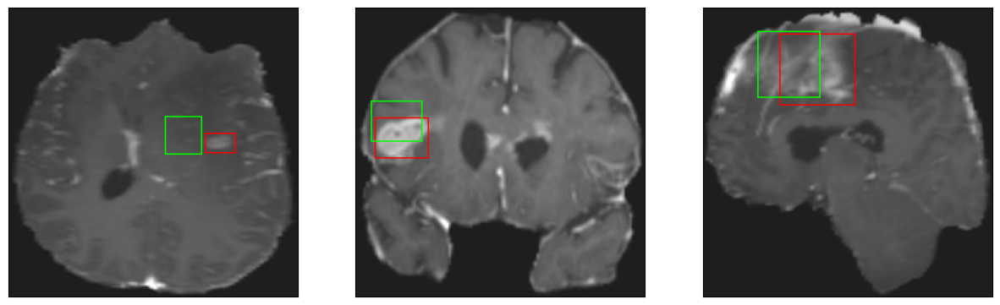

26/26 [==============================] - 3s 126ms/step - loss: 8.8633 - IoU: 0.4447 - val_loss: 12.1405 - val_IoU: 0.3478
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 8.5821 - IoU: 0.4545
Epoch 55: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


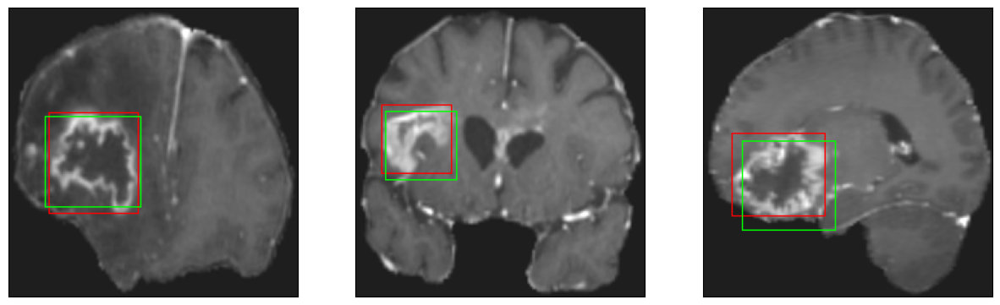

26/26 [==============================] - 3s 130ms/step - loss: 8.5821 - IoU: 0.4545 - val_loss: 9.8348 - val_IoU: 0.4538
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 8.7397 - IoU: 0.4457
Epoch 56: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


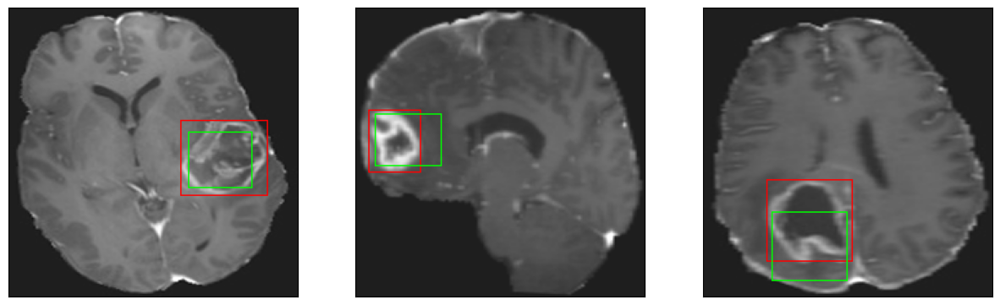

26/26 [==============================] - 4s 138ms/step - loss: 8.7397 - IoU: 0.4457 - val_loss: 9.9769 - val_IoU: 0.4395
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 8.0192 - IoU: 0.4677
Epoch 57: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


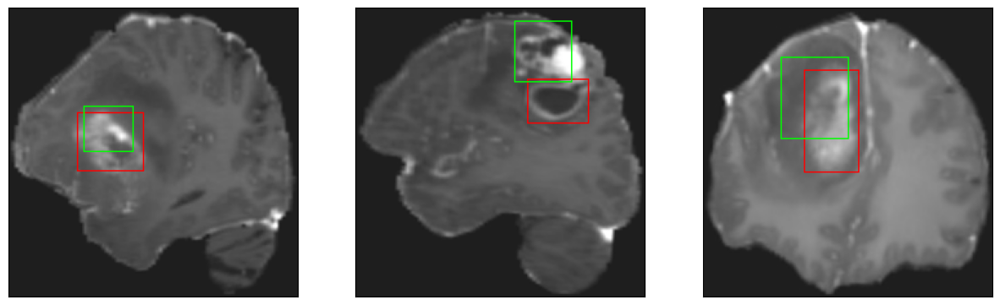

26/26 [==============================] - 3s 124ms/step - loss: 8.0192 - IoU: 0.4677 - val_loss: 10.8587 - val_IoU: 0.4143
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 8.2028 - IoU: 0.4659
Epoch 58: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


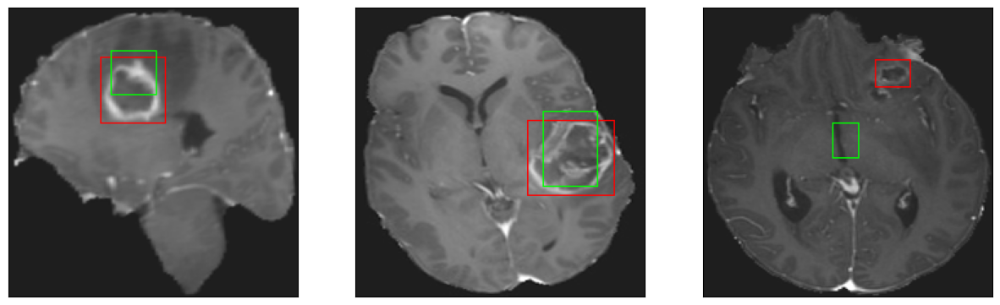

26/26 [==============================] - 3s 125ms/step - loss: 8.2028 - IoU: 0.4659 - val_loss: 12.8475 - val_IoU: 0.3579
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 8.0604 - IoU: 0.4769
Epoch 59: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4


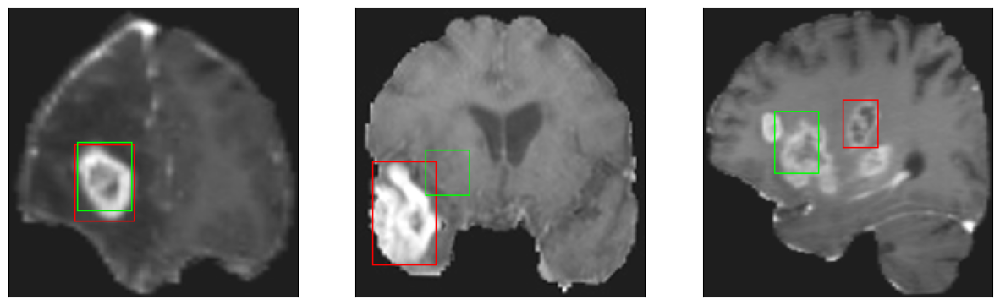

26/26 [==============================] - 4s 162ms/step - loss: 8.0604 - IoU: 0.4769 - val_loss: 10.2359 - val_IoU: 0.4586
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 8.4114 - IoU: 0.4529
Epoch 60: val_IoU did not improve from 0.47174
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


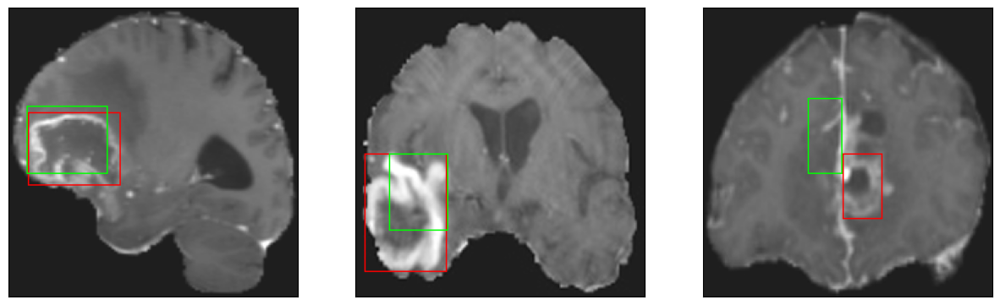

26/26 [==============================] - 3s 127ms/step - loss: 8.4114 - IoU: 0.4529 - val_loss: 10.0690 - val_IoU: 0.4341
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 8.1061 - IoU: 0.4637
Epoch 61: val_IoU improved from 0.47174 to 0.47591, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 15ms/step
4


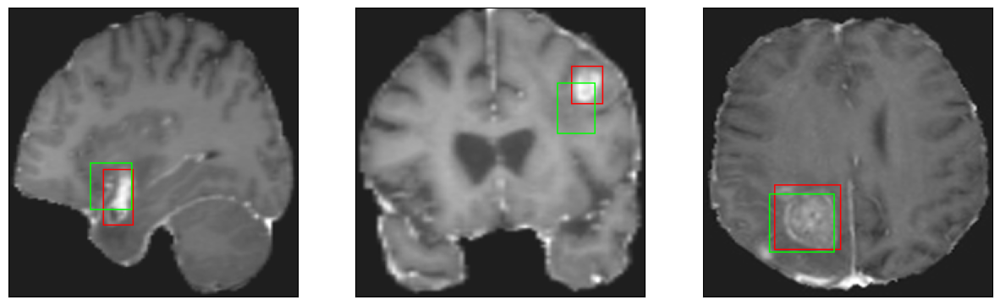

26/26 [==============================] - 7s 257ms/step - loss: 8.1061 - IoU: 0.4637 - val_loss: 9.3972 - val_IoU: 0.4759
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 7.6539 - IoU: 0.4902
Epoch 62: val_IoU did not improve from 0.47591
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


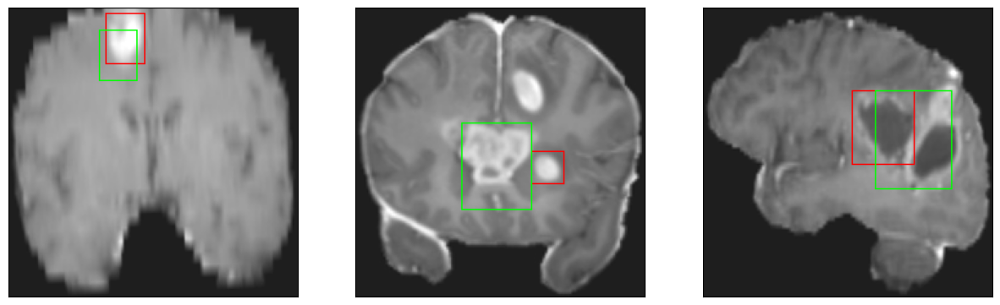

26/26 [==============================] - 3s 125ms/step - loss: 7.6539 - IoU: 0.4902 - val_loss: 9.7643 - val_IoU: 0.4555
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 7.6687 - IoU: 0.4909
Epoch 63: val_IoU did not improve from 0.47591
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


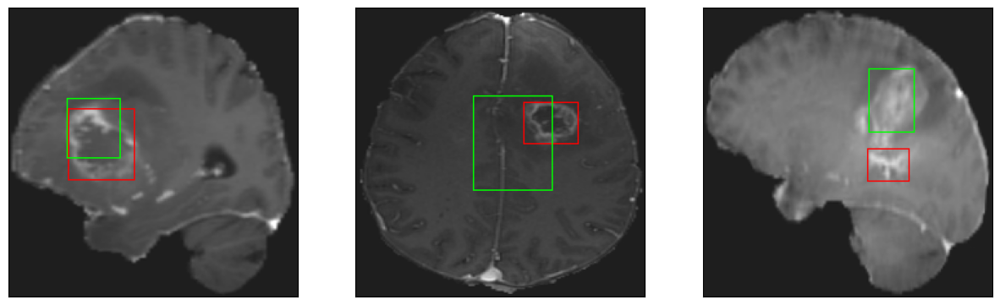

26/26 [==============================] - 4s 156ms/step - loss: 7.6687 - IoU: 0.4909 - val_loss: 9.7801 - val_IoU: 0.4603
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 7.9196 - IoU: 0.4749
Epoch 64: val_IoU did not improve from 0.47591
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


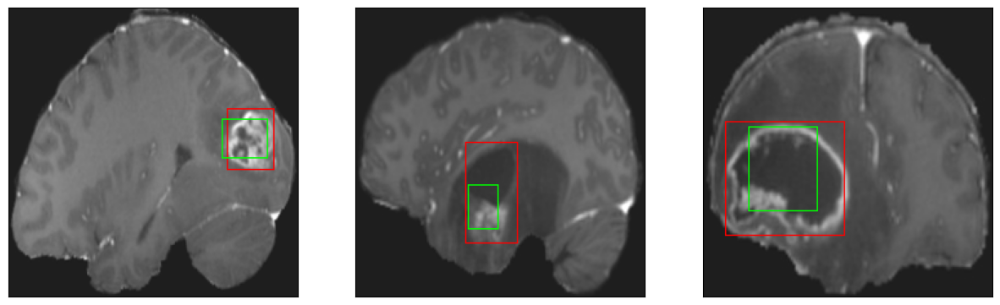

26/26 [==============================] - 3s 130ms/step - loss: 7.9196 - IoU: 0.4749 - val_loss: 10.6172 - val_IoU: 0.4465
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 8.3069 - IoU: 0.4533
Epoch 65: val_IoU did not improve from 0.47591
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


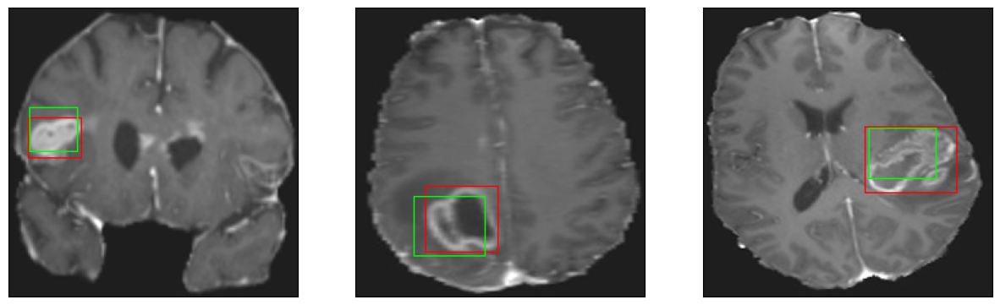

26/26 [==============================] - 4s 137ms/step - loss: 8.3069 - IoU: 0.4533 - val_loss: 9.6677 - val_IoU: 0.4660
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 8.1001 - IoU: 0.4656
Epoch 66: val_IoU did not improve from 0.47591
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


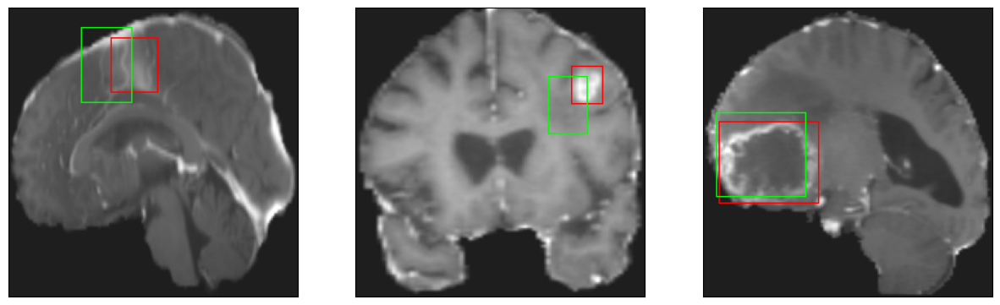

26/26 [==============================] - 3s 128ms/step - loss: 8.1001 - IoU: 0.4656 - val_loss: 11.2564 - val_IoU: 0.3909
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 7.6439 - IoU: 0.4814
Epoch 67: val_IoU did not improve from 0.47591
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


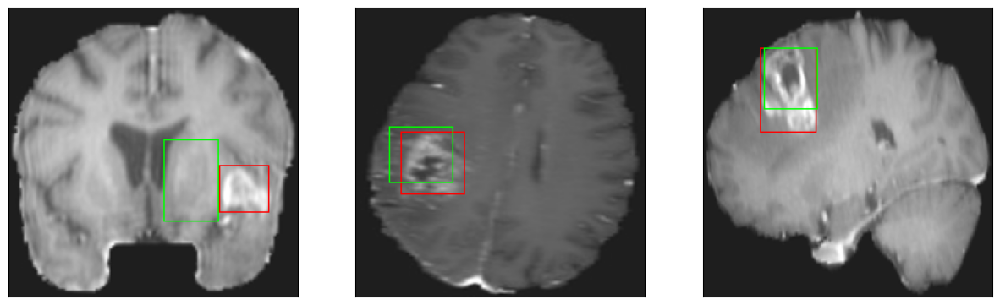

26/26 [==============================] - 3s 130ms/step - loss: 7.6439 - IoU: 0.4814 - val_loss: 11.2611 - val_IoU: 0.4203
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 8.2276 - IoU: 0.4486
Epoch 68: val_IoU did not improve from 0.47591
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4


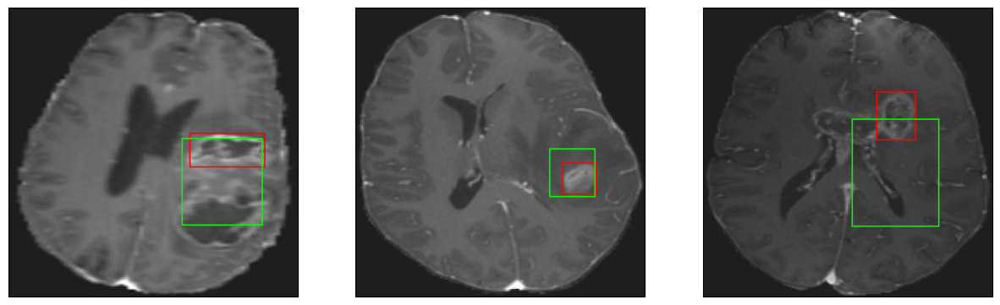

26/26 [==============================] - 4s 147ms/step - loss: 8.2276 - IoU: 0.4486 - val_loss: 10.1983 - val_IoU: 0.4521
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 8.0945 - IoU: 0.4754
Epoch 69: val_IoU improved from 0.47591 to 0.47874, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


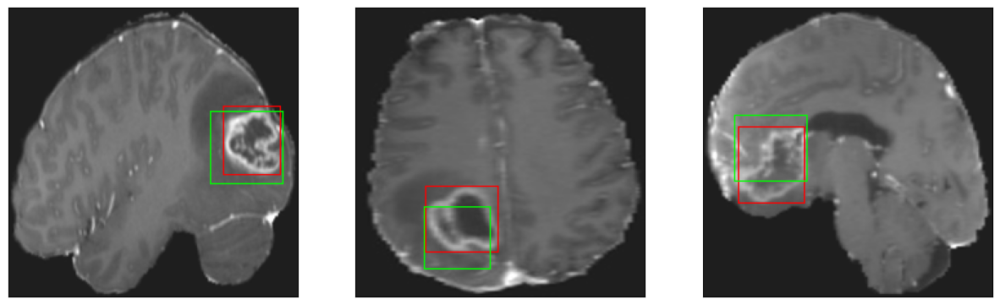

26/26 [==============================] - 9s 354ms/step - loss: 8.0945 - IoU: 0.4754 - val_loss: 9.4441 - val_IoU: 0.4787
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 8.2426 - IoU: 0.4575
Epoch 70: val_IoU did not improve from 0.47874
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


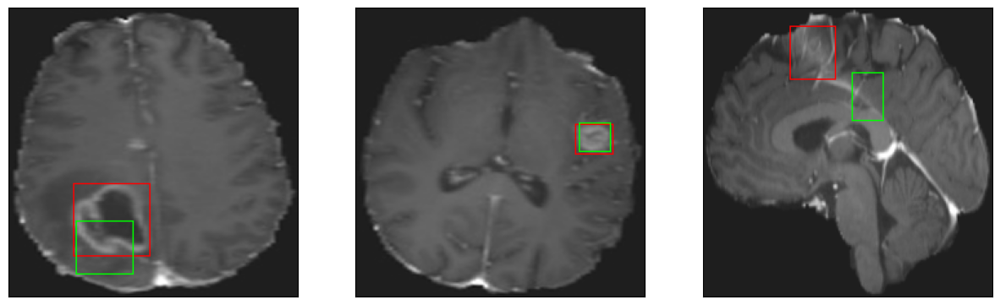

26/26 [==============================] - 3s 132ms/step - loss: 8.2426 - IoU: 0.4575 - val_loss: 11.0100 - val_IoU: 0.4164
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 8.0061 - IoU: 0.4576
Epoch 71: val_IoU did not improve from 0.47874
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


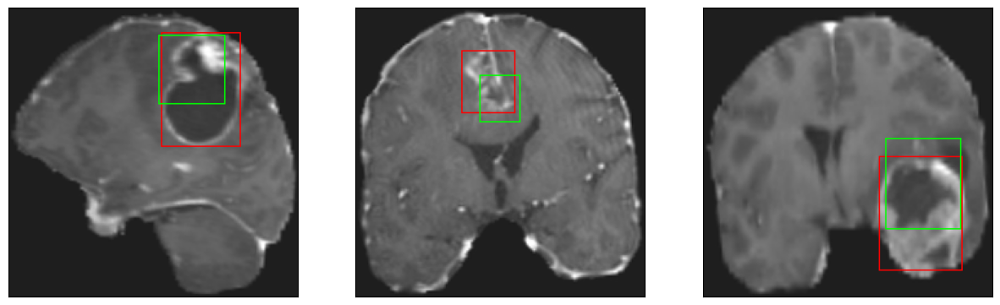

26/26 [==============================] - 4s 151ms/step - loss: 8.0061 - IoU: 0.4576 - val_loss: 9.8963 - val_IoU: 0.4715
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 7.7277 - IoU: 0.4777
Epoch 72: val_IoU did not improve from 0.47874
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 14ms/step
4


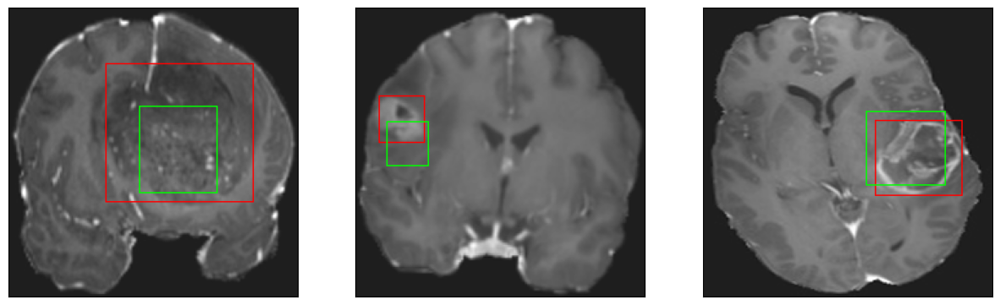

26/26 [==============================] - 3s 126ms/step - loss: 7.7277 - IoU: 0.4777 - val_loss: 10.6834 - val_IoU: 0.4569
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 7.8531 - IoU: 0.4758
Epoch 73: val_IoU did not improve from 0.47874
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


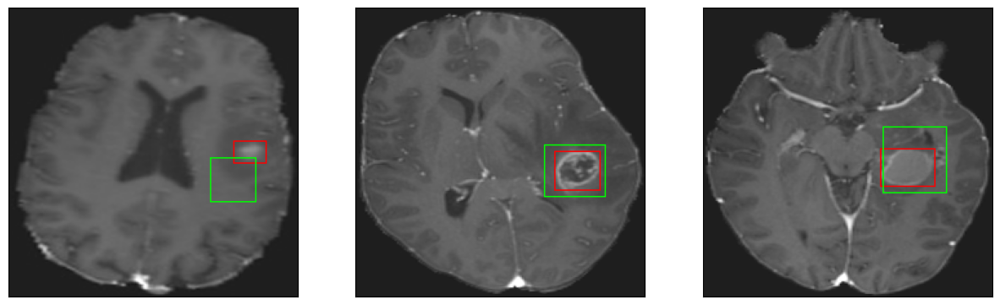

26/26 [==============================] - 3s 131ms/step - loss: 7.8531 - IoU: 0.4758 - val_loss: 11.5951 - val_IoU: 0.4410
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 7.2521 - IoU: 0.5090
Epoch 74: val_IoU improved from 0.47874 to 0.49474, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 16ms/step
4


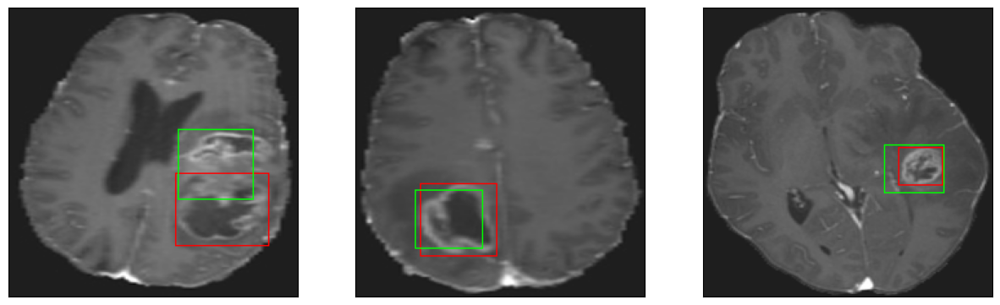

26/26 [==============================] - 7s 284ms/step - loss: 7.2521 - IoU: 0.5090 - val_loss: 9.7658 - val_IoU: 0.4947
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 7.4750 - IoU: 0.4905
Epoch 75: val_IoU did not improve from 0.49474
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


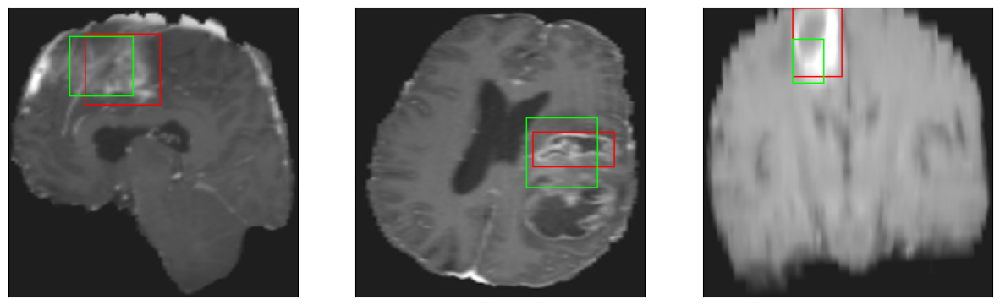

26/26 [==============================] - 3s 124ms/step - loss: 7.4750 - IoU: 0.4905 - val_loss: 9.4128 - val_IoU: 0.4776
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 7.0370 - IoU: 0.5093
Epoch 76: val_IoU did not improve from 0.49474
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 18ms/step
4


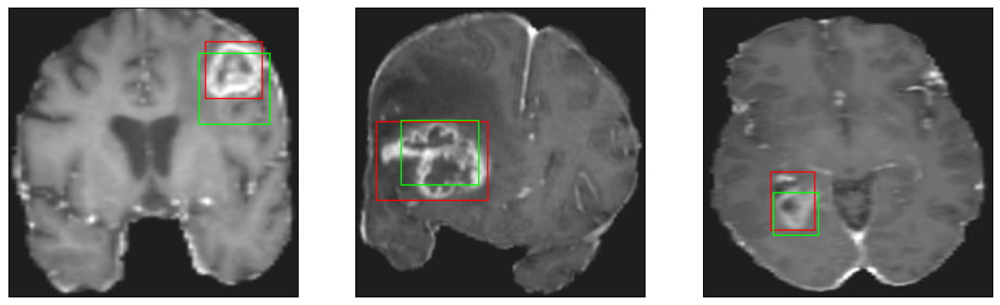

26/26 [==============================] - 4s 164ms/step - loss: 7.0370 - IoU: 0.5093 - val_loss: 10.6859 - val_IoU: 0.4600
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 6.9849 - IoU: 0.5074
Epoch 77: val_IoU did not improve from 0.49474
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


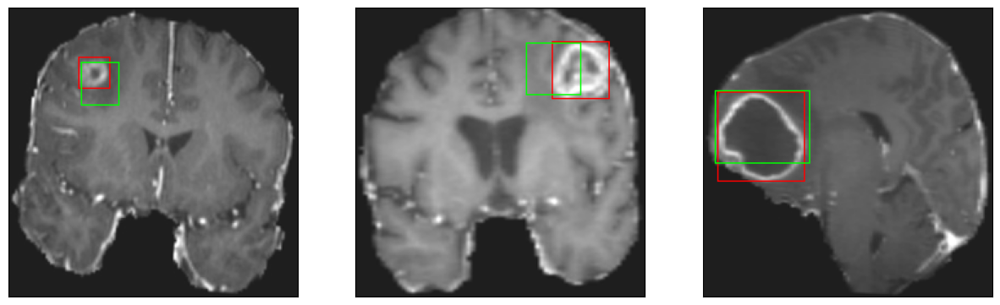

26/26 [==============================] - 4s 134ms/step - loss: 6.9849 - IoU: 0.5074 - val_loss: 9.7348 - val_IoU: 0.4670
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 7.1813 - IoU: 0.4982
Epoch 78: val_IoU did not improve from 0.49474
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


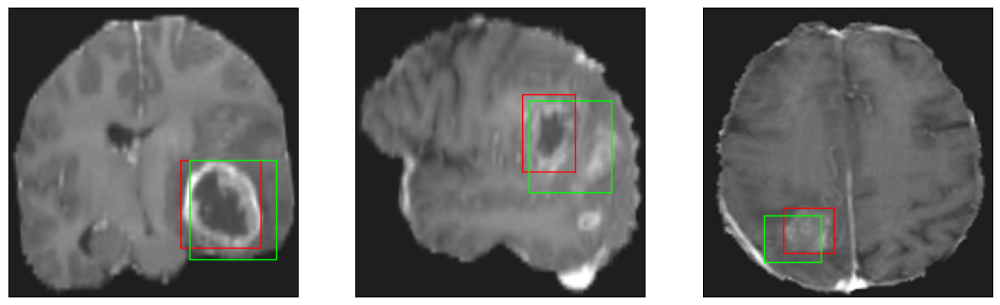

26/26 [==============================] - 3s 132ms/step - loss: 7.1813 - IoU: 0.4982 - val_loss: 9.7613 - val_IoU: 0.4939
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 7.2212 - IoU: 0.4928
Epoch 79: val_IoU did not improve from 0.49474
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


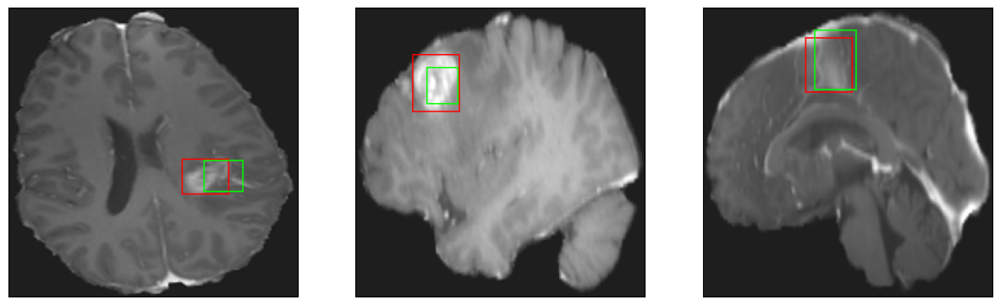

26/26 [==============================] - 4s 145ms/step - loss: 7.2212 - IoU: 0.4928 - val_loss: 9.8472 - val_IoU: 0.4612
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 7.2813 - IoU: 0.5039
Epoch 80: val_IoU did not improve from 0.49474
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4


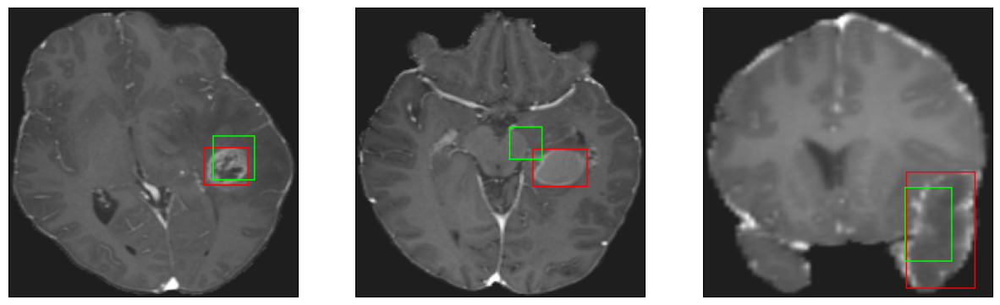

26/26 [==============================] - 4s 143ms/step - loss: 7.2813 - IoU: 0.5039 - val_loss: 15.6923 - val_IoU: 0.2736
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 8.0005 - IoU: 0.4693
Epoch 81: val_IoU did not improve from 0.49474
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


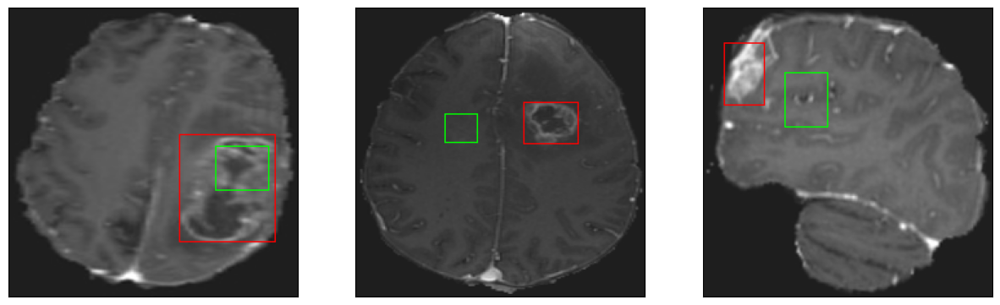

26/26 [==============================] - 3s 135ms/step - loss: 8.0005 - IoU: 0.4693 - val_loss: 10.7347 - val_IoU: 0.4498
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 7.4900 - IoU: 0.4881
Epoch 82: val_IoU did not improve from 0.49474
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


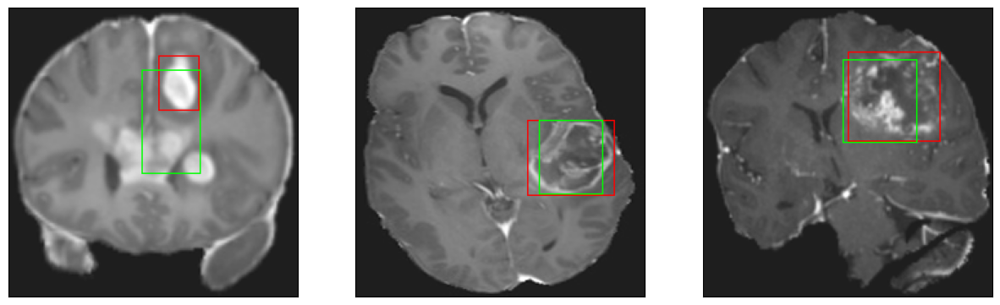

26/26 [==============================] - 3s 125ms/step - loss: 7.4900 - IoU: 0.4881 - val_loss: 10.6908 - val_IoU: 0.4657
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 7.5830 - IoU: 0.4777
Epoch 83: val_IoU did not improve from 0.49474
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 16ms/step
4


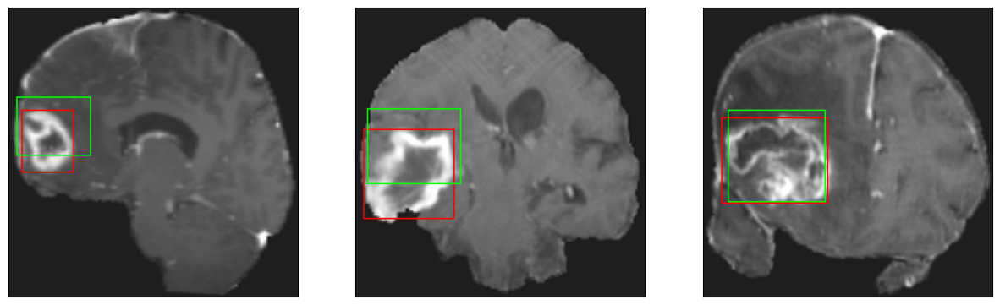

26/26 [==============================] - 4s 142ms/step - loss: 7.5830 - IoU: 0.4777 - val_loss: 11.9494 - val_IoU: 0.4223
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 7.9899 - IoU: 0.4782
Epoch 84: val_IoU improved from 0.49474 to 0.50497, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 17ms/step
4


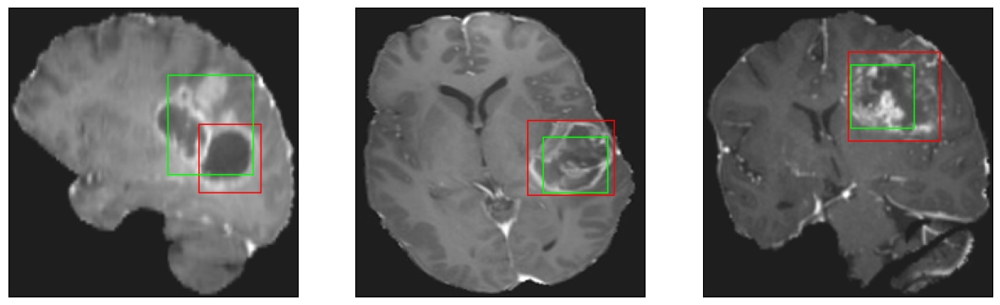

26/26 [==============================] - 11s 431ms/step - loss: 7.9899 - IoU: 0.4782 - val_loss: 9.4395 - val_IoU: 0.5050
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 7.0823 - IoU: 0.5086
Epoch 85: val_IoU did not improve from 0.50497
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


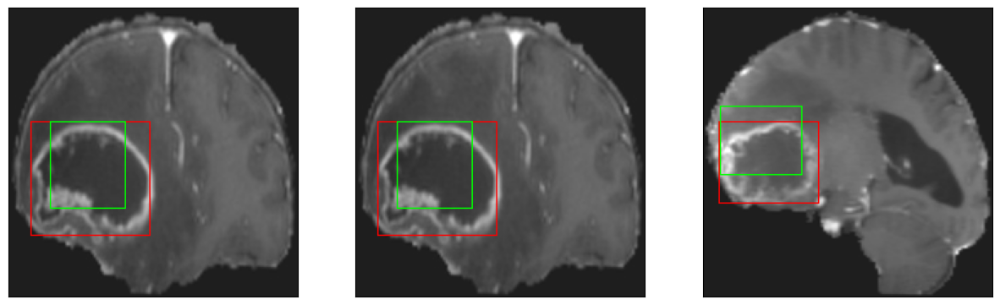

26/26 [==============================] - 4s 144ms/step - loss: 7.0823 - IoU: 0.5086 - val_loss: 10.1318 - val_IoU: 0.4426
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 7.1744 - IoU: 0.4953
Epoch 86: val_IoU did not improve from 0.50497
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


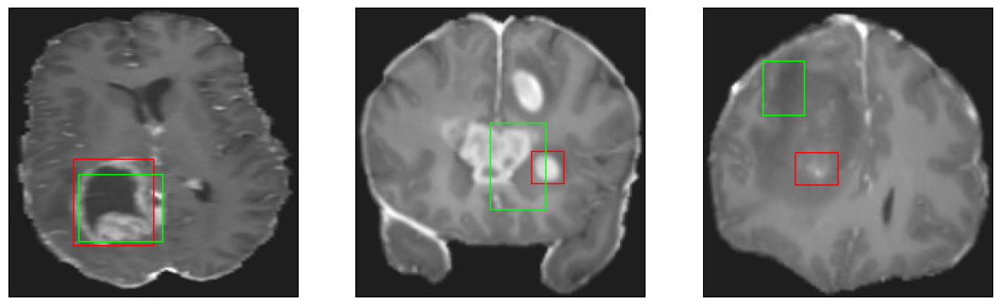

26/26 [==============================] - 3s 125ms/step - loss: 7.1744 - IoU: 0.4953 - val_loss: 9.1860 - val_IoU: 0.4842
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 7.2077 - IoU: 0.4924
Epoch 87: val_IoU improved from 0.50497 to 0.50709, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


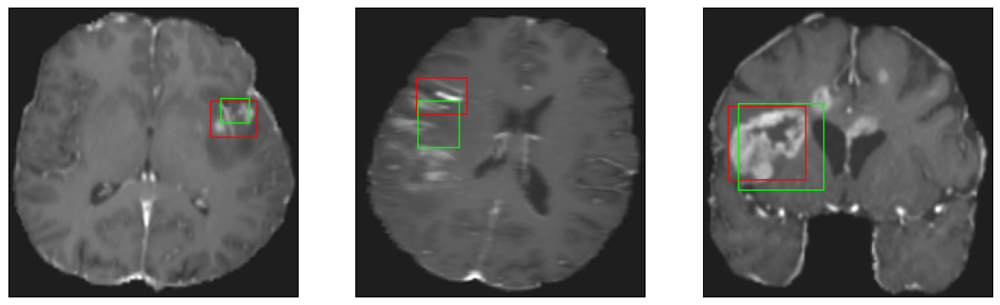

26/26 [==============================] - 5s 201ms/step - loss: 7.2077 - IoU: 0.4924 - val_loss: 8.8497 - val_IoU: 0.5071
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 6.8134 - IoU: 0.5149
Epoch 88: val_IoU did not improve from 0.50709
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


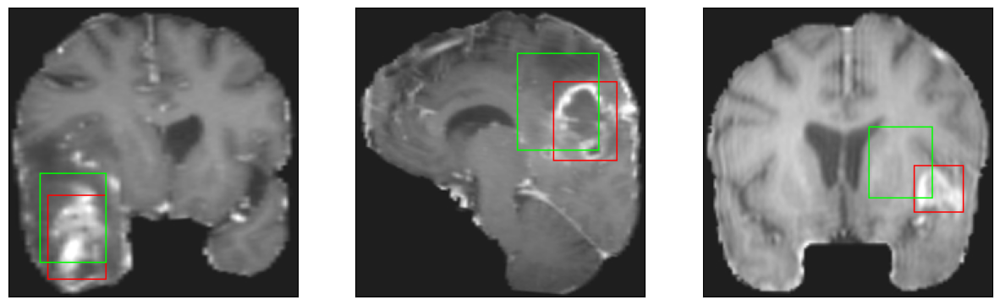

26/26 [==============================] - 4s 135ms/step - loss: 6.8134 - IoU: 0.5149 - val_loss: 9.0506 - val_IoU: 0.5026
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 6.8367 - IoU: 0.5075
Epoch 89: val_IoU did not improve from 0.50709
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


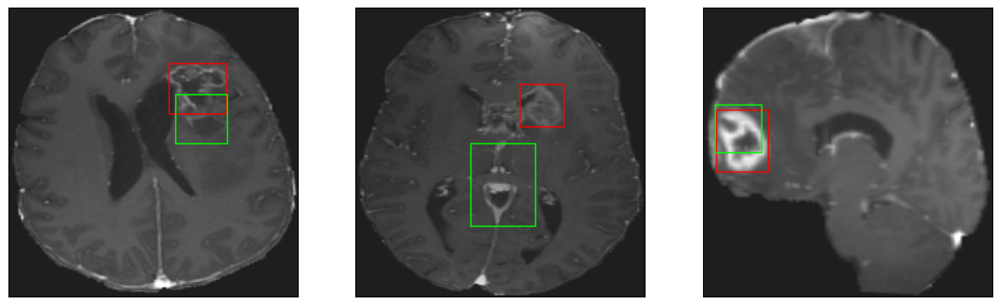

26/26 [==============================] - 4s 135ms/step - loss: 6.8367 - IoU: 0.5075 - val_loss: 9.4626 - val_IoU: 0.4744
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 6.8452 - IoU: 0.5152
Epoch 90: val_IoU did not improve from 0.50709
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


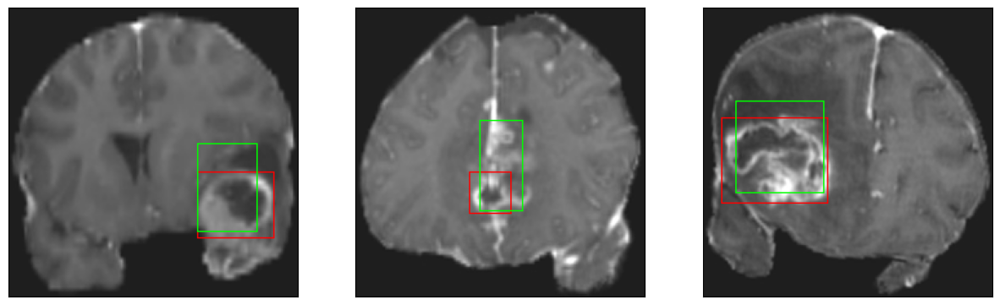

26/26 [==============================] - 4s 140ms/step - loss: 6.8452 - IoU: 0.5152 - val_loss: 10.4780 - val_IoU: 0.4643
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 7.1083 - IoU: 0.5027
Epoch 91: val_IoU improved from 0.50709 to 0.51944, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


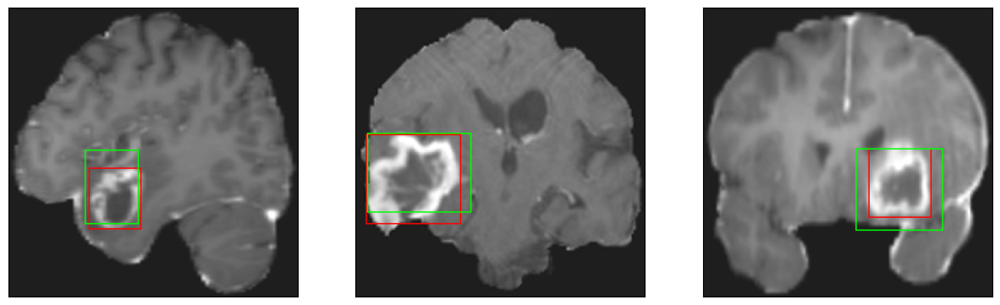

26/26 [==============================] - 9s 355ms/step - loss: 7.1083 - IoU: 0.5027 - val_loss: 8.8356 - val_IoU: 0.5194
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 6.7728 - IoU: 0.5099
Epoch 92: val_IoU did not improve from 0.51944
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


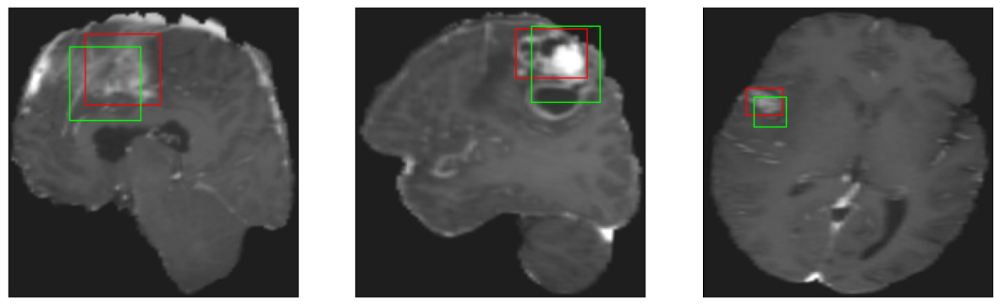

26/26 [==============================] - 3s 131ms/step - loss: 6.7728 - IoU: 0.5099 - val_loss: 8.9552 - val_IoU: 0.5029
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 6.5674 - IoU: 0.5237
Epoch 93: val_IoU did not improve from 0.51944
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 17ms/step
4


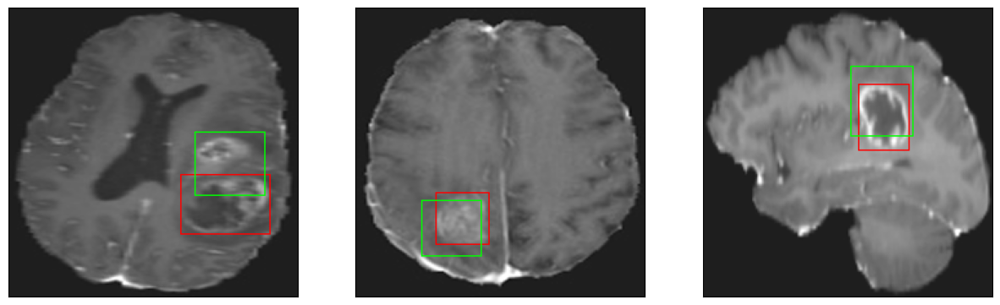

26/26 [==============================] - 5s 180ms/step - loss: 6.5674 - IoU: 0.5237 - val_loss: 8.6411 - val_IoU: 0.5166
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 6.8928 - IoU: 0.5156
Epoch 94: val_IoU improved from 0.51944 to 0.52516, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 20ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 17ms/step
4


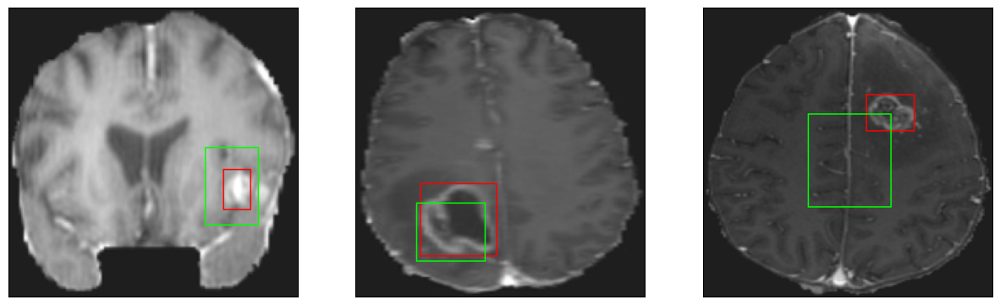

26/26 [==============================] - 10s 407ms/step - loss: 6.8928 - IoU: 0.5156 - val_loss: 8.4658 - val_IoU: 0.5252
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 6.9268 - IoU: 0.5124
Epoch 95: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


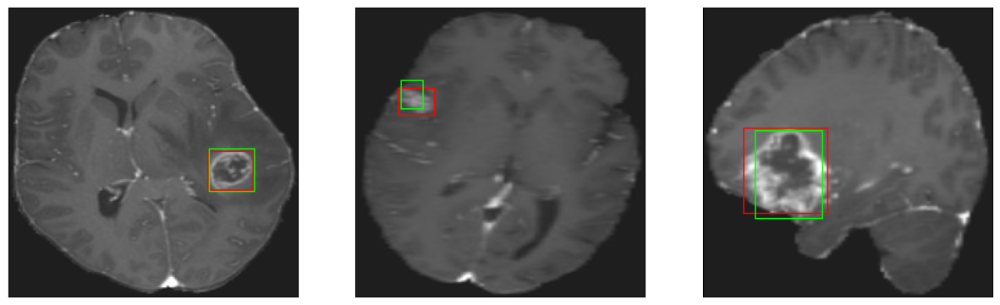

26/26 [==============================] - 3s 130ms/step - loss: 6.9268 - IoU: 0.5124 - val_loss: 10.5764 - val_IoU: 0.4530
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 6.9686 - IoU: 0.4995
Epoch 96: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


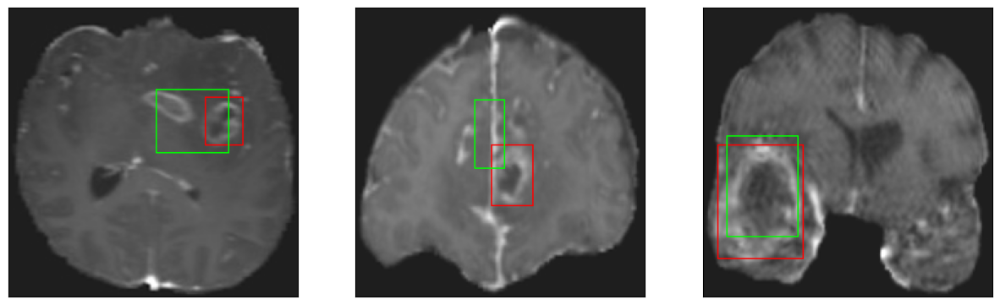

26/26 [==============================] - 4s 137ms/step - loss: 6.9686 - IoU: 0.4995 - val_loss: 9.6593 - val_IoU: 0.4659
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 7.2454 - IoU: 0.5046
Epoch 97: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


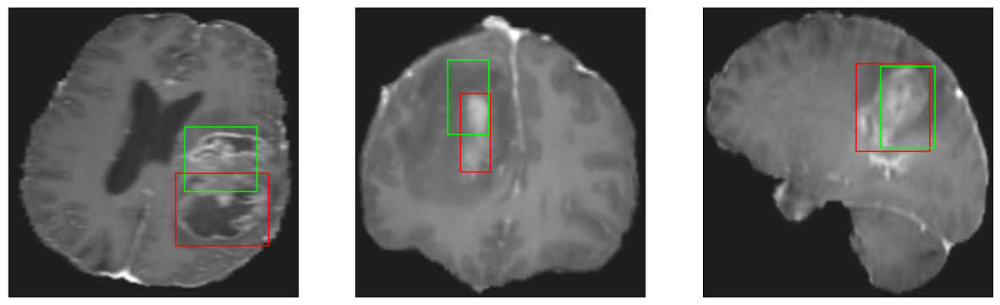

26/26 [==============================] - 3s 127ms/step - loss: 7.2454 - IoU: 0.5046 - val_loss: 10.7189 - val_IoU: 0.4752
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 6.7665 - IoU: 0.5146
Epoch 98: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


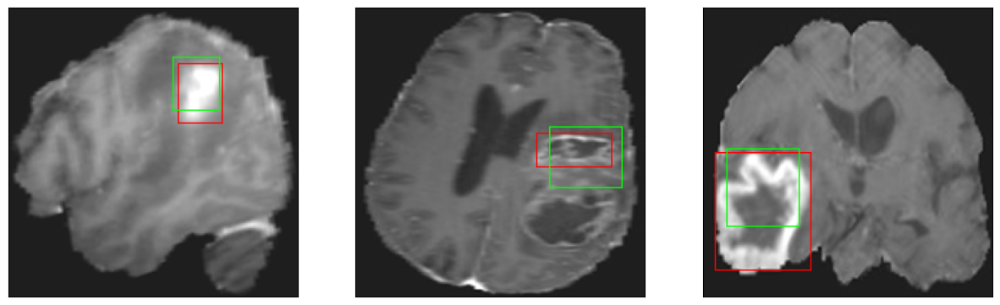

26/26 [==============================] - 3s 123ms/step - loss: 6.7665 - IoU: 0.5146 - val_loss: 10.8108 - val_IoU: 0.4370
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 6.5652 - IoU: 0.5315
Epoch 99: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


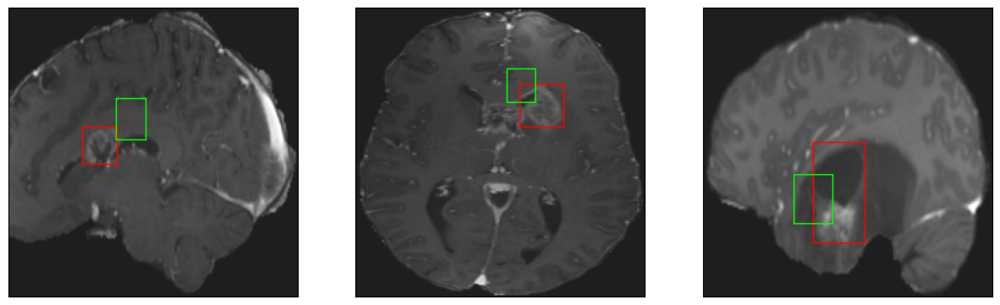

26/26 [==============================] - 4s 142ms/step - loss: 6.5652 - IoU: 0.5315 - val_loss: 9.5882 - val_IoU: 0.4809
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 7.2762 - IoU: 0.4947
Epoch 100: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


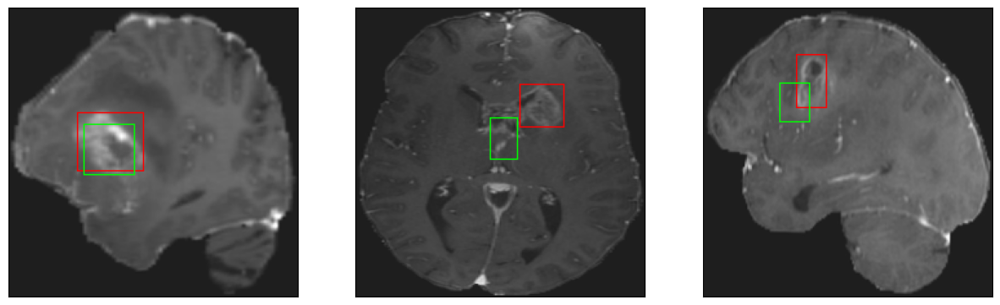

26/26 [==============================] - 4s 149ms/step - loss: 7.2762 - IoU: 0.4947 - val_loss: 10.1354 - val_IoU: 0.4609
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 6.7687 - IoU: 0.5149
Epoch 101: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


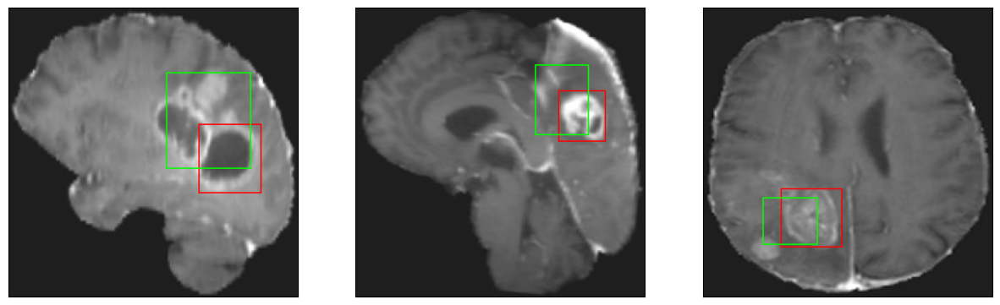

26/26 [==============================] - 3s 123ms/step - loss: 6.7687 - IoU: 0.5149 - val_loss: 10.3467 - val_IoU: 0.4197
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 7.0001 - IoU: 0.5002
Epoch 102: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


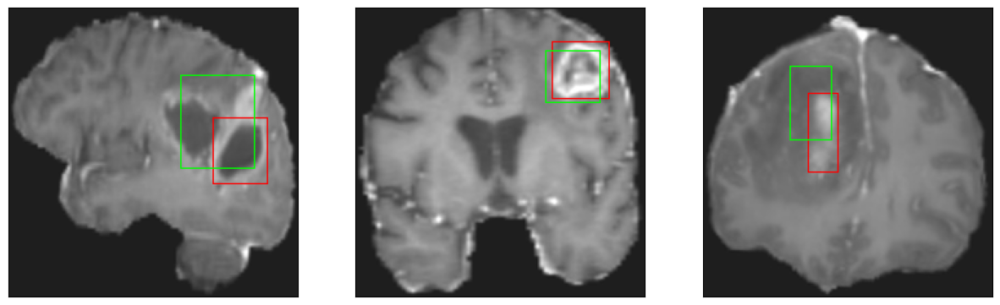

26/26 [==============================] - 3s 127ms/step - loss: 7.0001 - IoU: 0.5002 - val_loss: 9.3391 - val_IoU: 0.4777
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 6.6188 - IoU: 0.5145
Epoch 103: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 13ms/step
4


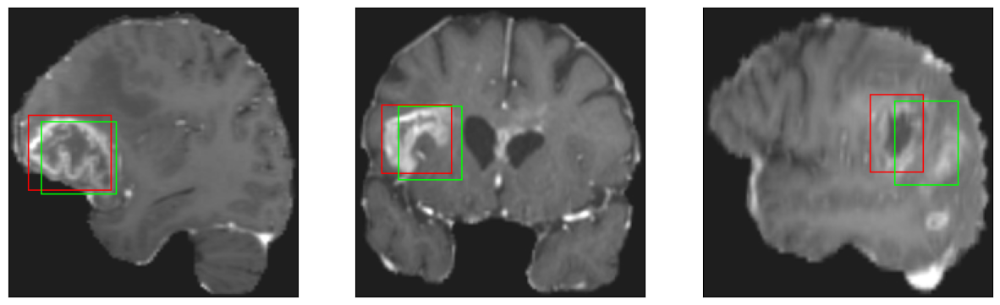

26/26 [==============================] - 4s 146ms/step - loss: 6.6188 - IoU: 0.5145 - val_loss: 9.3849 - val_IoU: 0.4863
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 6.8200 - IoU: 0.5177
Epoch 104: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


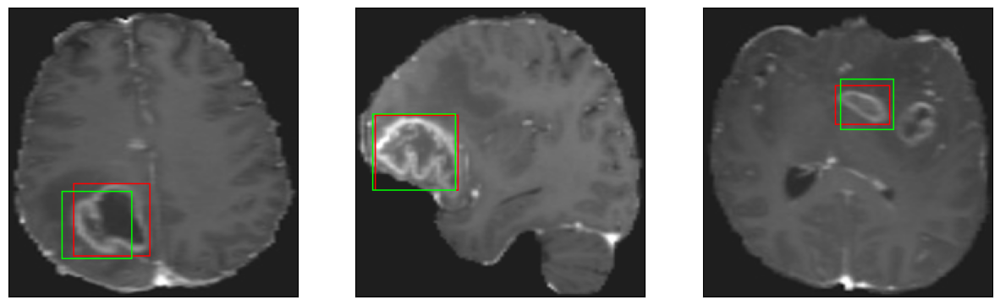

26/26 [==============================] - 3s 124ms/step - loss: 6.8200 - IoU: 0.5177 - val_loss: 9.6452 - val_IoU: 0.4845
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 7.0778 - IoU: 0.5069
Epoch 105: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


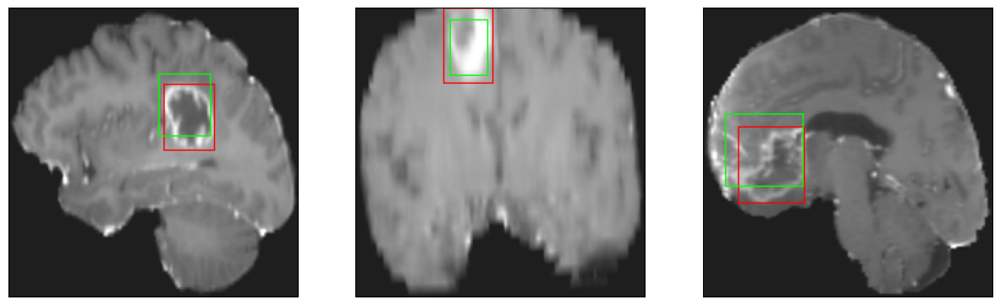

26/26 [==============================] - 3s 125ms/step - loss: 7.0778 - IoU: 0.5069 - val_loss: 9.4981 - val_IoU: 0.4850
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 6.7030 - IoU: 0.5161
Epoch 106: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


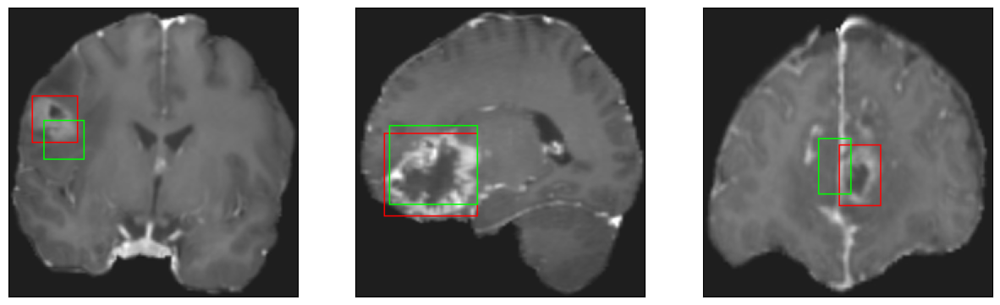

26/26 [==============================] - 4s 145ms/step - loss: 6.7030 - IoU: 0.5161 - val_loss: 9.6439 - val_IoU: 0.5036
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 6.5871 - IoU: 0.5323
Epoch 107: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


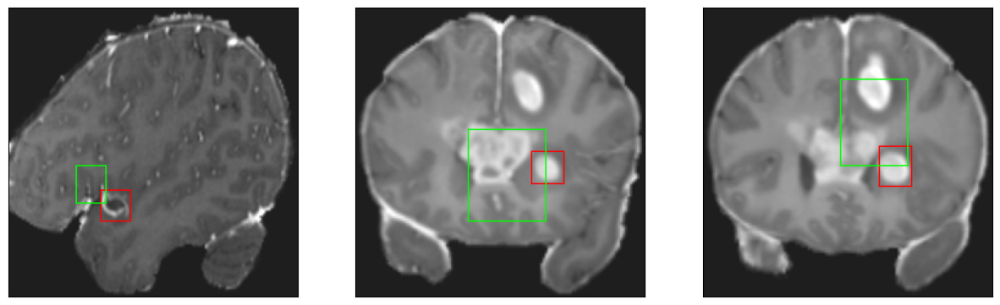

26/26 [==============================] - 3s 131ms/step - loss: 6.5871 - IoU: 0.5323 - val_loss: 9.7041 - val_IoU: 0.4889
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 6.4687 - IoU: 0.5400
Epoch 108: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


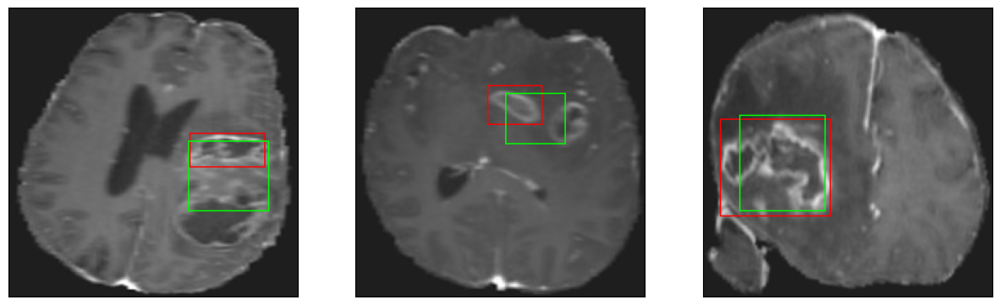

26/26 [==============================] - 3s 126ms/step - loss: 6.4687 - IoU: 0.5400 - val_loss: 8.4932 - val_IoU: 0.5203
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 6.3831 - IoU: 0.5364
Epoch 109: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


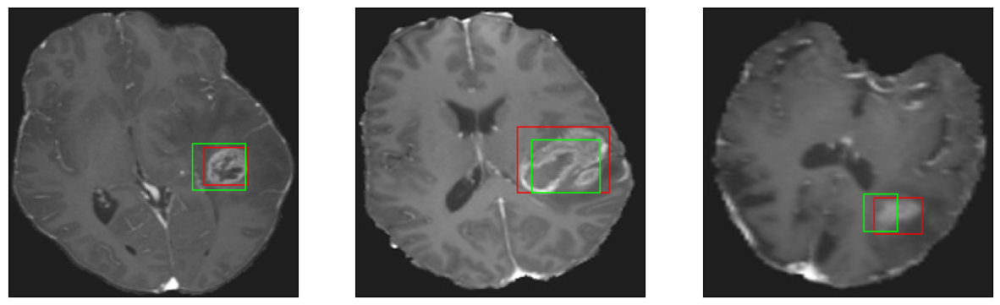

26/26 [==============================] - 4s 136ms/step - loss: 6.3831 - IoU: 0.5364 - val_loss: 8.5704 - val_IoU: 0.5165
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 6.6617 - IoU: 0.5249
Epoch 110: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


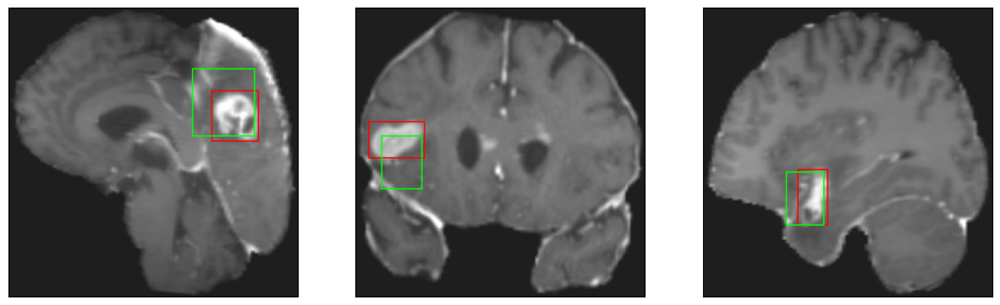

26/26 [==============================] - 4s 143ms/step - loss: 6.6617 - IoU: 0.5249 - val_loss: 8.9823 - val_IoU: 0.5072
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 6.2731 - IoU: 0.5366
Epoch 111: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


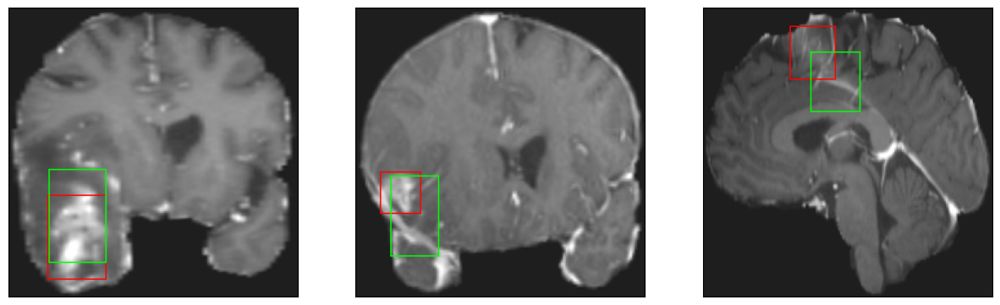

26/26 [==============================] - 4s 140ms/step - loss: 6.2731 - IoU: 0.5366 - val_loss: 9.3540 - val_IoU: 0.5010
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 6.7886 - IoU: 0.5228
Epoch 112: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


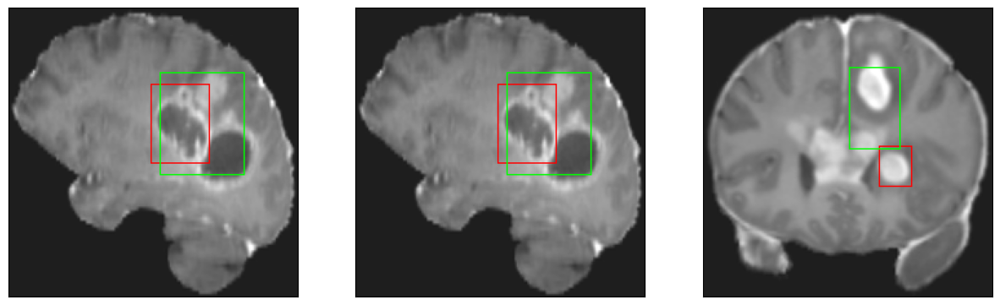

26/26 [==============================] - 3s 124ms/step - loss: 6.7886 - IoU: 0.5228 - val_loss: 9.5016 - val_IoU: 0.4967
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 6.3849 - IoU: 0.5368
Epoch 113: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


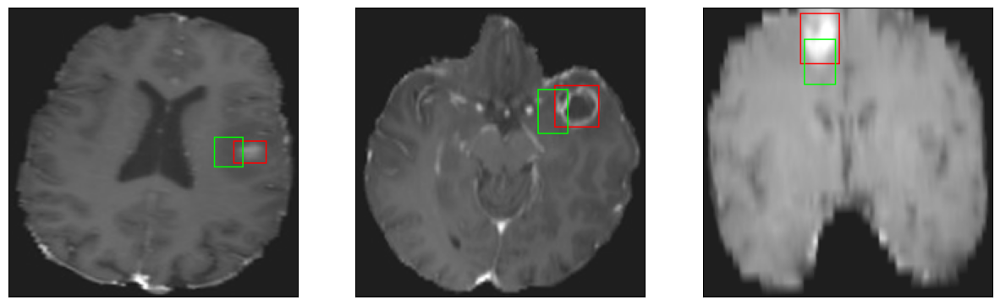

26/26 [==============================] - 4s 144ms/step - loss: 6.3849 - IoU: 0.5368 - val_loss: 9.6682 - val_IoU: 0.4680
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 6.3741 - IoU: 0.5324
Epoch 114: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


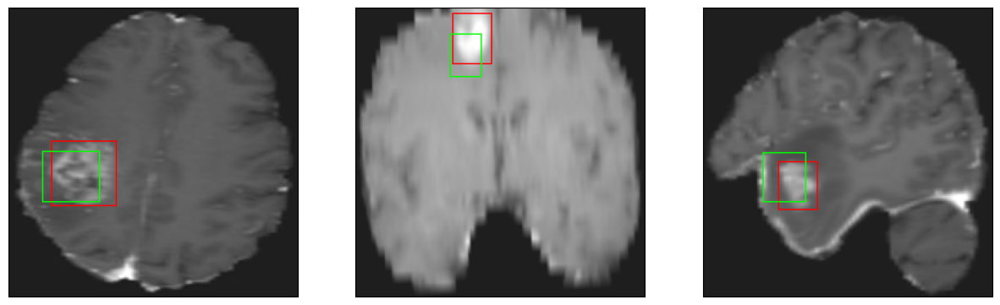

26/26 [==============================] - 4s 136ms/step - loss: 6.3741 - IoU: 0.5324 - val_loss: 10.0448 - val_IoU: 0.4497
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 6.3330 - IoU: 0.5390
Epoch 115: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


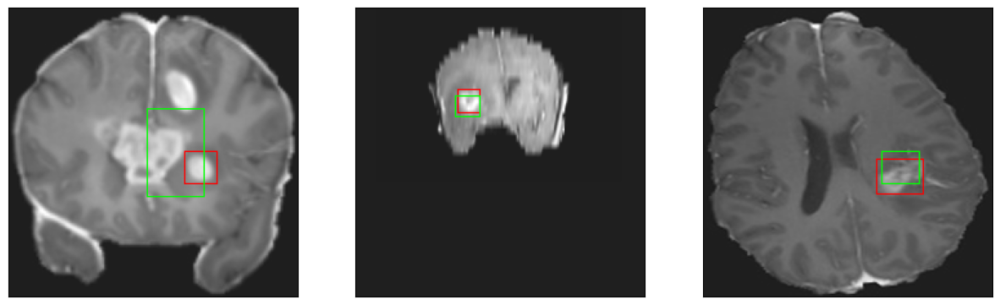

26/26 [==============================] - 3s 130ms/step - loss: 6.3330 - IoU: 0.5390 - val_loss: 9.2499 - val_IoU: 0.4965
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 6.2831 - IoU: 0.5341
Epoch 116: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 17ms/step
4


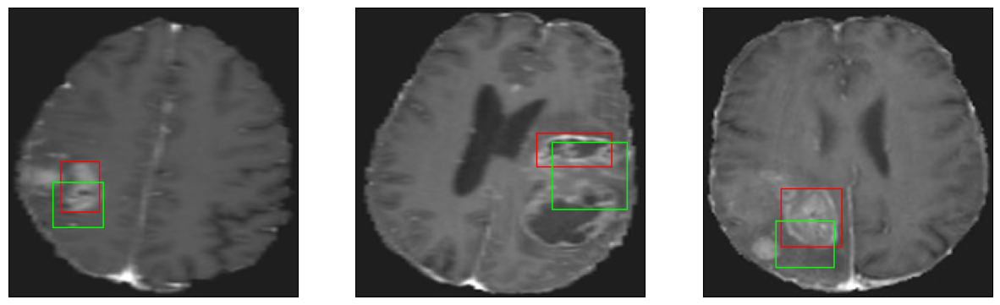

26/26 [==============================] - 4s 150ms/step - loss: 6.2831 - IoU: 0.5341 - val_loss: 8.6749 - val_IoU: 0.4958
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 6.7647 - IoU: 0.5088
Epoch 117: val_IoU did not improve from 0.52516
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


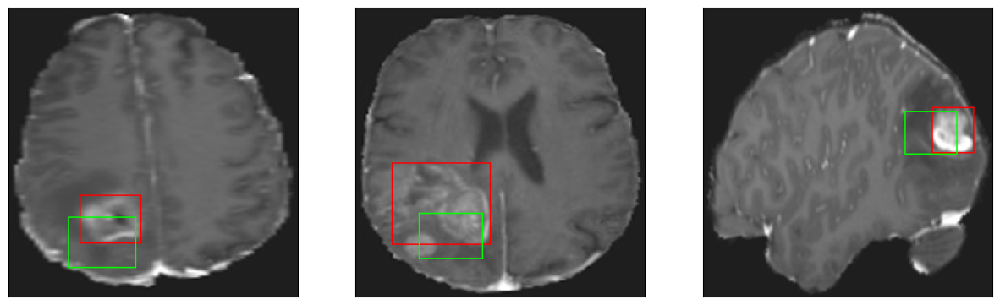

26/26 [==============================] - 4s 142ms/step - loss: 6.7647 - IoU: 0.5088 - val_loss: 9.5697 - val_IoU: 0.4790
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 6.4816 - IoU: 0.5333
Epoch 118: val_IoU improved from 0.52516 to 0.52715, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 19ms/step
4
8/8 [==============================] - 0s 19ms/step
4
8/8 [==============================] - 0s 19ms/step
4


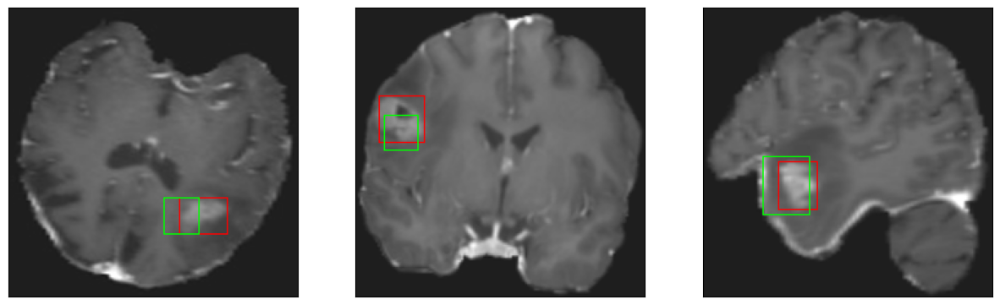

26/26 [==============================] - 10s 392ms/step - loss: 6.4816 - IoU: 0.5333 - val_loss: 9.2670 - val_IoU: 0.5272
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 6.2841 - IoU: 0.5407
Epoch 119: val_IoU did not improve from 0.52715
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


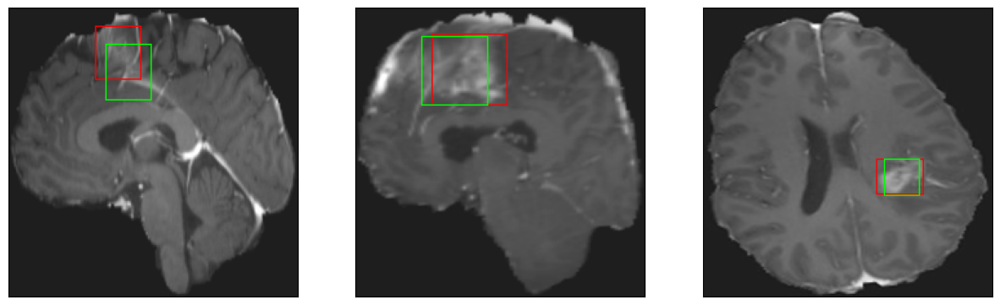

26/26 [==============================] - 4s 152ms/step - loss: 6.2841 - IoU: 0.5407 - val_loss: 9.5913 - val_IoU: 0.4857
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 6.7548 - IoU: 0.5277
Epoch 120: val_IoU did not improve from 0.52715
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


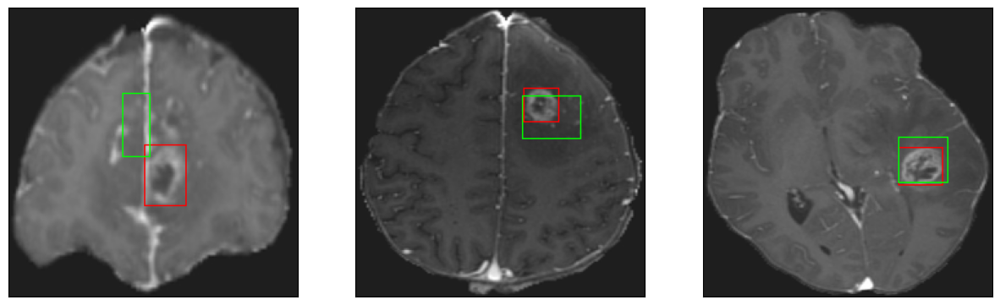

26/26 [==============================] - 4s 153ms/step - loss: 6.7548 - IoU: 0.5277 - val_loss: 9.4665 - val_IoU: 0.5022
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 6.1065 - IoU: 0.5504
Epoch 121: val_IoU improved from 0.52715 to 0.54333, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 19ms/step
4


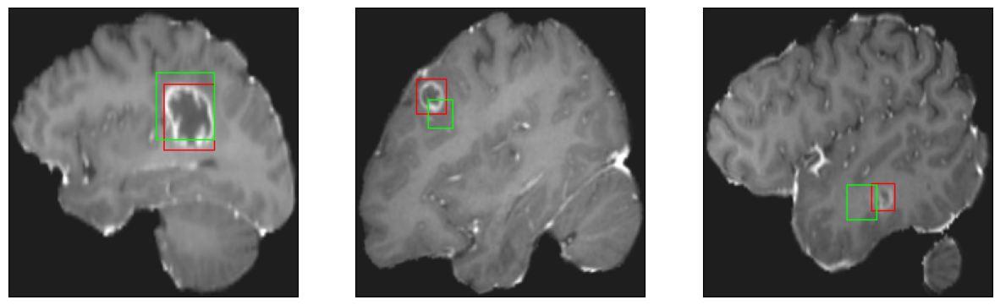

26/26 [==============================] - 8s 319ms/step - loss: 6.1065 - IoU: 0.5504 - val_loss: 8.9701 - val_IoU: 0.5433
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 6.2003 - IoU: 0.5511
Epoch 122: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 19ms/step
4


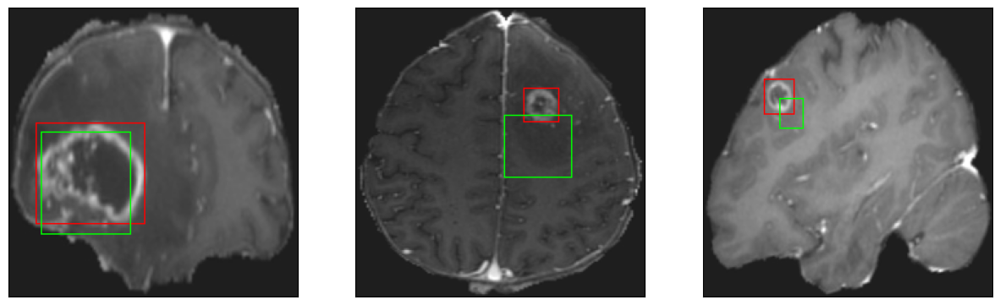

26/26 [==============================] - 4s 153ms/step - loss: 6.2003 - IoU: 0.5511 - val_loss: 9.2088 - val_IoU: 0.5305
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 6.5606 - IoU: 0.5267
Epoch 123: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


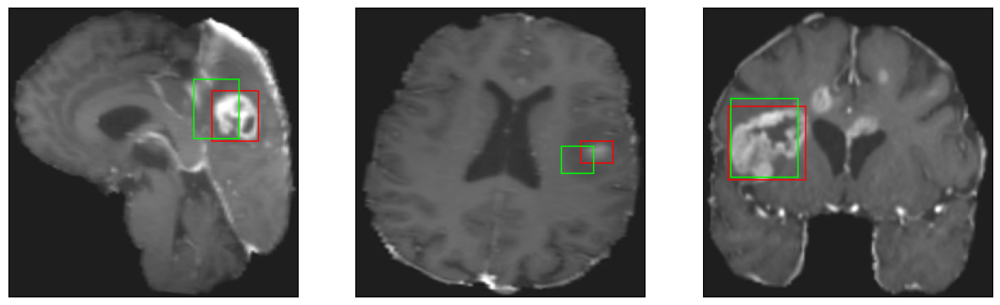

26/26 [==============================] - 3s 120ms/step - loss: 6.5606 - IoU: 0.5267 - val_loss: 10.0654 - val_IoU: 0.4580
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 6.5645 - IoU: 0.5277
Epoch 124: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


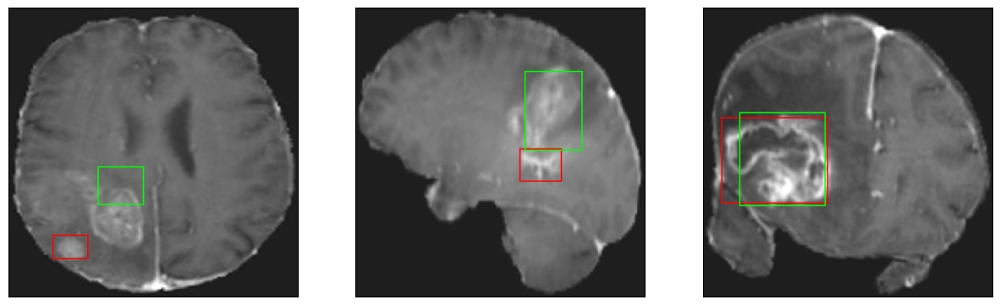

26/26 [==============================] - 4s 135ms/step - loss: 6.5645 - IoU: 0.5277 - val_loss: 10.9508 - val_IoU: 0.4409
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 6.3678 - IoU: 0.5324
Epoch 125: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


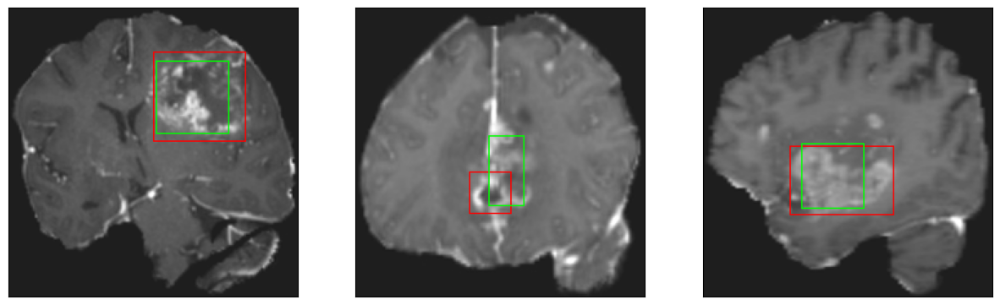

26/26 [==============================] - 3s 128ms/step - loss: 6.3678 - IoU: 0.5324 - val_loss: 9.4599 - val_IoU: 0.4820
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 6.3589 - IoU: 0.5358
Epoch 126: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


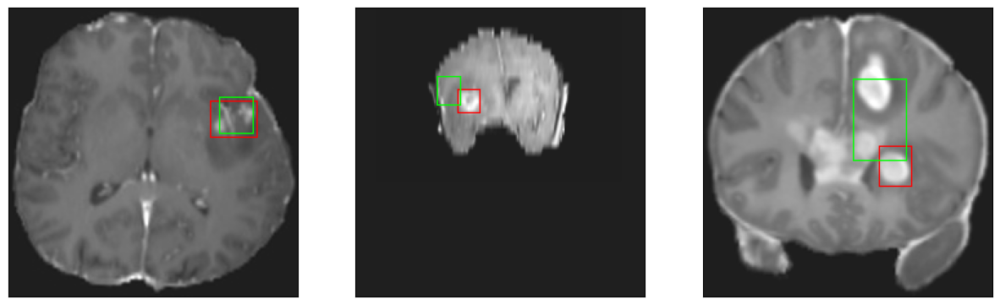

26/26 [==============================] - 3s 122ms/step - loss: 6.3589 - IoU: 0.5358 - val_loss: 9.0534 - val_IoU: 0.4986
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 6.1116 - IoU: 0.5530
Epoch 127: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


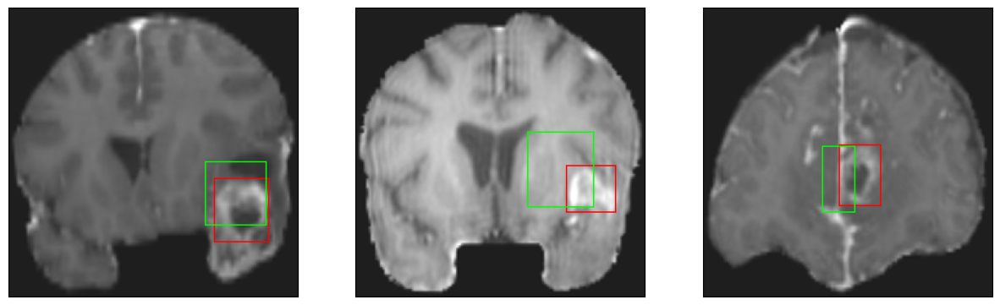

26/26 [==============================] - 3s 118ms/step - loss: 6.1116 - IoU: 0.5530 - val_loss: 8.4336 - val_IoU: 0.5101
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 6.6243 - IoU: 0.5250
Epoch 128: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


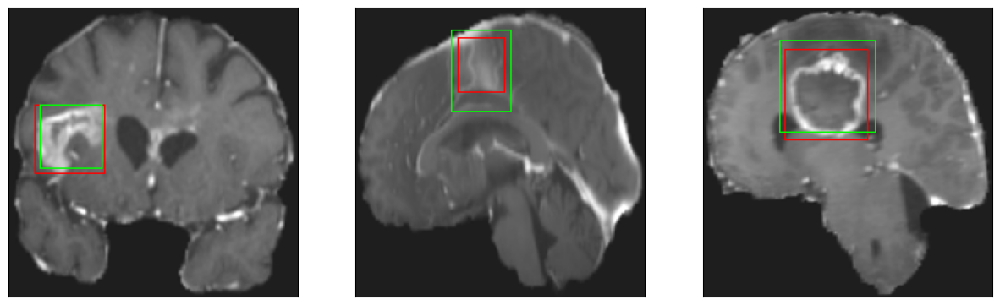

26/26 [==============================] - 4s 142ms/step - loss: 6.6243 - IoU: 0.5250 - val_loss: 8.8169 - val_IoU: 0.5374
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 6.0557 - IoU: 0.5627
Epoch 129: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


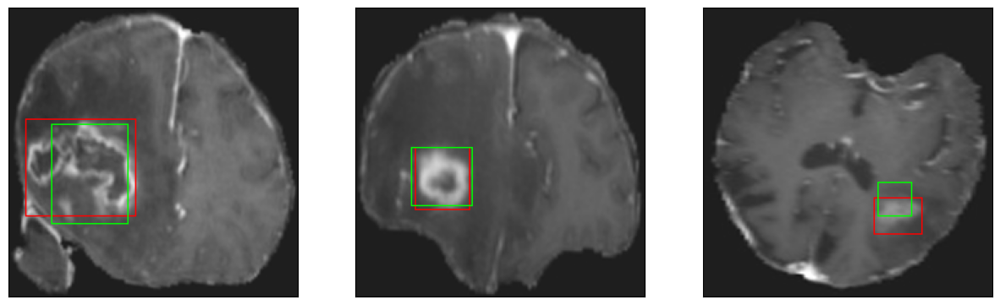

26/26 [==============================] - 4s 142ms/step - loss: 6.0557 - IoU: 0.5627 - val_loss: 8.5161 - val_IoU: 0.5368
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 6.5067 - IoU: 0.5332
Epoch 130: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


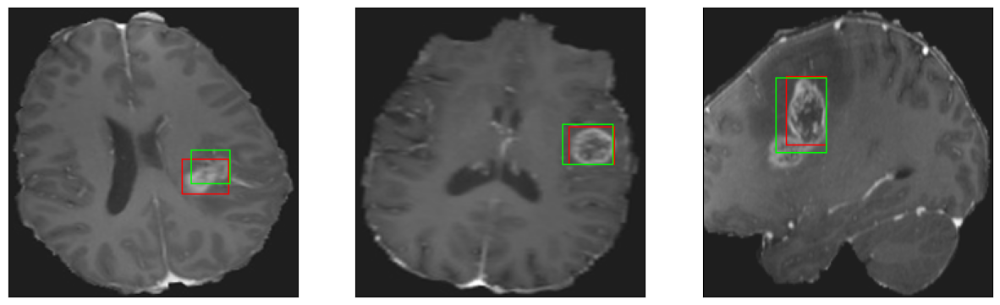

26/26 [==============================] - 3s 127ms/step - loss: 6.5067 - IoU: 0.5332 - val_loss: 8.8889 - val_IoU: 0.5150
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 6.2617 - IoU: 0.5499
Epoch 131: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


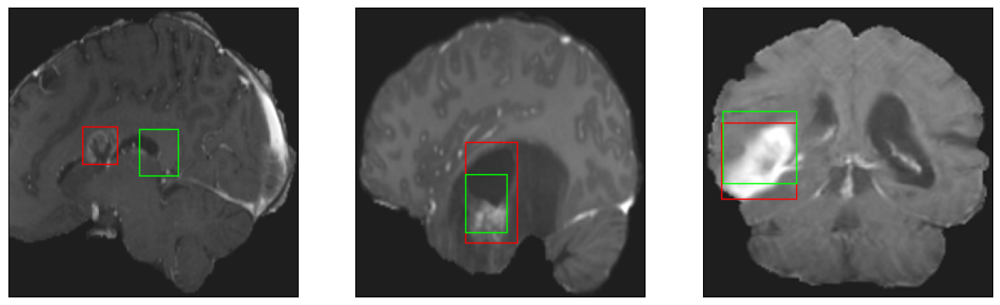

26/26 [==============================] - 3s 123ms/step - loss: 6.2617 - IoU: 0.5499 - val_loss: 8.5988 - val_IoU: 0.5237
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 6.2137 - IoU: 0.5457
Epoch 132: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


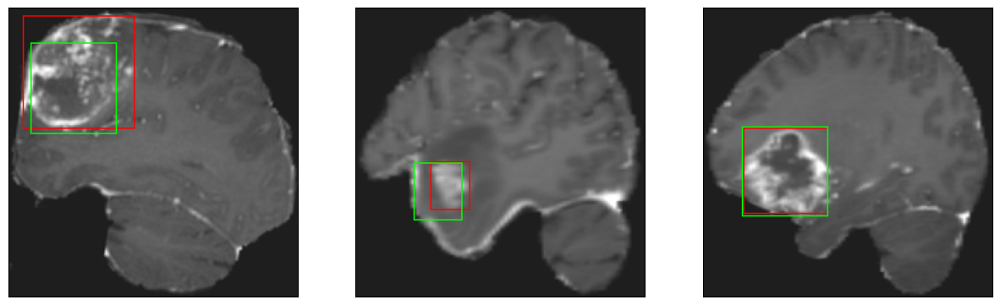

26/26 [==============================] - 3s 130ms/step - loss: 6.2137 - IoU: 0.5457 - val_loss: 9.0606 - val_IoU: 0.5173
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 6.1249 - IoU: 0.5577
Epoch 133: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


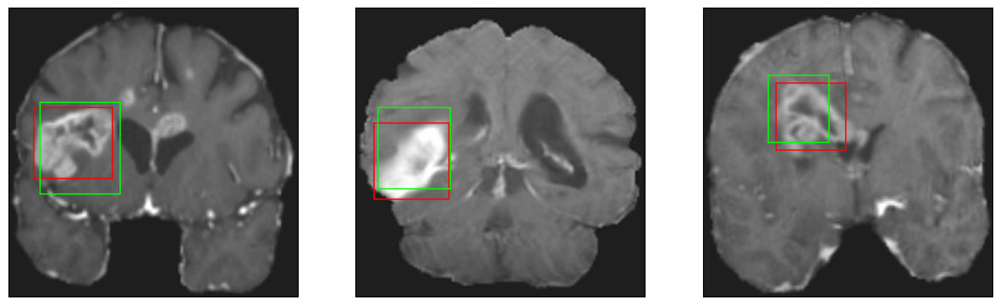

26/26 [==============================] - 4s 146ms/step - loss: 6.1249 - IoU: 0.5577 - val_loss: 9.4862 - val_IoU: 0.4930
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 6.3621 - IoU: 0.5375
Epoch 134: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


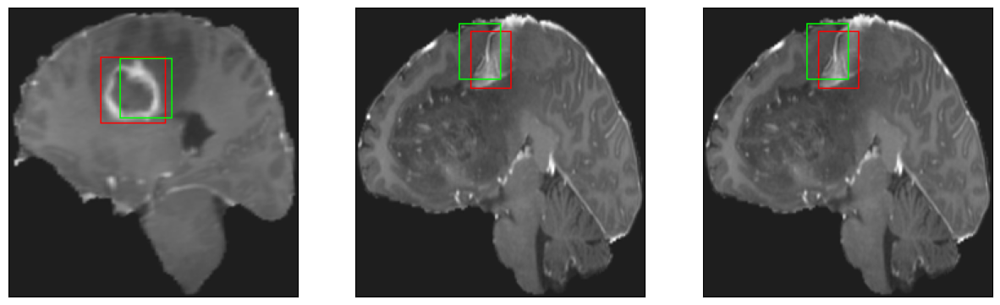

26/26 [==============================] - 3s 128ms/step - loss: 6.3621 - IoU: 0.5375 - val_loss: 9.4870 - val_IoU: 0.4824
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 6.1391 - IoU: 0.5492
Epoch 135: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4


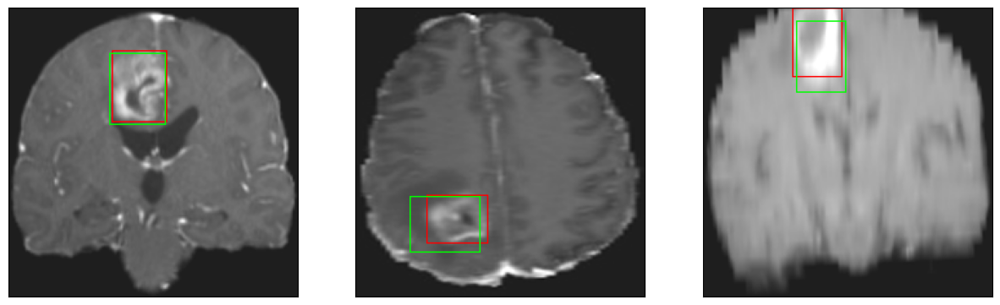

26/26 [==============================] - 3s 130ms/step - loss: 6.1391 - IoU: 0.5492 - val_loss: 9.4217 - val_IoU: 0.5224
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 5.8274 - IoU: 0.5600
Epoch 136: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4


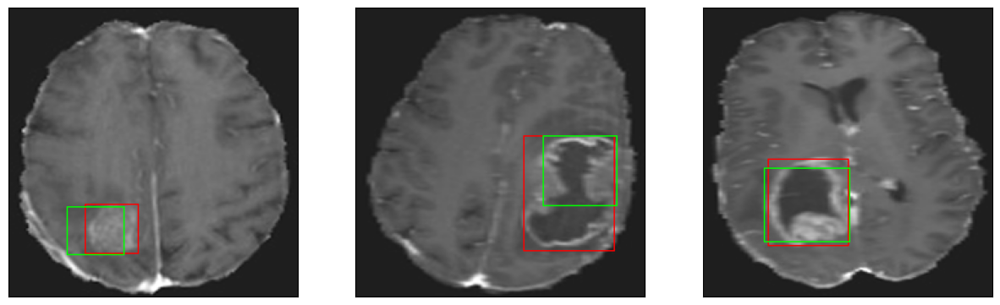

26/26 [==============================] - 4s 153ms/step - loss: 5.8274 - IoU: 0.5600 - val_loss: 9.3649 - val_IoU: 0.5163
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 6.2610 - IoU: 0.5474
Epoch 137: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


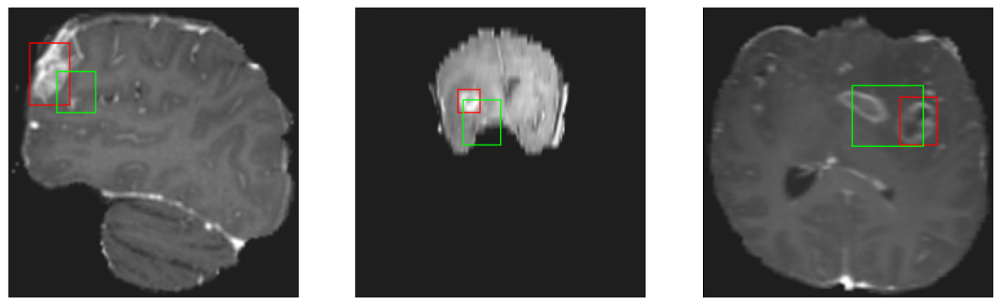

26/26 [==============================] - 3s 134ms/step - loss: 6.2610 - IoU: 0.5474 - val_loss: 8.6002 - val_IoU: 0.5325
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 5.8498 - IoU: 0.5572
Epoch 138: val_IoU did not improve from 0.54333
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4


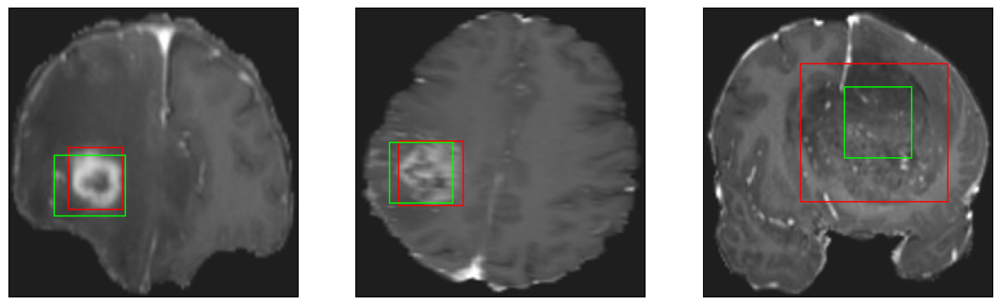

26/26 [==============================] - 3s 135ms/step - loss: 5.8498 - IoU: 0.5572 - val_loss: 8.9893 - val_IoU: 0.5242
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 5.9314 - IoU: 0.5691
Epoch 139: val_IoU improved from 0.54333 to 0.54846, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 21ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 15ms/step
4


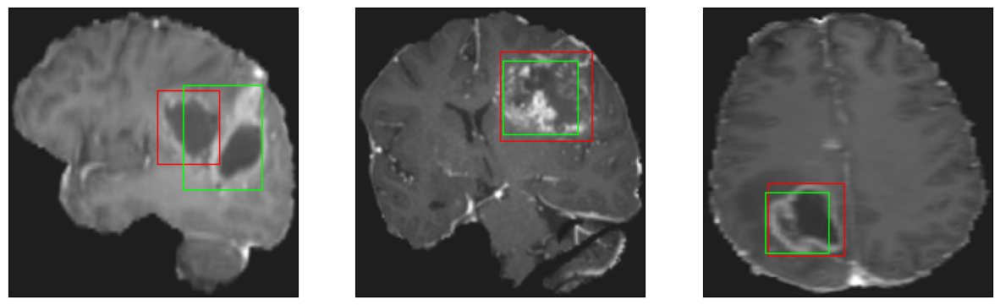

26/26 [==============================] - 8s 311ms/step - loss: 5.9314 - IoU: 0.5691 - val_loss: 8.2932 - val_IoU: 0.5485
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 5.7242 - IoU: 0.5788
Epoch 140: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4


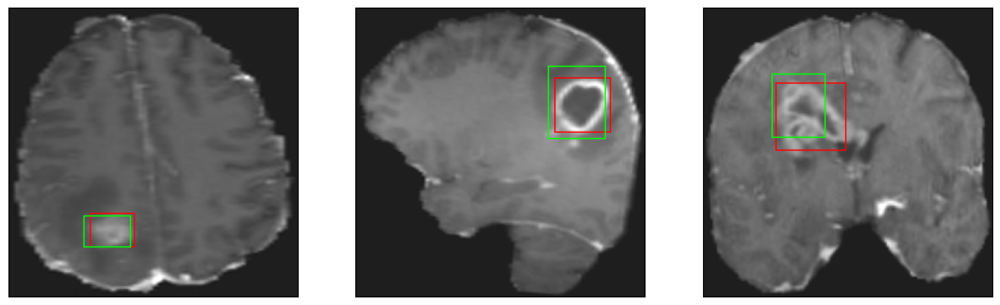

26/26 [==============================] - 4s 152ms/step - loss: 5.7242 - IoU: 0.5788 - val_loss: 9.3029 - val_IoU: 0.4736
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 5.9650 - IoU: 0.5483
Epoch 141: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 16ms/step
4


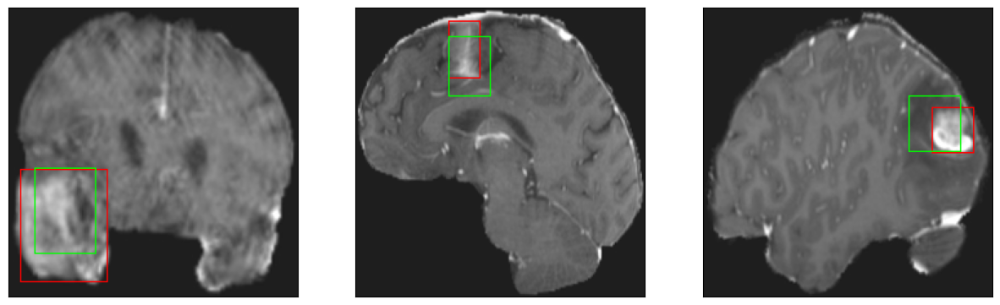

26/26 [==============================] - 4s 174ms/step - loss: 5.9650 - IoU: 0.5483 - val_loss: 8.9151 - val_IoU: 0.5088
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 6.0155 - IoU: 0.5595
Epoch 142: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


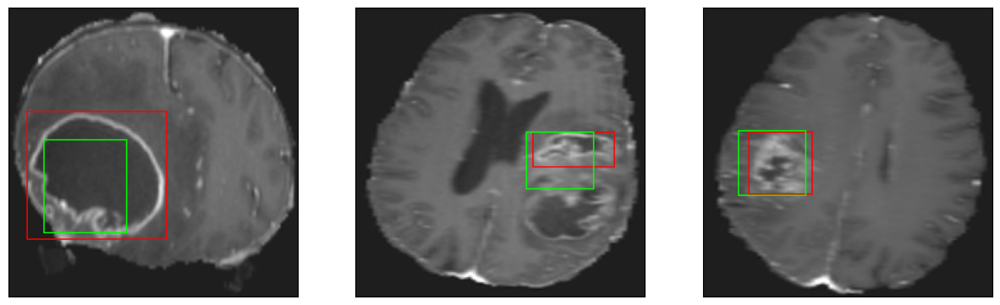

26/26 [==============================] - 4s 142ms/step - loss: 6.0155 - IoU: 0.5595 - val_loss: 8.3052 - val_IoU: 0.5449
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 5.9249 - IoU: 0.5656
Epoch 143: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


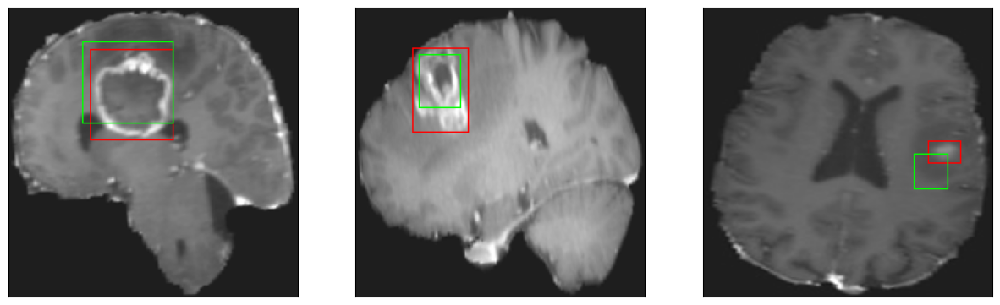

26/26 [==============================] - 3s 124ms/step - loss: 5.9249 - IoU: 0.5656 - val_loss: 8.8340 - val_IoU: 0.5328
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 5.7686 - IoU: 0.5612
Epoch 144: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


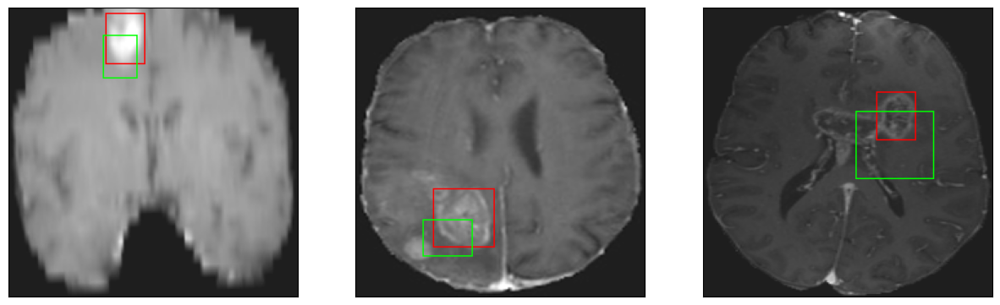

26/26 [==============================] - 3s 126ms/step - loss: 5.7686 - IoU: 0.5612 - val_loss: 9.3399 - val_IoU: 0.4740
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 6.0045 - IoU: 0.5487
Epoch 145: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4


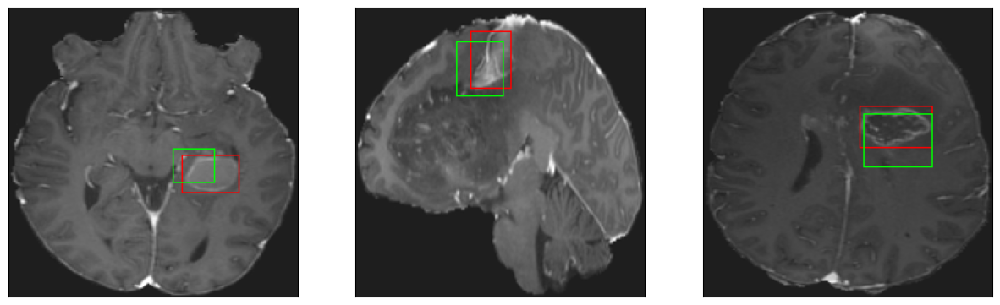

26/26 [==============================] - 4s 146ms/step - loss: 6.0045 - IoU: 0.5487 - val_loss: 8.9136 - val_IoU: 0.5012
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 6.0736 - IoU: 0.5430
Epoch 146: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


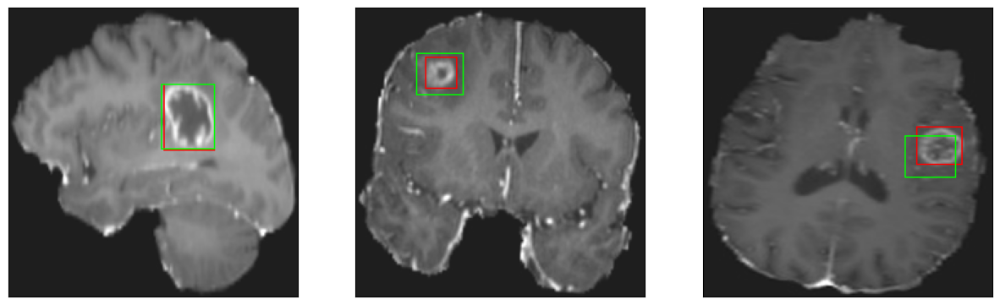

26/26 [==============================] - 3s 130ms/step - loss: 6.0736 - IoU: 0.5430 - val_loss: 8.6852 - val_IoU: 0.5162
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 5.7838 - IoU: 0.5730
Epoch 147: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 12ms/step
4


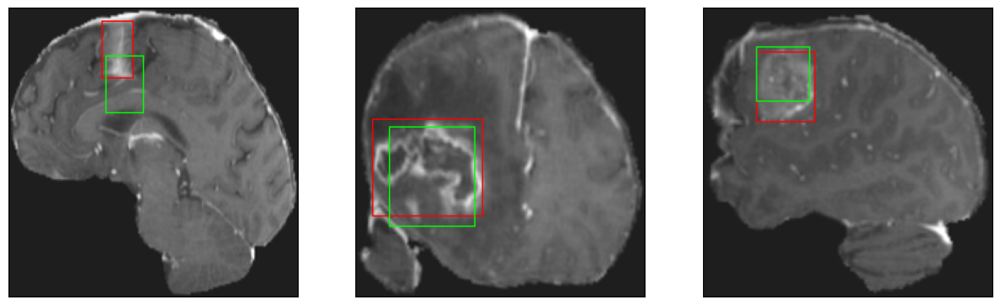

26/26 [==============================] - 3s 124ms/step - loss: 5.7838 - IoU: 0.5730 - val_loss: 8.3999 - val_IoU: 0.5348
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 5.6428 - IoU: 0.5720
Epoch 148: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


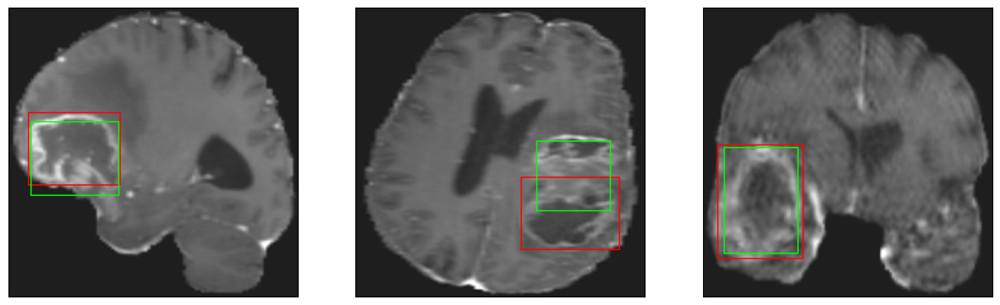

26/26 [==============================] - 4s 144ms/step - loss: 5.6428 - IoU: 0.5720 - val_loss: 8.3209 - val_IoU: 0.5425
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 5.9724 - IoU: 0.5518
Epoch 149: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


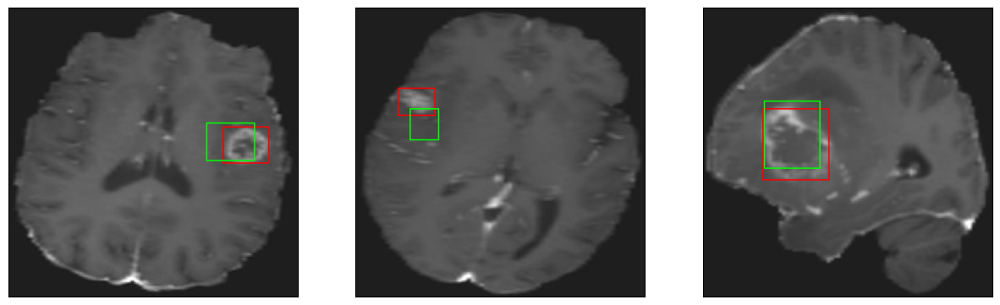

26/26 [==============================] - 4s 137ms/step - loss: 5.9724 - IoU: 0.5518 - val_loss: 8.9013 - val_IoU: 0.5078
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 5.8135 - IoU: 0.5569
Epoch 150: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


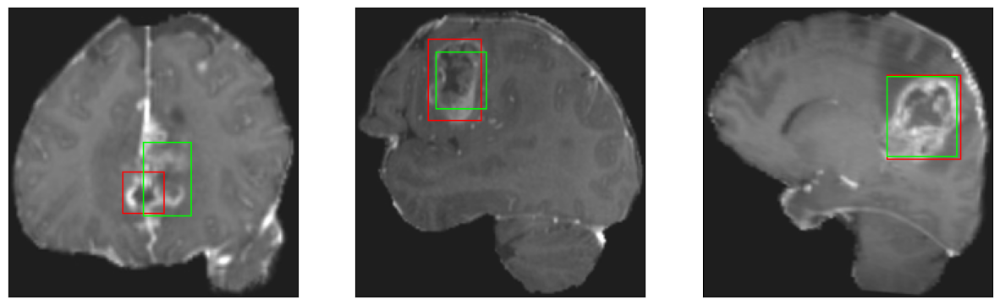

26/26 [==============================] - 3s 127ms/step - loss: 5.8135 - IoU: 0.5569 - val_loss: 8.9351 - val_IoU: 0.5240
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 5.8595 - IoU: 0.5646
Epoch 151: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


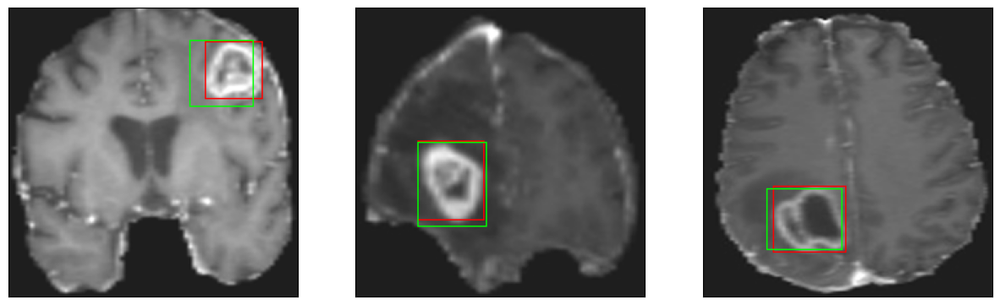

26/26 [==============================] - 3s 131ms/step - loss: 5.8595 - IoU: 0.5646 - val_loss: 9.2507 - val_IoU: 0.5281
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 5.8968 - IoU: 0.5614
Epoch 152: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4


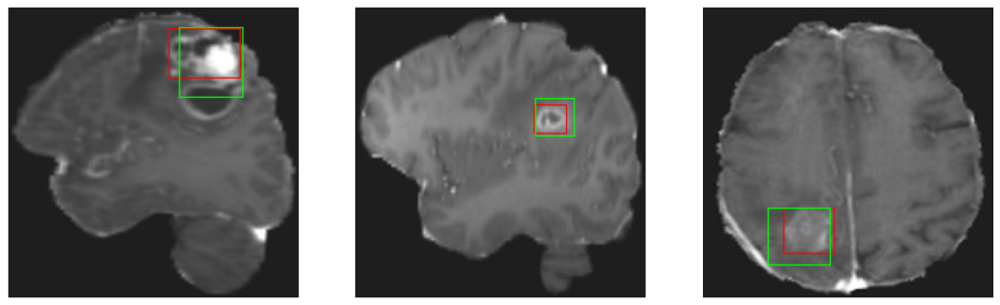

26/26 [==============================] - 4s 145ms/step - loss: 5.8968 - IoU: 0.5614 - val_loss: 8.6813 - val_IoU: 0.5244
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 6.0436 - IoU: 0.5570
Epoch 153: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


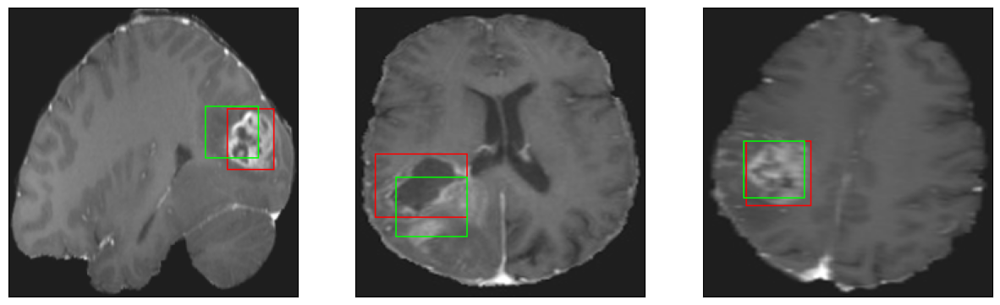

26/26 [==============================] - 3s 131ms/step - loss: 6.0436 - IoU: 0.5570 - val_loss: 8.5909 - val_IoU: 0.5251
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 5.8344 - IoU: 0.5585
Epoch 154: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


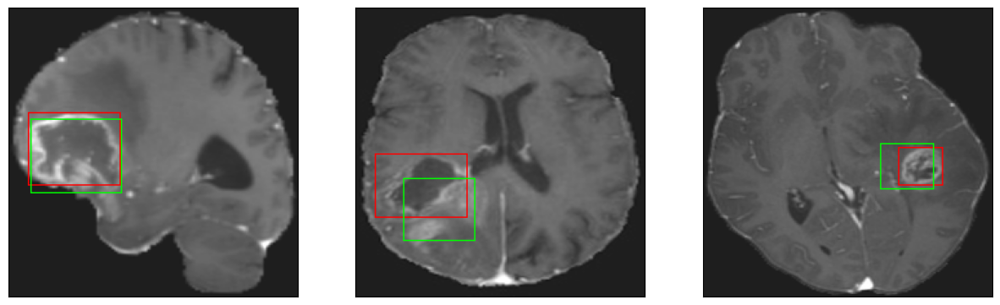

26/26 [==============================] - 3s 126ms/step - loss: 5.8344 - IoU: 0.5585 - val_loss: 8.6361 - val_IoU: 0.5265
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 5.8561 - IoU: 0.5701
Epoch 155: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


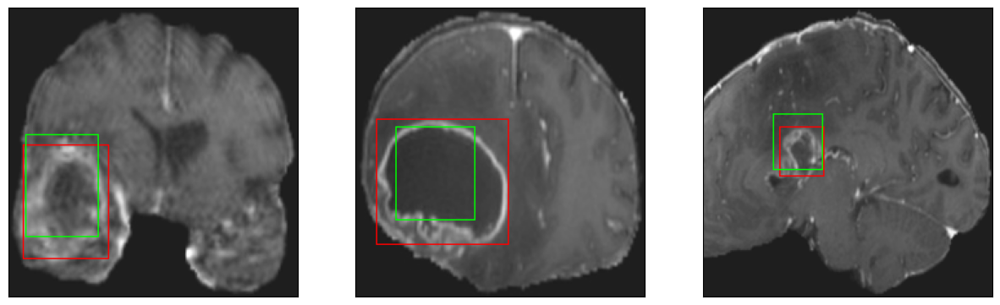

26/26 [==============================] - 4s 143ms/step - loss: 5.8561 - IoU: 0.5701 - val_loss: 8.2090 - val_IoU: 0.5408
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 5.9444 - IoU: 0.5564
Epoch 156: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


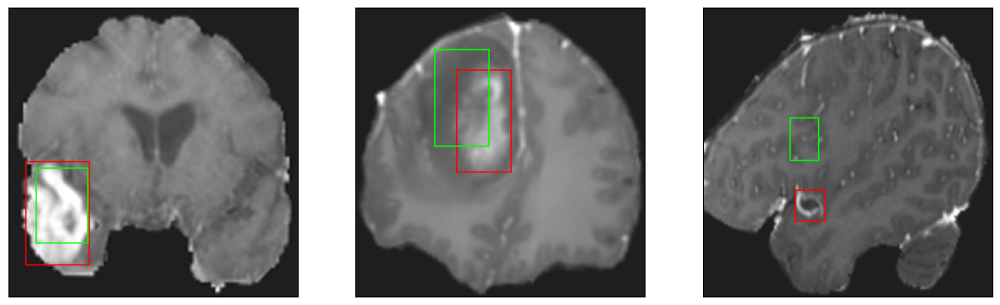

26/26 [==============================] - 3s 132ms/step - loss: 5.9444 - IoU: 0.5564 - val_loss: 8.8042 - val_IoU: 0.4892
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 6.0313 - IoU: 0.5462
Epoch 157: val_IoU did not improve from 0.54846
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


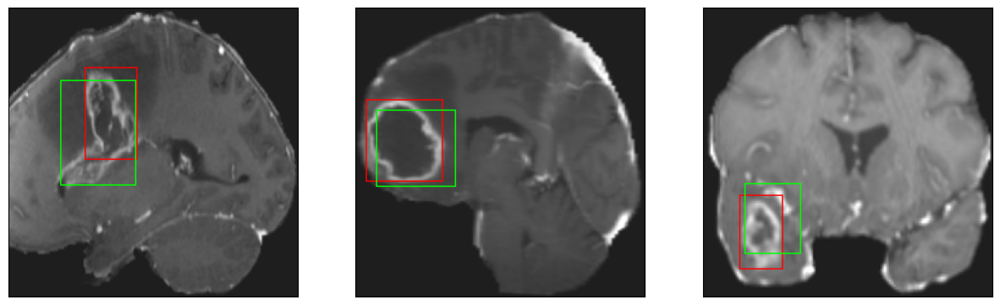

26/26 [==============================] - 3s 128ms/step - loss: 6.0313 - IoU: 0.5462 - val_loss: 8.6310 - val_IoU: 0.5312
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 5.8854 - IoU: 0.5685
Epoch 158: val_IoU improved from 0.54846 to 0.56031, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 20ms/step
4
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 16ms/step
4


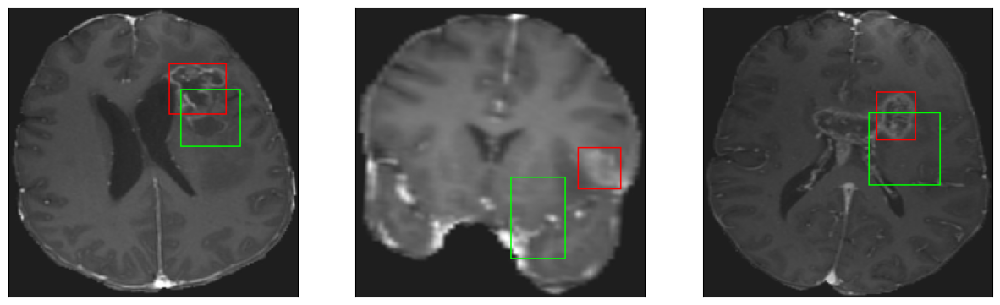

26/26 [==============================] - 9s 337ms/step - loss: 5.8854 - IoU: 0.5685 - val_loss: 8.4126 - val_IoU: 0.5603
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 5.8372 - IoU: 0.5613
Epoch 159: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


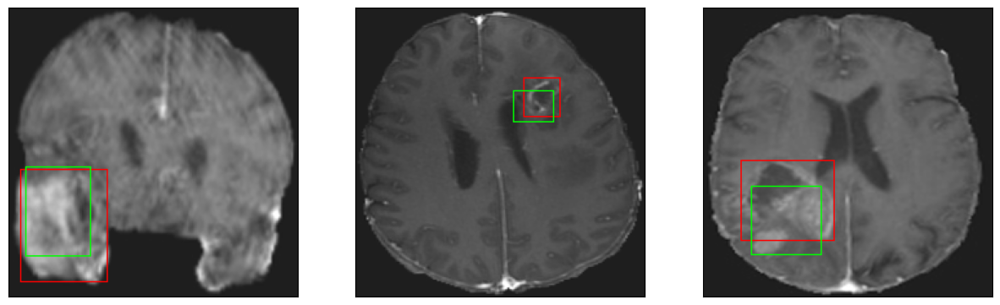

26/26 [==============================] - 3s 133ms/step - loss: 5.8372 - IoU: 0.5613 - val_loss: 8.9139 - val_IoU: 0.5216
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 6.0168 - IoU: 0.5620
Epoch 160: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


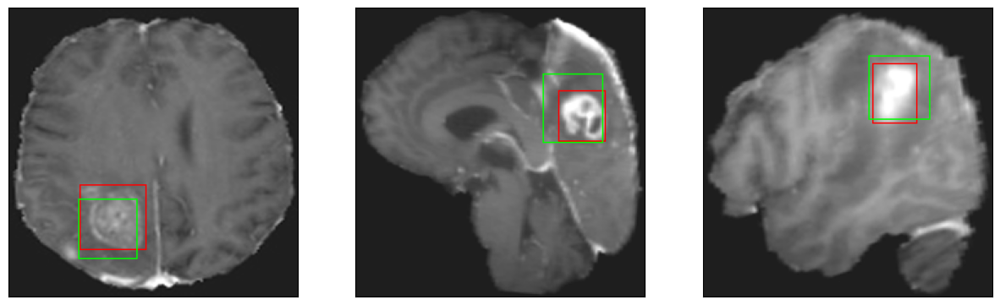

26/26 [==============================] - 5s 172ms/step - loss: 6.0168 - IoU: 0.5620 - val_loss: 8.4225 - val_IoU: 0.5276
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 5.9444 - IoU: 0.5497
Epoch 161: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4


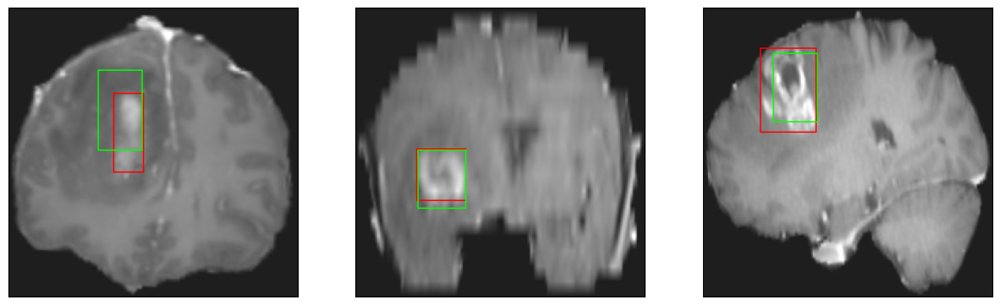

26/26 [==============================] - 4s 162ms/step - loss: 5.9444 - IoU: 0.5497 - val_loss: 9.0677 - val_IoU: 0.5021
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 5.9508 - IoU: 0.5548
Epoch 162: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4


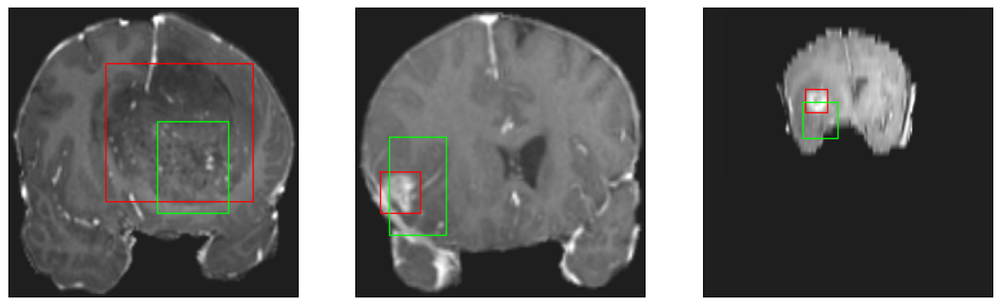

26/26 [==============================] - 3s 126ms/step - loss: 5.9508 - IoU: 0.5548 - val_loss: 10.8991 - val_IoU: 0.4871
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 5.9892 - IoU: 0.5655
Epoch 163: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


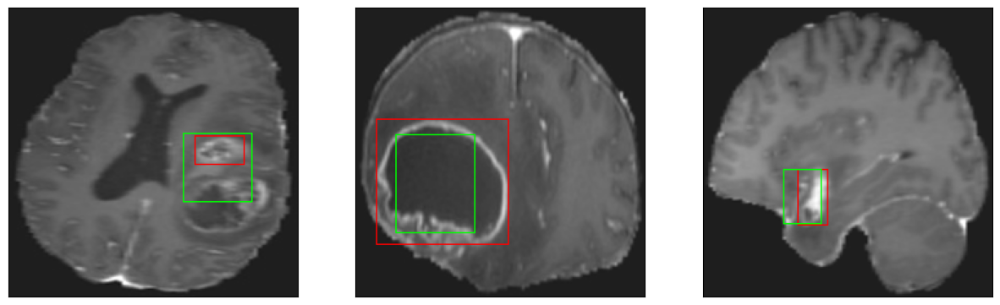

26/26 [==============================] - 3s 124ms/step - loss: 5.9892 - IoU: 0.5655 - val_loss: 9.4687 - val_IoU: 0.5023
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 5.6692 - IoU: 0.5717
Epoch 164: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


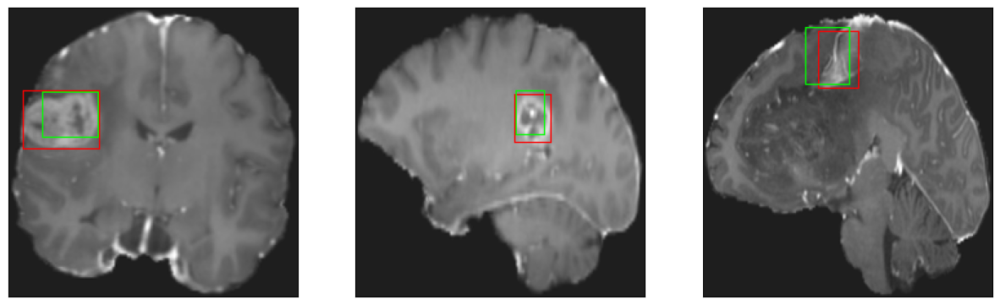

26/26 [==============================] - 3s 133ms/step - loss: 5.6692 - IoU: 0.5717 - val_loss: 9.5018 - val_IoU: 0.4807
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 5.9834 - IoU: 0.5455
Epoch 165: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 16ms/step
4


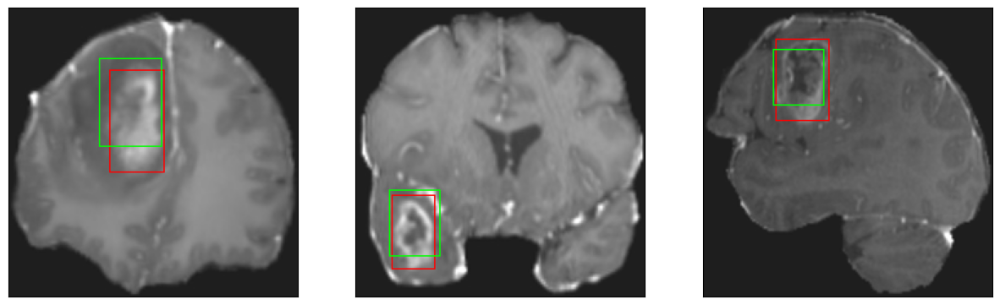

26/26 [==============================] - 4s 137ms/step - loss: 5.9834 - IoU: 0.5455 - val_loss: 9.6203 - val_IoU: 0.5018
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 5.8651 - IoU: 0.5598
Epoch 166: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


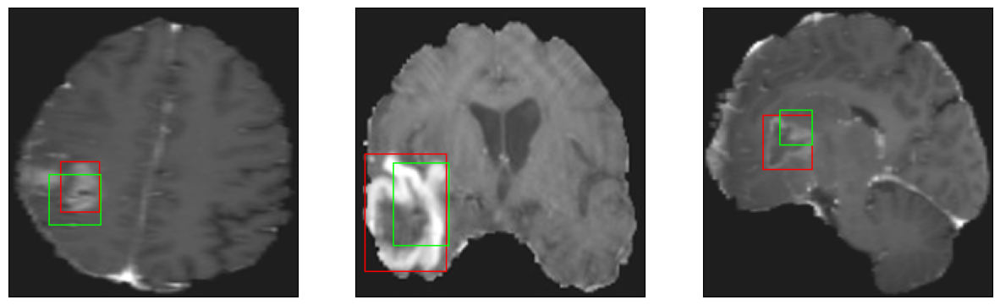

26/26 [==============================] - 3s 126ms/step - loss: 5.8651 - IoU: 0.5598 - val_loss: 8.9024 - val_IoU: 0.5032
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 5.5738 - IoU: 0.5733
Epoch 167: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 14ms/step
4


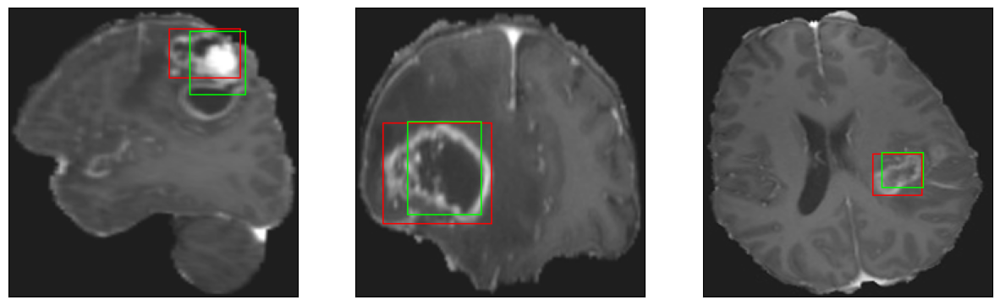

26/26 [==============================] - 3s 127ms/step - loss: 5.5738 - IoU: 0.5733 - val_loss: 8.8455 - val_IoU: 0.4964
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 5.8736 - IoU: 0.5608
Epoch 168: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4


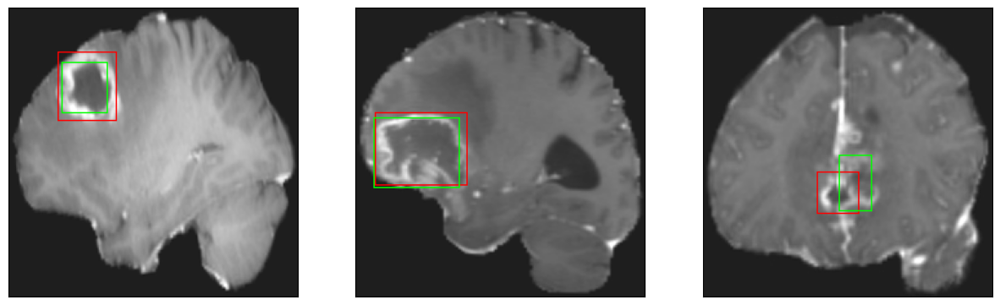

26/26 [==============================] - 3s 135ms/step - loss: 5.8736 - IoU: 0.5608 - val_loss: 9.6519 - val_IoU: 0.4606
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 5.9040 - IoU: 0.5612
Epoch 169: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


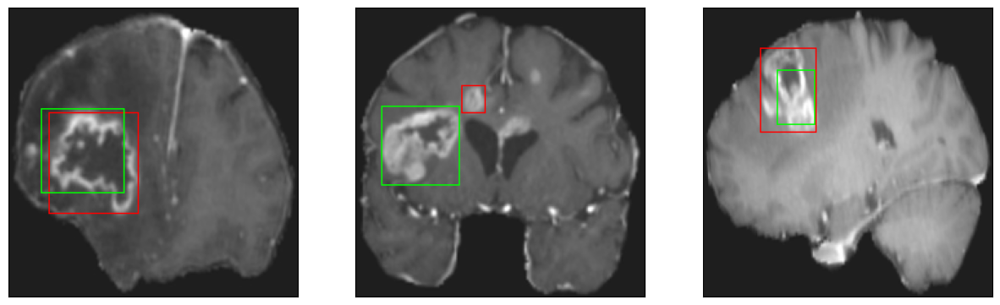

26/26 [==============================] - 3s 130ms/step - loss: 5.9040 - IoU: 0.5612 - val_loss: 8.5102 - val_IoU: 0.5174
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 5.5642 - IoU: 0.5784
Epoch 170: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


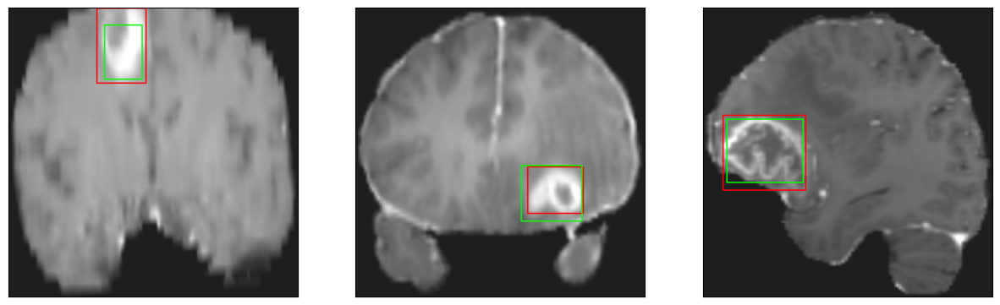

26/26 [==============================] - 3s 126ms/step - loss: 5.5642 - IoU: 0.5784 - val_loss: 8.0210 - val_IoU: 0.5429
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 5.7342 - IoU: 0.5691
Epoch 171: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 12ms/step
4


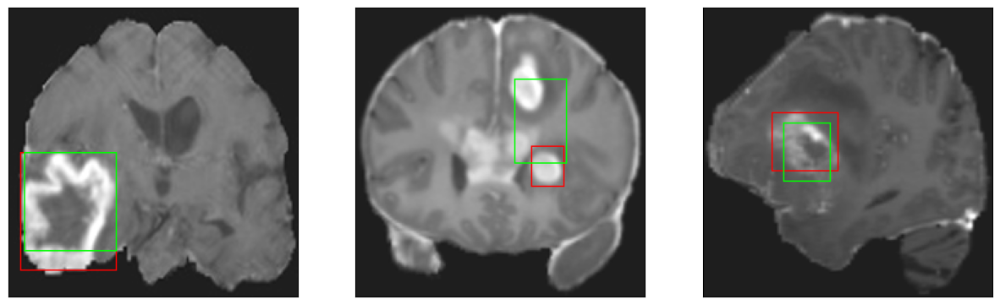

26/26 [==============================] - 4s 142ms/step - loss: 5.7342 - IoU: 0.5691 - val_loss: 8.0778 - val_IoU: 0.5591
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 5.6198 - IoU: 0.5750
Epoch 172: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


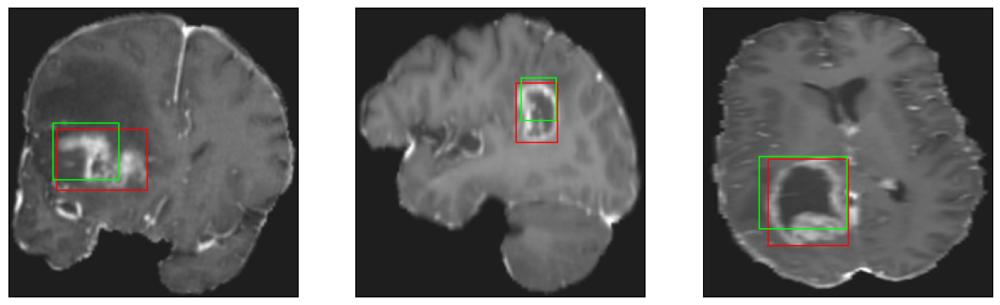

26/26 [==============================] - 4s 135ms/step - loss: 5.6198 - IoU: 0.5750 - val_loss: 9.5812 - val_IoU: 0.4593
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 5.8916 - IoU: 0.5581
Epoch 173: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


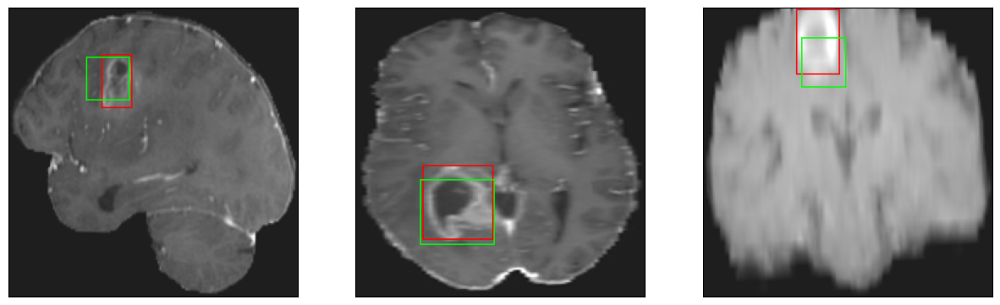

26/26 [==============================] - 3s 124ms/step - loss: 5.8916 - IoU: 0.5581 - val_loss: 8.3085 - val_IoU: 0.5418
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 6.1167 - IoU: 0.5434
Epoch 174: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


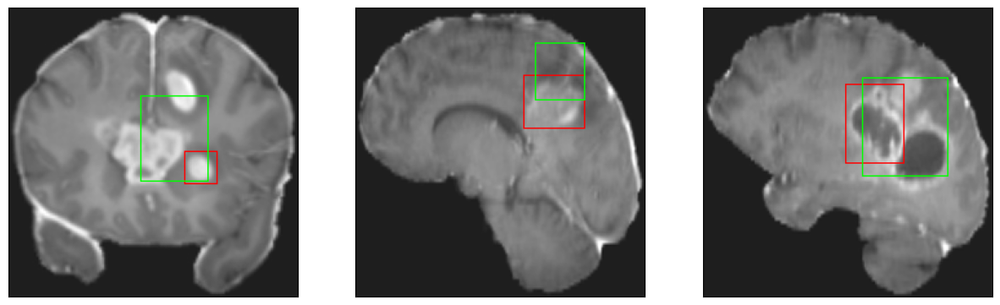

26/26 [==============================] - 3s 129ms/step - loss: 6.1167 - IoU: 0.5434 - val_loss: 8.9150 - val_IoU: 0.4971
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 5.8774 - IoU: 0.5659
Epoch 175: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


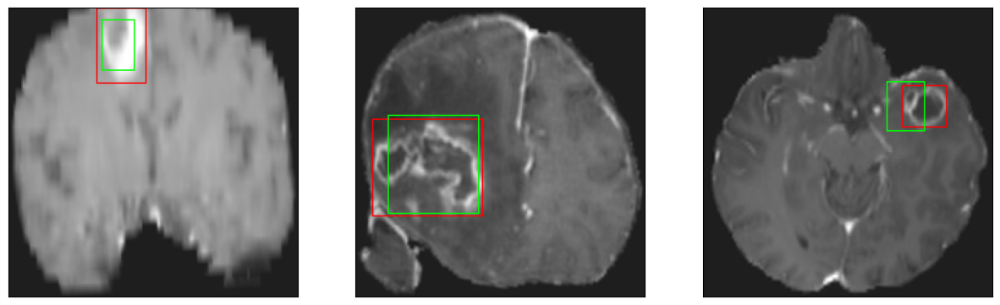

26/26 [==============================] - 4s 139ms/step - loss: 5.8774 - IoU: 0.5659 - val_loss: 9.6526 - val_IoU: 0.4761
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 5.6610 - IoU: 0.5717
Epoch 176: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


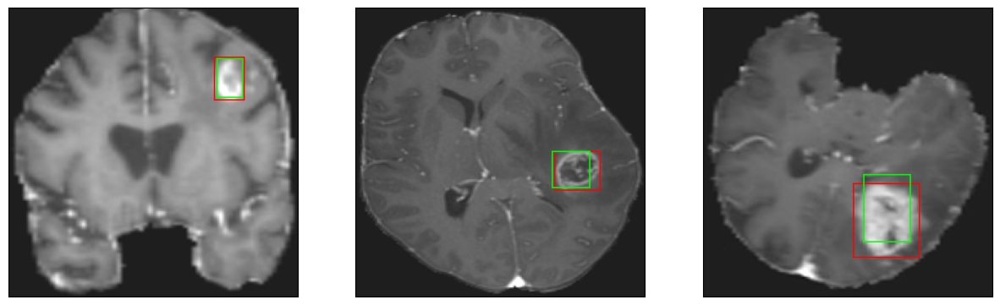

26/26 [==============================] - 3s 129ms/step - loss: 5.6610 - IoU: 0.5717 - val_loss: 9.2730 - val_IoU: 0.4983
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 5.7552 - IoU: 0.5661
Epoch 177: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


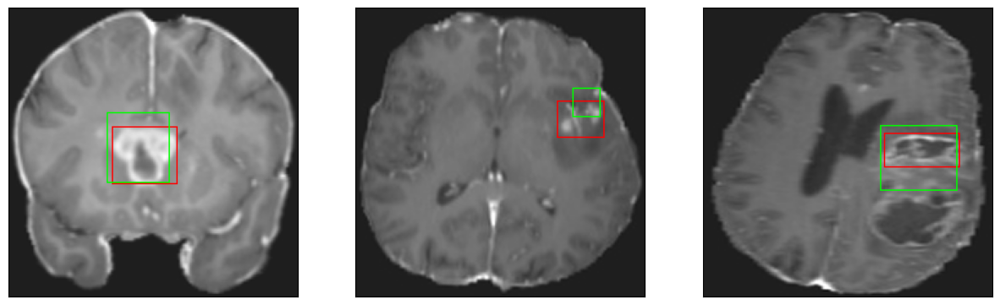

26/26 [==============================] - 3s 130ms/step - loss: 5.7552 - IoU: 0.5661 - val_loss: 15.6955 - val_IoU: 0.4896
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 5.8250 - IoU: 0.5607
Epoch 178: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


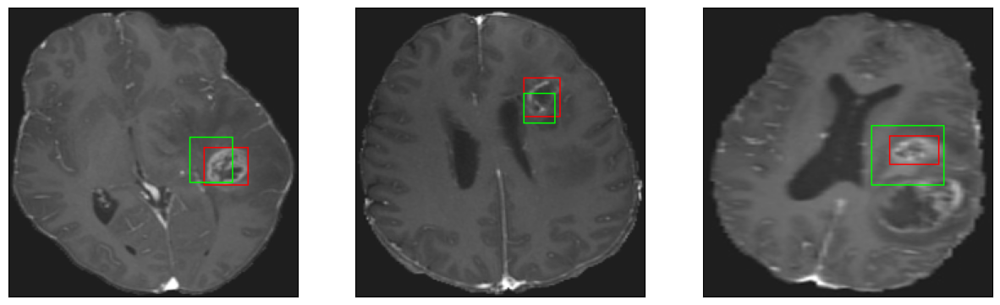

26/26 [==============================] - 4s 150ms/step - loss: 5.8250 - IoU: 0.5607 - val_loss: 9.6070 - val_IoU: 0.4545
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 5.6400 - IoU: 0.5720
Epoch 179: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


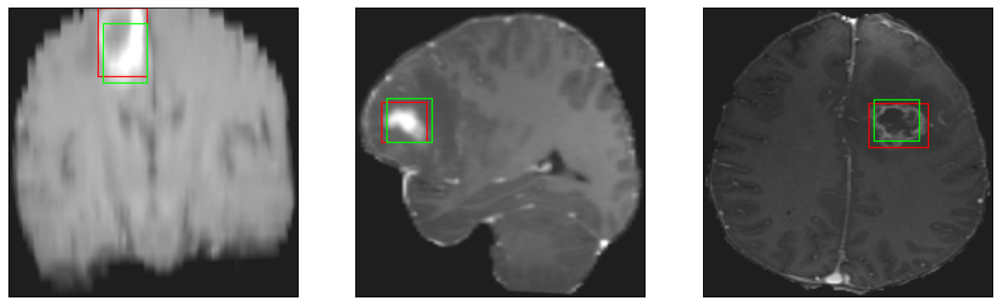

26/26 [==============================] - 4s 148ms/step - loss: 5.6400 - IoU: 0.5720 - val_loss: 8.6133 - val_IoU: 0.5334
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 5.8188 - IoU: 0.5623
Epoch 180: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


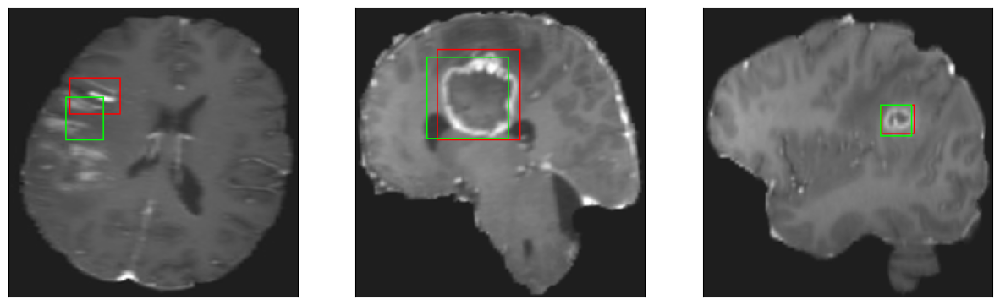

26/26 [==============================] - 3s 129ms/step - loss: 5.8188 - IoU: 0.5623 - val_loss: 9.1767 - val_IoU: 0.4867
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 5.4945 - IoU: 0.5863
Epoch 181: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


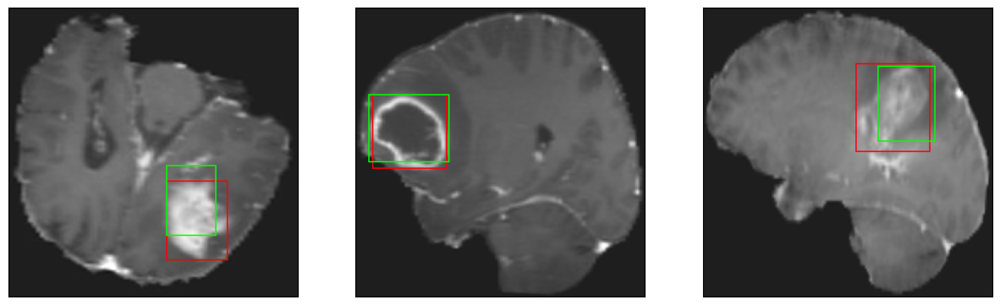

26/26 [==============================] - 4s 145ms/step - loss: 5.4945 - IoU: 0.5863 - val_loss: 8.8347 - val_IoU: 0.5256
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 5.6719 - IoU: 0.5710
Epoch 182: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


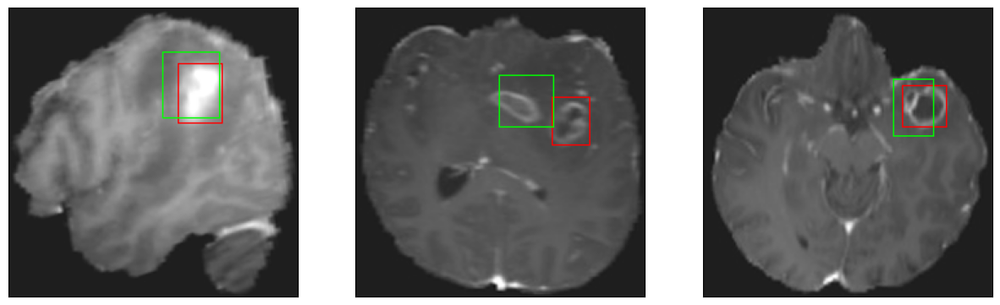

26/26 [==============================] - 3s 129ms/step - loss: 5.6719 - IoU: 0.5710 - val_loss: 8.8438 - val_IoU: 0.5161
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 5.4366 - IoU: 0.5834
Epoch 183: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


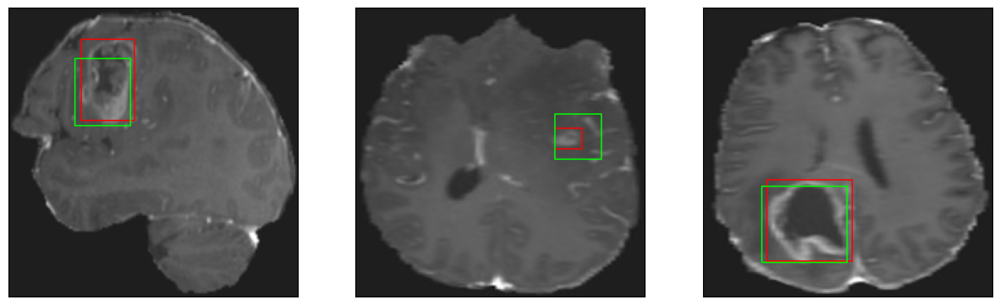

26/26 [==============================] - 4s 136ms/step - loss: 5.4366 - IoU: 0.5834 - val_loss: 9.3555 - val_IoU: 0.5396
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 5.7398 - IoU: 0.5753
Epoch 184: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


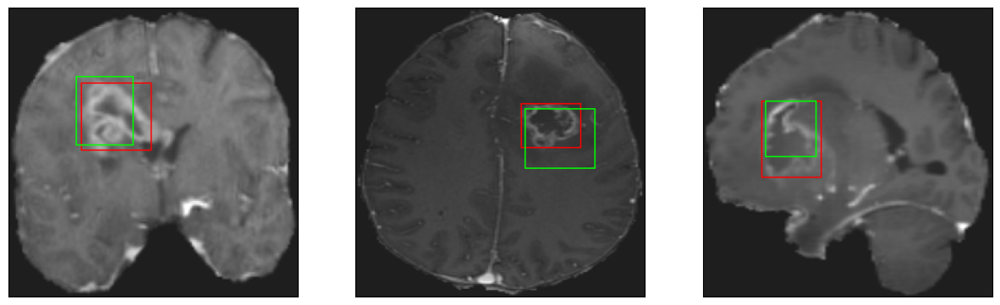

26/26 [==============================] - 3s 131ms/step - loss: 5.7398 - IoU: 0.5753 - val_loss: 8.3977 - val_IoU: 0.5374
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 5.7103 - IoU: 0.5707
Epoch 185: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4


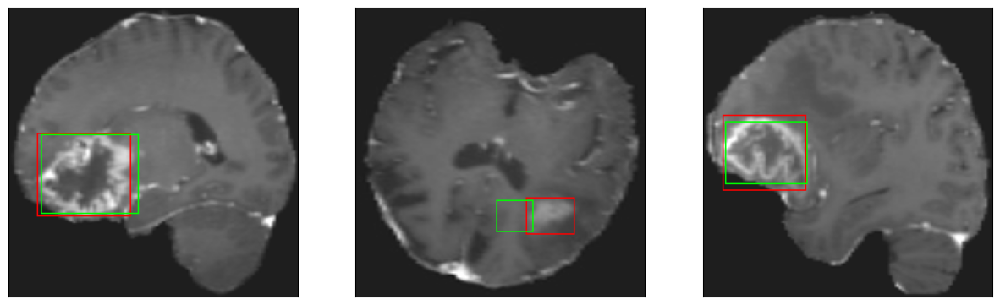

26/26 [==============================] - 4s 137ms/step - loss: 5.7103 - IoU: 0.5707 - val_loss: 9.2416 - val_IoU: 0.5113
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 5.8562 - IoU: 0.5728
Epoch 186: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4


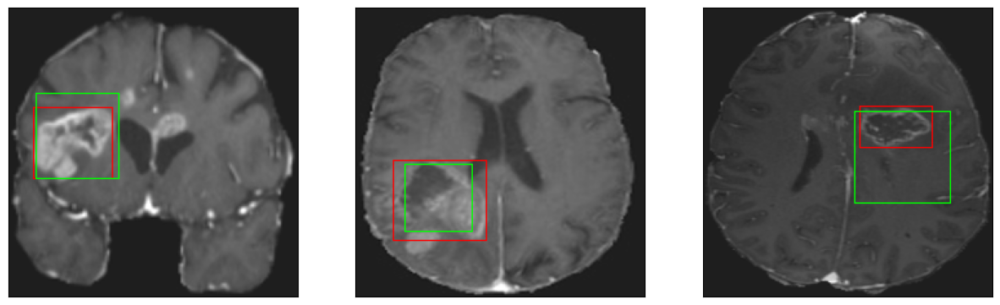

26/26 [==============================] - 4s 138ms/step - loss: 5.8562 - IoU: 0.5728 - val_loss: 8.9664 - val_IoU: 0.5094
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 5.6322 - IoU: 0.5762
Epoch 187: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


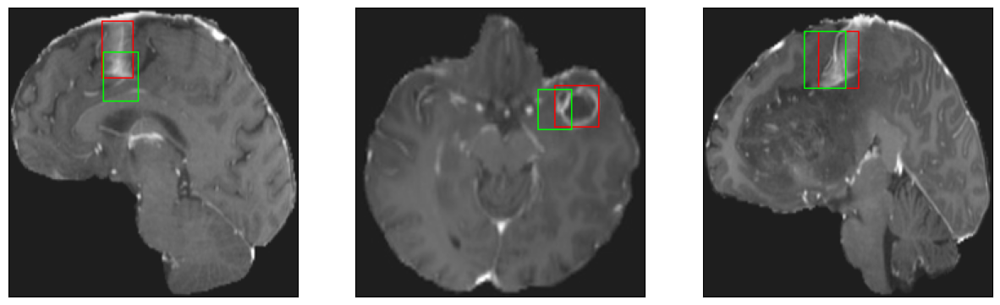

26/26 [==============================] - 3s 126ms/step - loss: 5.6322 - IoU: 0.5762 - val_loss: 9.0800 - val_IoU: 0.4845
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 5.4546 - IoU: 0.5820
Epoch 188: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


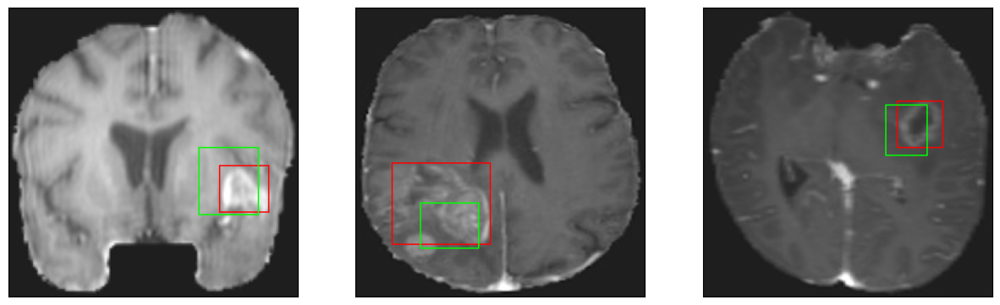

26/26 [==============================] - 3s 130ms/step - loss: 5.4546 - IoU: 0.5820 - val_loss: 25.7551 - val_IoU: 0.5479
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 5.9063 - IoU: 0.5631
Epoch 189: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4


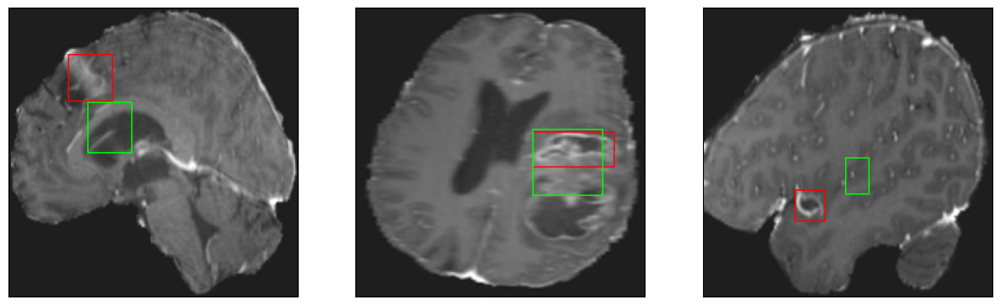

26/26 [==============================] - 4s 148ms/step - loss: 5.9063 - IoU: 0.5631 - val_loss: 30.9110 - val_IoU: 0.5361
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 5.6415 - IoU: 0.5754
Epoch 190: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


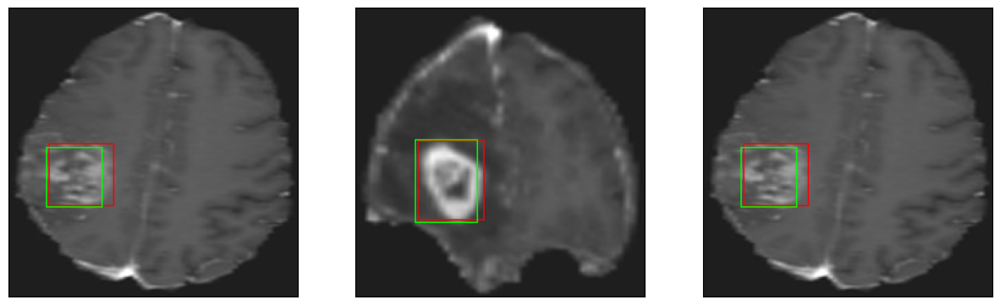

26/26 [==============================] - 3s 128ms/step - loss: 5.6415 - IoU: 0.5754 - val_loss: 16.7172 - val_IoU: 0.5281
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 5.6199 - IoU: 0.5802
Epoch 191: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


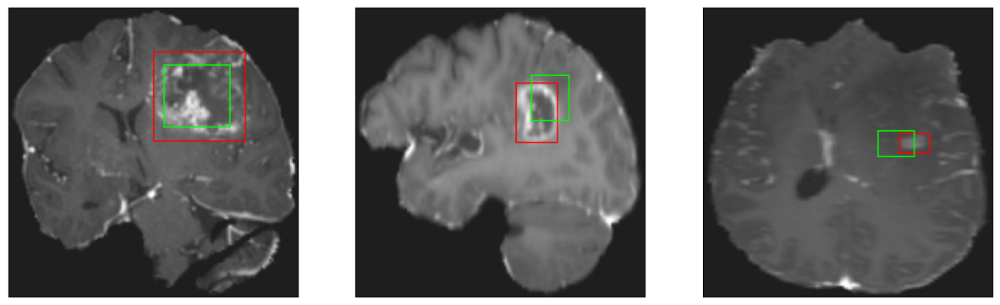

26/26 [==============================] - 3s 132ms/step - loss: 5.6199 - IoU: 0.5802 - val_loss: 12.3069 - val_IoU: 0.5061
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 5.8137 - IoU: 0.5590
Epoch 192: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


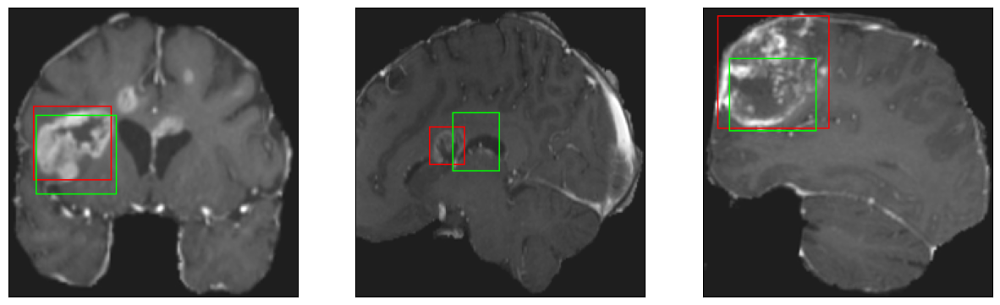

26/26 [==============================] - 4s 142ms/step - loss: 5.8137 - IoU: 0.5590 - val_loss: 32.3325 - val_IoU: 0.5081
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 5.4581 - IoU: 0.5797
Epoch 193: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


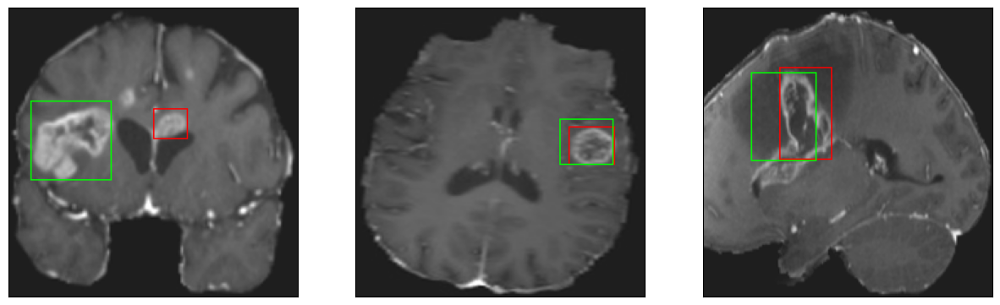

26/26 [==============================] - 3s 131ms/step - loss: 5.4581 - IoU: 0.5797 - val_loss: 9.0906 - val_IoU: 0.5177
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 5.6261 - IoU: 0.5678
Epoch 194: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


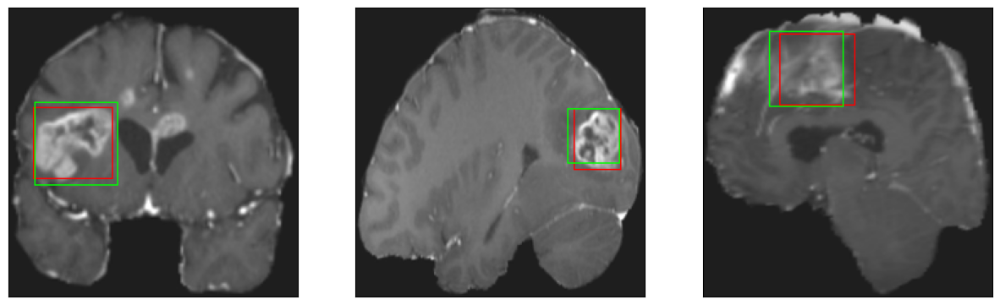

26/26 [==============================] - 4s 146ms/step - loss: 5.6261 - IoU: 0.5678 - val_loss: 8.8085 - val_IoU: 0.5317
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 5.6395 - IoU: 0.5702
Epoch 195: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 13ms/step
4


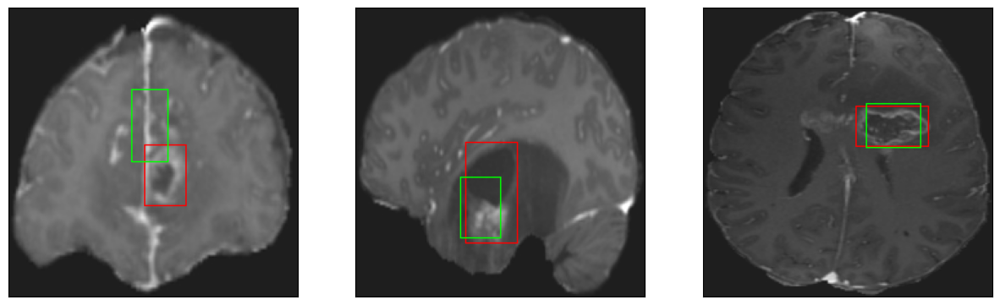

26/26 [==============================] - 4s 143ms/step - loss: 5.6395 - IoU: 0.5702 - val_loss: 8.8755 - val_IoU: 0.5415
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 6.0861 - IoU: 0.5613
Epoch 196: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 15ms/step
4


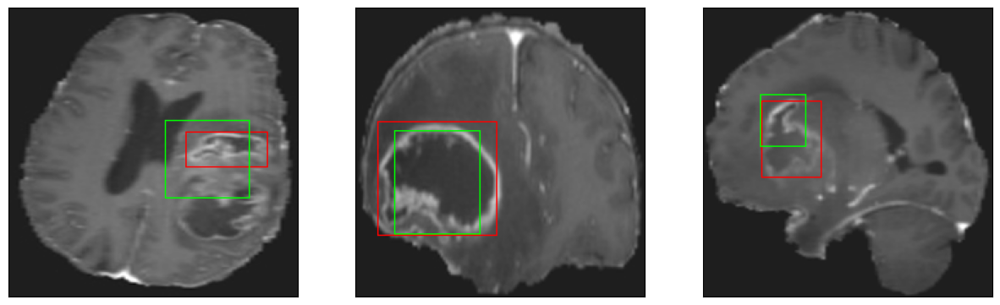

26/26 [==============================] - 4s 151ms/step - loss: 6.0861 - IoU: 0.5613 - val_loss: 8.6824 - val_IoU: 0.5281
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 5.4712 - IoU: 0.5751
Epoch 197: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


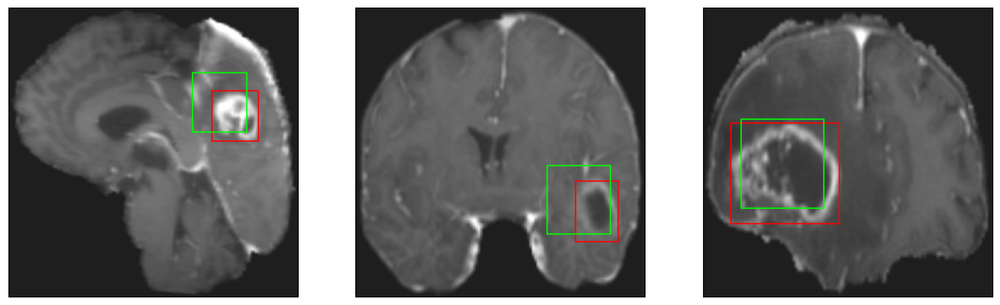

26/26 [==============================] - 4s 135ms/step - loss: 5.4712 - IoU: 0.5751 - val_loss: 9.5241 - val_IoU: 0.4733
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 5.7253 - IoU: 0.5685
Epoch 198: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


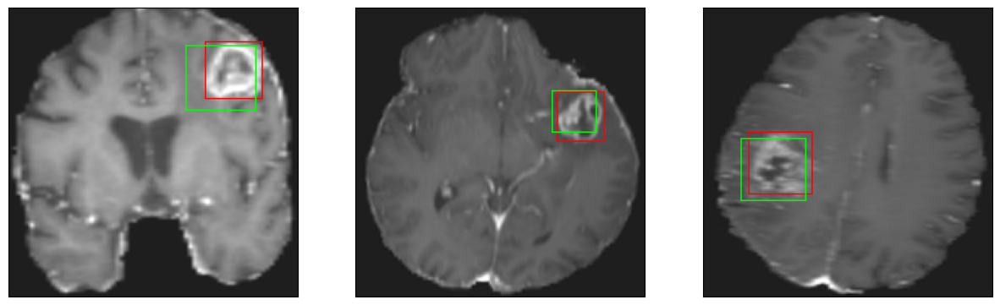

26/26 [==============================] - 3s 131ms/step - loss: 5.7253 - IoU: 0.5685 - val_loss: 9.1081 - val_IoU: 0.5283
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 5.4509 - IoU: 0.5850
Epoch 199: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4


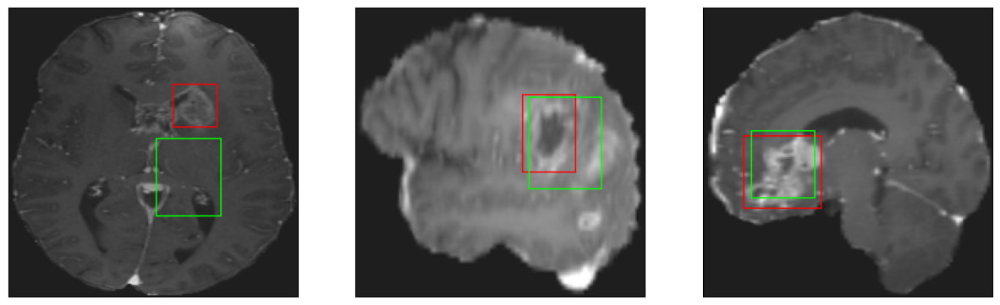

26/26 [==============================] - 4s 146ms/step - loss: 5.4509 - IoU: 0.5850 - val_loss: 8.7787 - val_IoU: 0.5382
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 5.4901 - IoU: 0.5832
Epoch 200: val_IoU did not improve from 0.56031
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


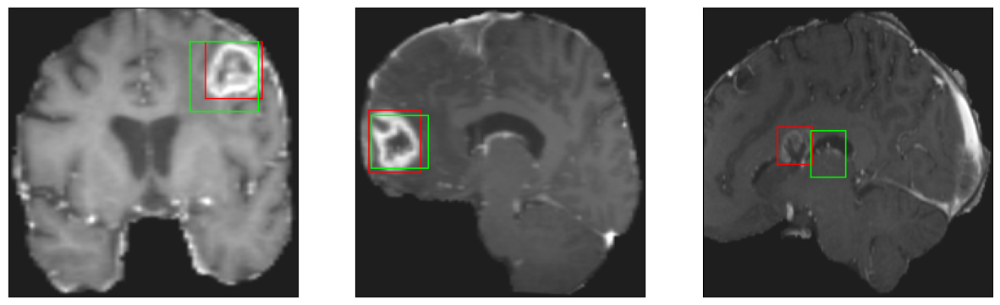

26/26 [==============================] - 4s 142ms/step - loss: 5.4901 - IoU: 0.5832 - val_loss: 9.2283 - val_IoU: 0.5163


In [24]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

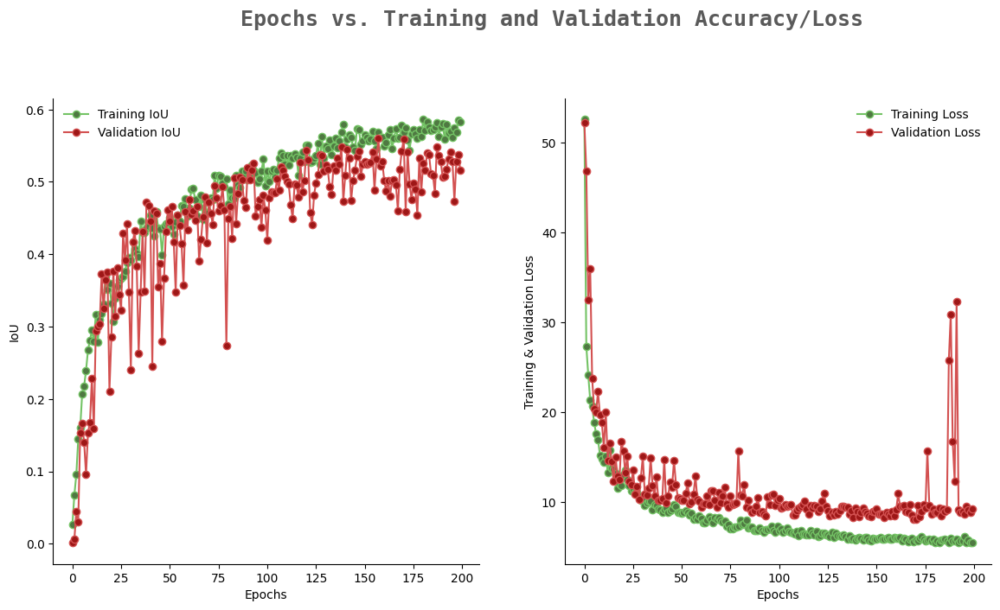

In [25]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [26]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [27]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [28]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 36ms/step - loss: 9.5751 - IoU: 0.5107


[9.575102806091309, 0.5106530785560608]